<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [2]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [3]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [4]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [5]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


FileNotFoundError: ignored

In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 42.3342 - IoU: 0.0450
Epoch 1: val_loss improved from inf to 117.05569, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 101ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


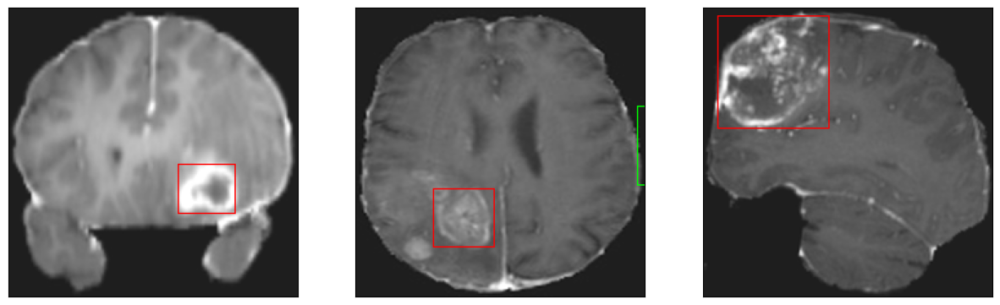

26/26 [==============================] - 45s 910ms/step - loss: 42.3342 - IoU: 0.0450 - val_loss: 117.0557 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 26.2075 - IoU: 0.0706
Epoch 2: val_loss did not improve from 117.05569
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4


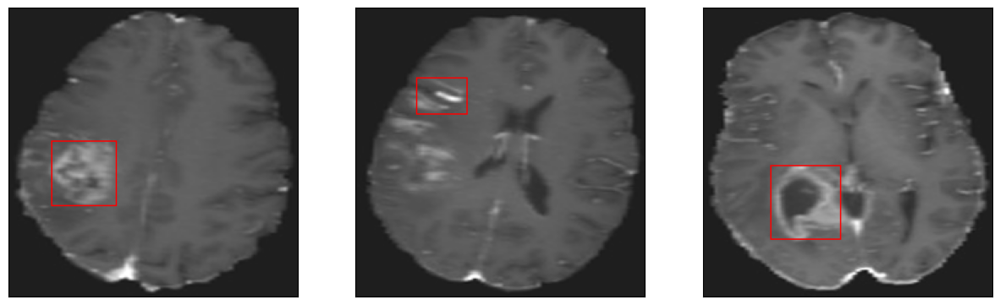

26/26 [==============================] - 7s 285ms/step - loss: 26.2075 - IoU: 0.0706 - val_loss: 201.3982 - val_IoU: 0.0000e+00
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 25.3041 - IoU: 0.0856
Epoch 3: val_loss did not improve from 117.05569
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


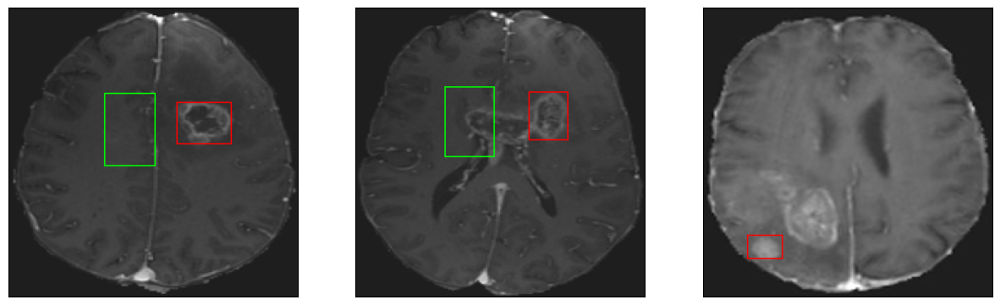

26/26 [==============================] - 7s 290ms/step - loss: 25.3041 - IoU: 0.0856 - val_loss: 186.7287 - val_IoU: 7.8875e-04
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 23.5014 - IoU: 0.1033
Epoch 4: val_loss improved from 117.05569 to 41.38311, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


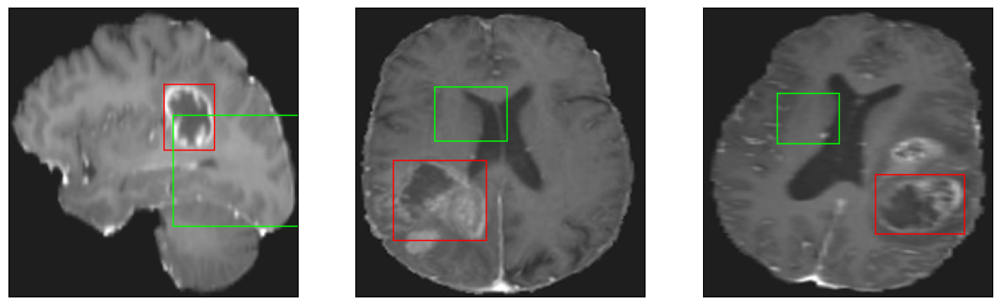

26/26 [==============================] - 14s 545ms/step - loss: 23.5014 - IoU: 0.1033 - val_loss: 41.3831 - val_IoU: 0.0581
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 22.2294 - IoU: 0.1387
Epoch 5: val_loss did not improve from 41.38311
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


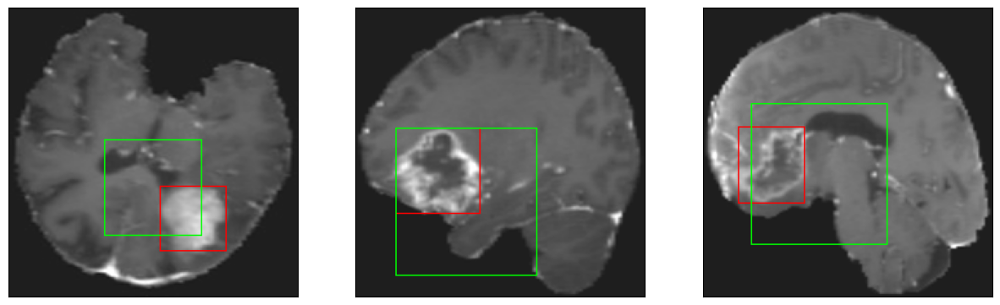

26/26 [==============================] - 7s 287ms/step - loss: 22.2294 - IoU: 0.1387 - val_loss: 59.3555 - val_IoU: 0.0914
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 19.4462 - IoU: 0.1926
Epoch 6: val_loss improved from 41.38311 to 30.36938, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


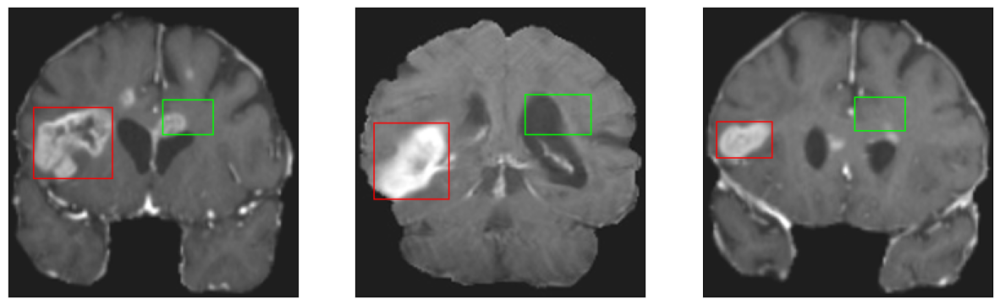

26/26 [==============================] - 14s 546ms/step - loss: 19.4462 - IoU: 0.1926 - val_loss: 30.3694 - val_IoU: 0.0546
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 16.9185 - IoU: 0.2353
Epoch 7: val_loss improved from 30.36938 to 19.77732, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


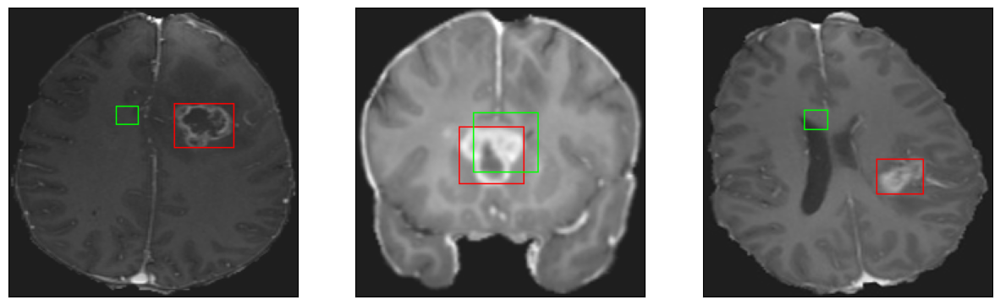

26/26 [==============================] - 14s 535ms/step - loss: 16.9185 - IoU: 0.2353 - val_loss: 19.7773 - val_IoU: 0.1920
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 16.8364 - IoU: 0.2291
Epoch 8: val_loss did not improve from 19.77732
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


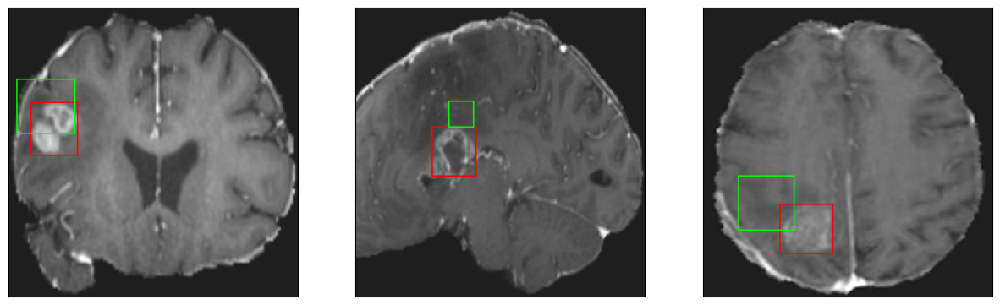

26/26 [==============================] - 7s 275ms/step - loss: 16.8364 - IoU: 0.2291 - val_loss: 24.2692 - val_IoU: 0.1845
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 14.3333 - IoU: 0.3048
Epoch 9: val_loss did not improve from 19.77732
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


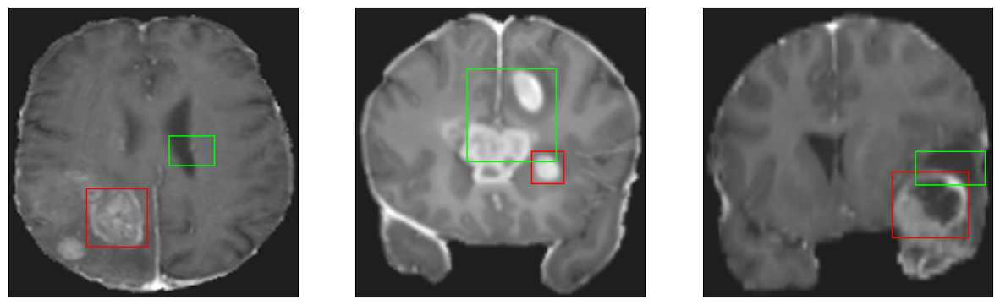

26/26 [==============================] - 7s 286ms/step - loss: 14.3333 - IoU: 0.3048 - val_loss: 20.4160 - val_IoU: 0.1943
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 13.4452 - IoU: 0.3260
Epoch 10: val_loss improved from 19.77732 to 16.00848, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


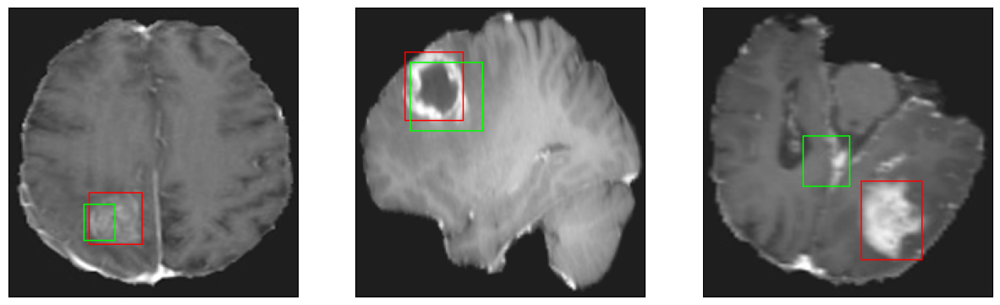

26/26 [==============================] - 14s 541ms/step - loss: 13.4452 - IoU: 0.3260 - val_loss: 16.0085 - val_IoU: 0.2643
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 14.7075 - IoU: 0.2794
Epoch 11: val_loss improved from 16.00848 to 14.99555, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


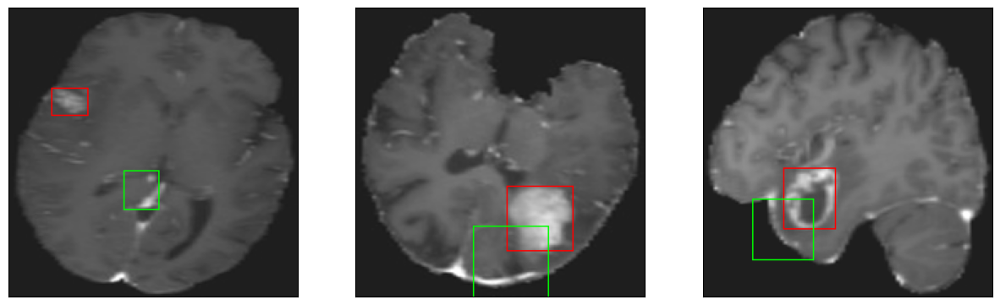

26/26 [==============================] - 14s 546ms/step - loss: 14.7075 - IoU: 0.2794 - val_loss: 14.9956 - val_IoU: 0.2701
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 12.9893 - IoU: 0.3277
Epoch 12: val_loss improved from 14.99555 to 13.96376, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


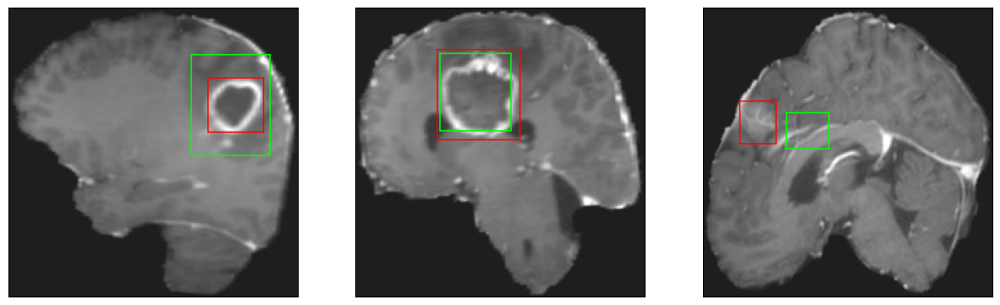

26/26 [==============================] - 13s 523ms/step - loss: 12.9893 - IoU: 0.3277 - val_loss: 13.9638 - val_IoU: 0.3071
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 11.9830 - IoU: 0.3533
Epoch 13: val_loss improved from 13.96376 to 13.48198, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


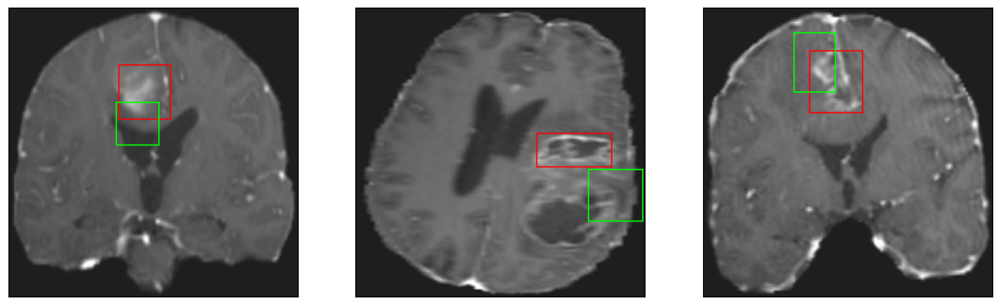

26/26 [==============================] - 13s 523ms/step - loss: 11.9830 - IoU: 0.3533 - val_loss: 13.4820 - val_IoU: 0.3128
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 11.9610 - IoU: 0.3433
Epoch 14: val_loss did not improve from 13.48198
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


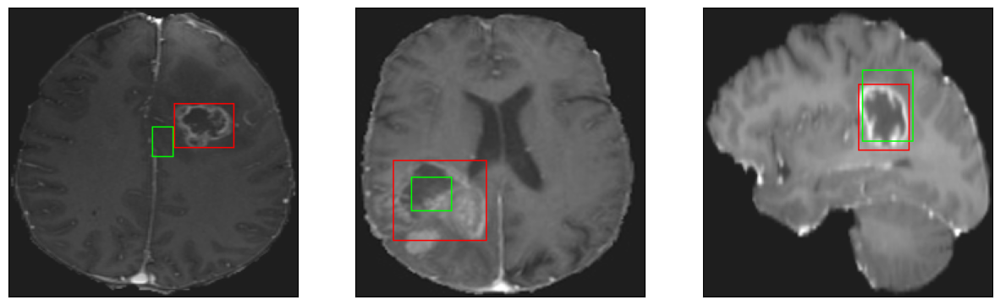

26/26 [==============================] - 8s 313ms/step - loss: 11.9610 - IoU: 0.3433 - val_loss: 15.0623 - val_IoU: 0.2808
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 11.2204 - IoU: 0.3781
Epoch 15: val_loss improved from 13.48198 to 12.70364, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


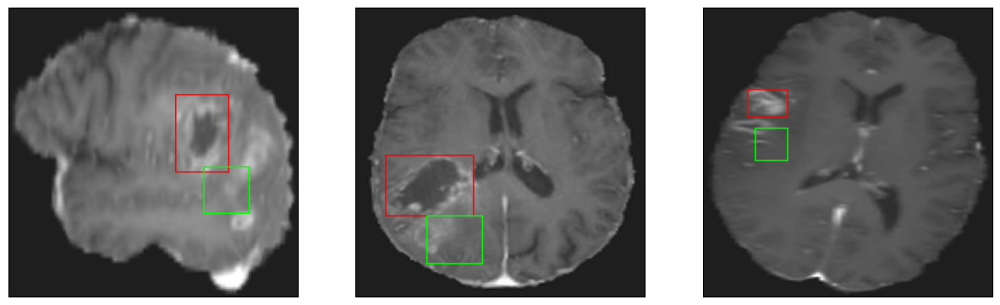

26/26 [==============================] - 14s 551ms/step - loss: 11.2204 - IoU: 0.3781 - val_loss: 12.7036 - val_IoU: 0.3849
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 11.5366 - IoU: 0.3485
Epoch 16: val_loss improved from 12.70364 to 11.84181, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


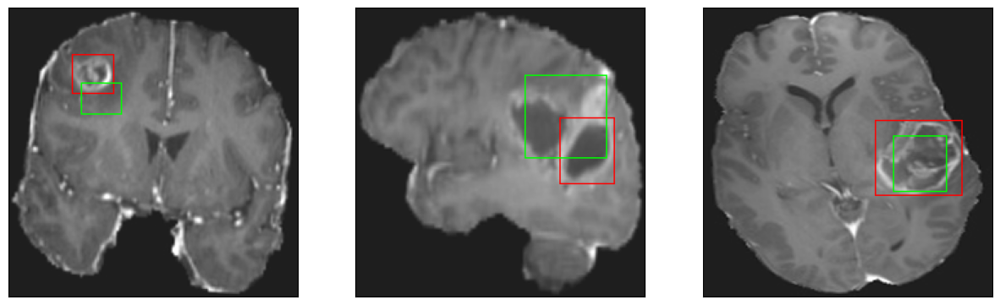

26/26 [==============================] - 14s 543ms/step - loss: 11.5366 - IoU: 0.3485 - val_loss: 11.8418 - val_IoU: 0.3925
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 11.1711 - IoU: 0.3748
Epoch 17: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


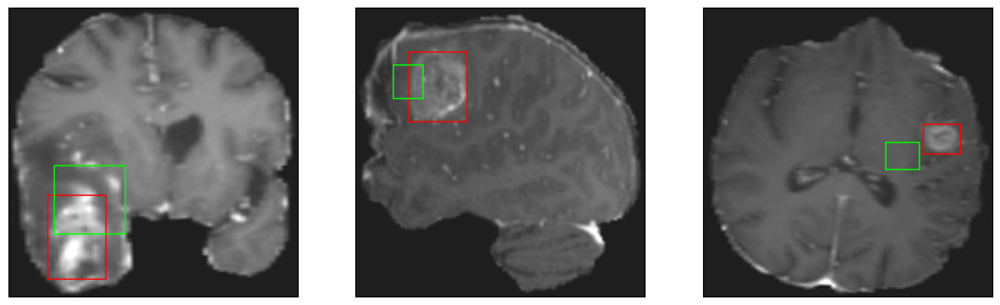

26/26 [==============================] - 7s 281ms/step - loss: 11.1711 - IoU: 0.3748 - val_loss: 13.5556 - val_IoU: 0.3215
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 11.8025 - IoU: 0.3507
Epoch 18: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


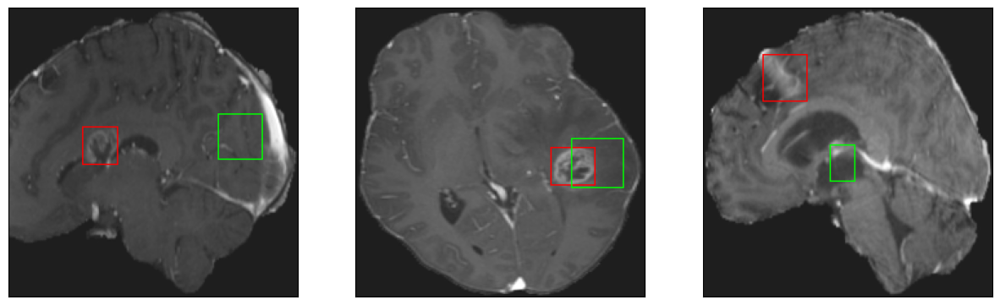

26/26 [==============================] - 8s 301ms/step - loss: 11.8025 - IoU: 0.3507 - val_loss: 14.5598 - val_IoU: 0.2436
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 11.2365 - IoU: 0.3699
Epoch 19: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


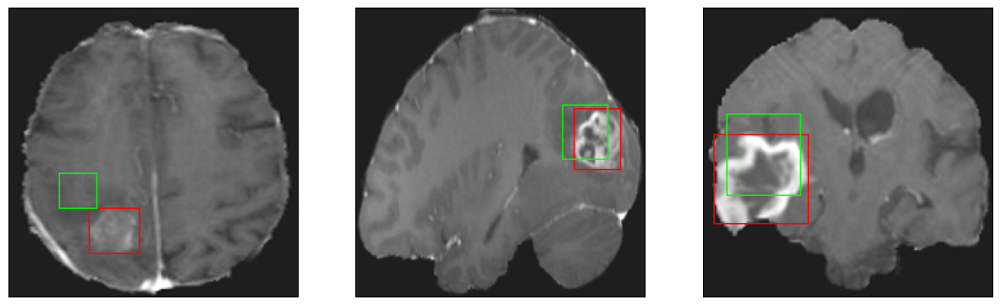

26/26 [==============================] - 7s 284ms/step - loss: 11.2365 - IoU: 0.3699 - val_loss: 12.7119 - val_IoU: 0.3462
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 10.6995 - IoU: 0.3820
Epoch 20: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


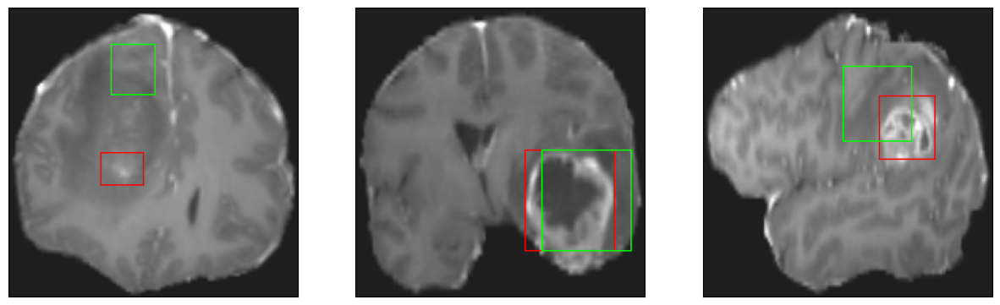

26/26 [==============================] - 7s 268ms/step - loss: 10.6995 - IoU: 0.3820 - val_loss: 13.1243 - val_IoU: 0.4082
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 10.5144 - IoU: 0.3863
Epoch 21: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


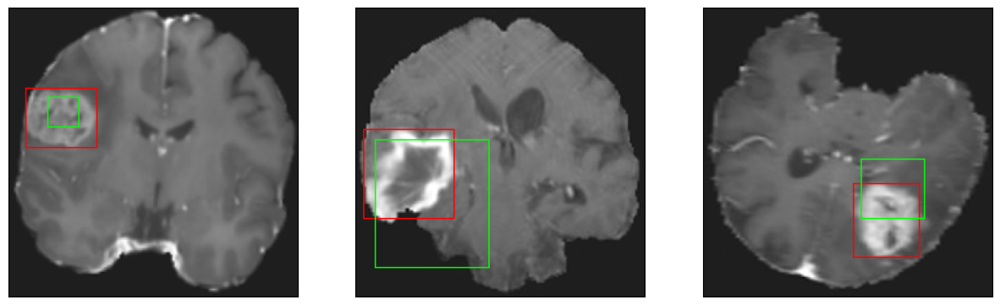

26/26 [==============================] - 7s 281ms/step - loss: 10.5144 - IoU: 0.3863 - val_loss: 11.8743 - val_IoU: 0.3768
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 10.6706 - IoU: 0.3947
Epoch 22: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


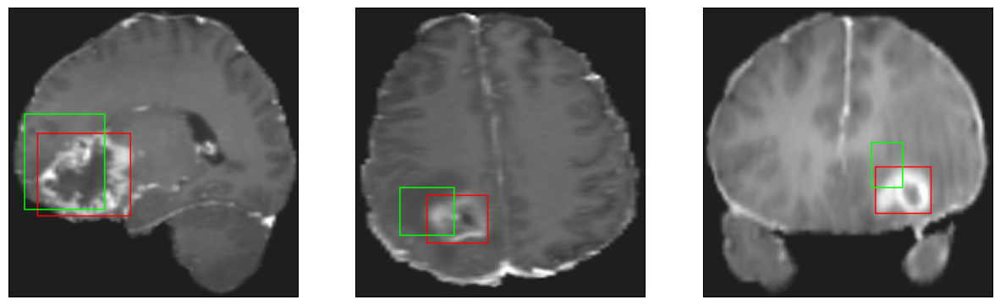

26/26 [==============================] - 8s 299ms/step - loss: 10.6706 - IoU: 0.3947 - val_loss: 12.5629 - val_IoU: 0.3343
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 9.7303 - IoU: 0.4223
Epoch 23: val_loss did not improve from 11.84181
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


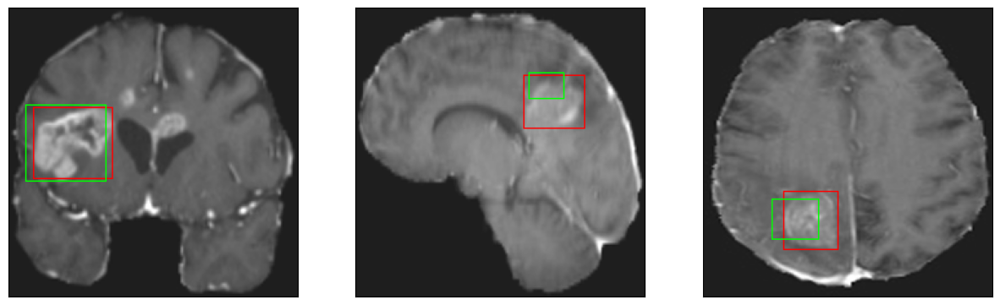

26/26 [==============================] - 7s 259ms/step - loss: 9.7303 - IoU: 0.4223 - val_loss: 13.0992 - val_IoU: 0.3232
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 10.1641 - IoU: 0.3978
Epoch 24: val_loss improved from 11.84181 to 11.22269, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


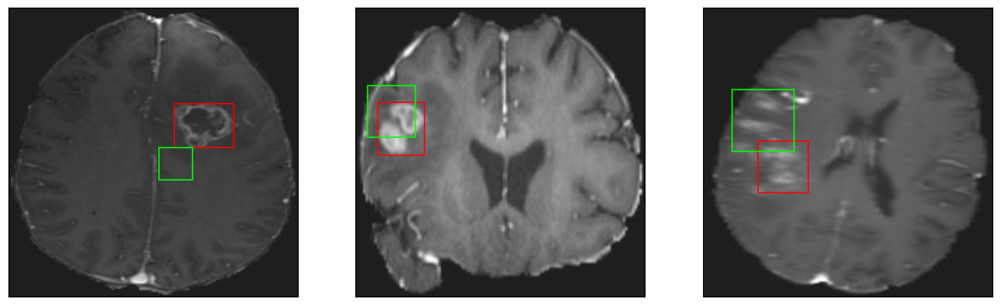

26/26 [==============================] - 13s 521ms/step - loss: 10.1641 - IoU: 0.3978 - val_loss: 11.2227 - val_IoU: 0.3886
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.0320 - IoU: 0.3979
Epoch 25: val_loss did not improve from 11.22269
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


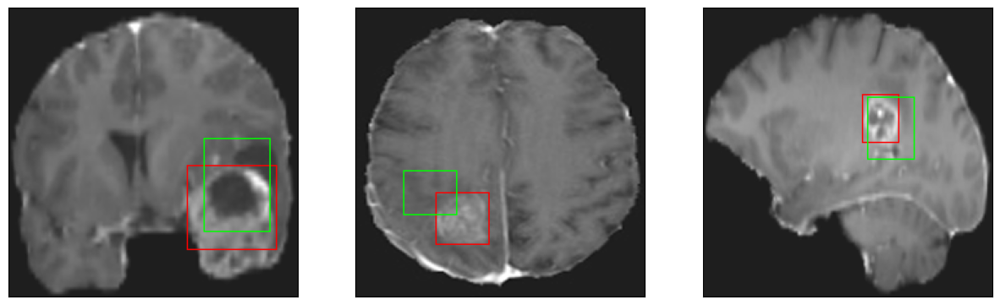

26/26 [==============================] - 8s 301ms/step - loss: 10.0320 - IoU: 0.3979 - val_loss: 12.3219 - val_IoU: 0.3745
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 9.9413 - IoU: 0.4048
Epoch 26: val_loss did not improve from 11.22269
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


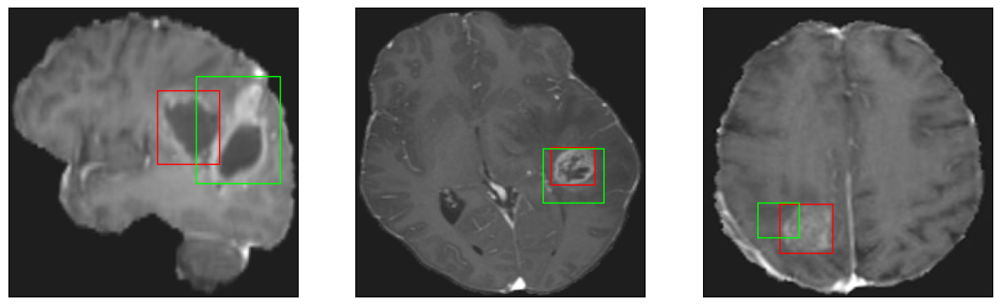

26/26 [==============================] - 7s 277ms/step - loss: 9.9413 - IoU: 0.4048 - val_loss: 11.8083 - val_IoU: 0.3782
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 9.8361 - IoU: 0.4041
Epoch 27: val_loss did not improve from 11.22269
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


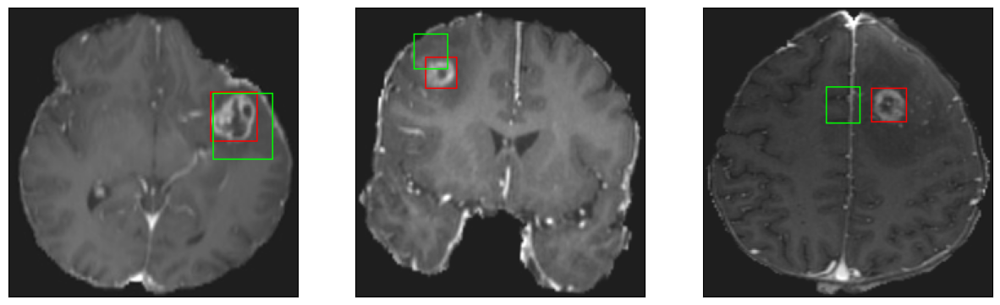

26/26 [==============================] - 7s 277ms/step - loss: 9.8361 - IoU: 0.4041 - val_loss: 11.7644 - val_IoU: 0.3890
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 8.6857 - IoU: 0.4634
Epoch 28: val_loss improved from 11.22269 to 10.97198, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


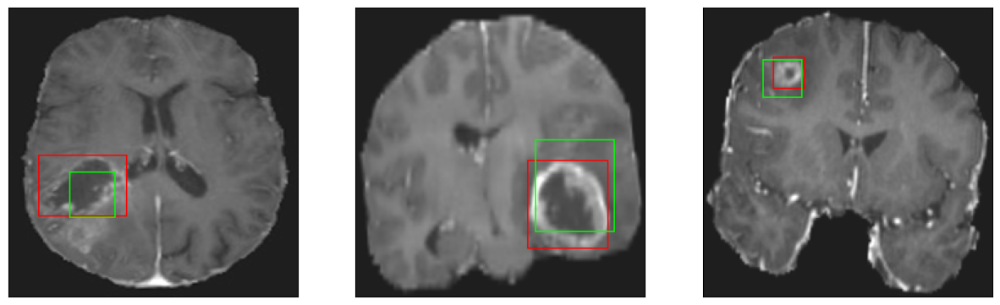

26/26 [==============================] - 14s 538ms/step - loss: 8.6857 - IoU: 0.4634 - val_loss: 10.9720 - val_IoU: 0.4012
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 9.4932 - IoU: 0.4133
Epoch 29: val_loss improved from 10.97198 to 10.55985, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


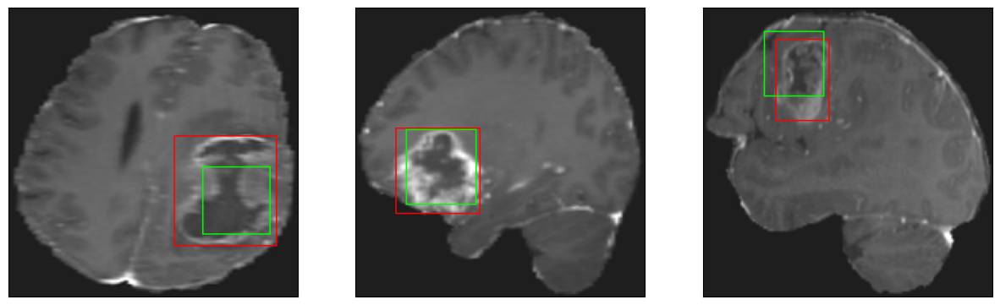

26/26 [==============================] - 14s 547ms/step - loss: 9.4932 - IoU: 0.4133 - val_loss: 10.5598 - val_IoU: 0.3872
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 9.1104 - IoU: 0.4356
Epoch 30: val_loss improved from 10.55985 to 9.99829, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


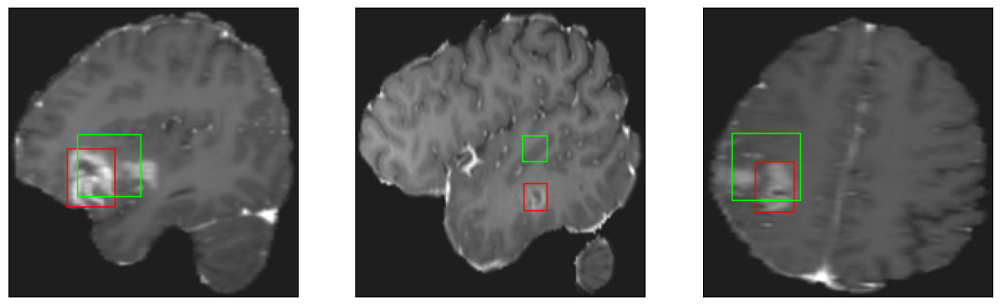

26/26 [==============================] - 13s 529ms/step - loss: 9.1104 - IoU: 0.4356 - val_loss: 9.9983 - val_IoU: 0.4297
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 9.3131 - IoU: 0.4264
Epoch 31: val_loss did not improve from 9.99829
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


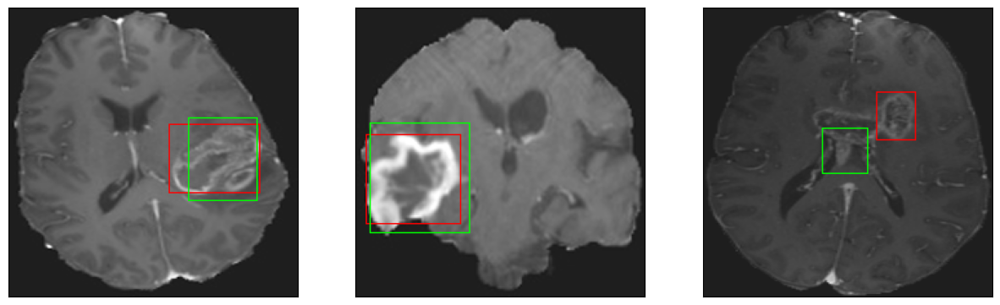

26/26 [==============================] - 7s 285ms/step - loss: 9.3131 - IoU: 0.4264 - val_loss: 10.8007 - val_IoU: 0.4345
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 8.7513 - IoU: 0.4451
Epoch 32: val_loss did not improve from 9.99829
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


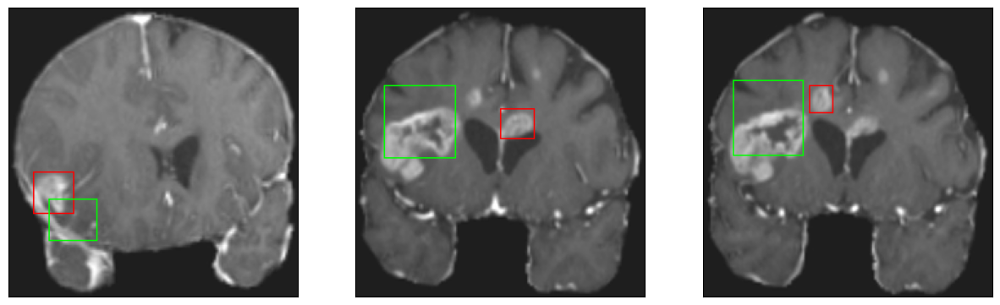

26/26 [==============================] - 7s 284ms/step - loss: 8.7513 - IoU: 0.4451 - val_loss: 11.6914 - val_IoU: 0.3596
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 8.9063 - IoU: 0.4369
Epoch 33: val_loss improved from 9.99829 to 9.92580, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


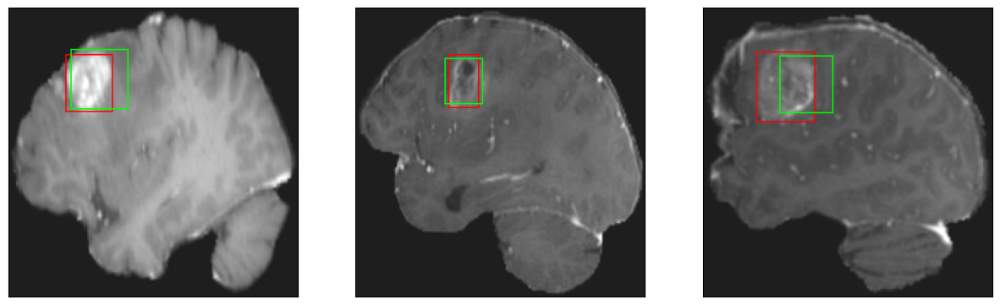

26/26 [==============================] - 14s 548ms/step - loss: 8.9063 - IoU: 0.4369 - val_loss: 9.9258 - val_IoU: 0.4556
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.0548 - IoU: 0.4331
Epoch 34: val_loss did not improve from 9.92580
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 51ms/step
4
8/8 [==============================] - 0s 42ms/step
4


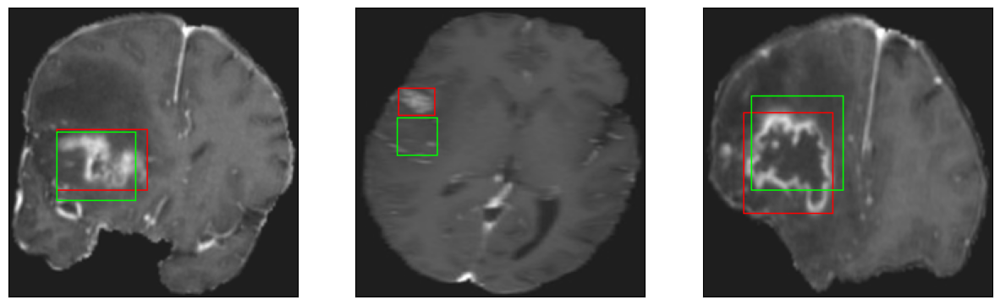

26/26 [==============================] - 8s 312ms/step - loss: 9.0548 - IoU: 0.4331 - val_loss: 11.2742 - val_IoU: 0.3943
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 8.9048 - IoU: 0.4406
Epoch 35: val_loss did not improve from 9.92580
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


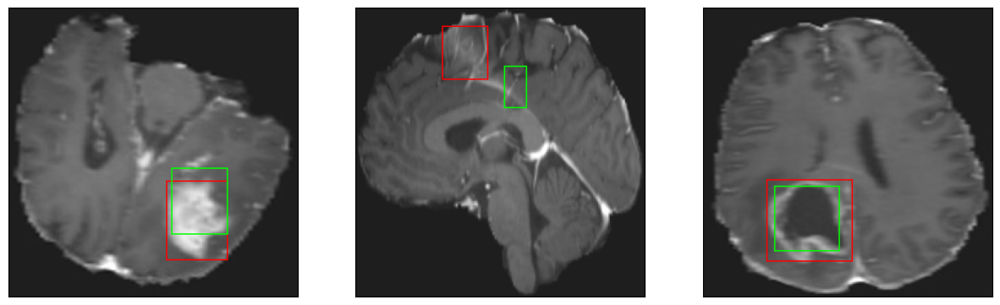

26/26 [==============================] - 7s 277ms/step - loss: 8.9048 - IoU: 0.4406 - val_loss: 11.2368 - val_IoU: 0.3757
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.0277 - IoU: 0.4435
Epoch 36: val_loss improved from 9.92580 to 9.31650, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


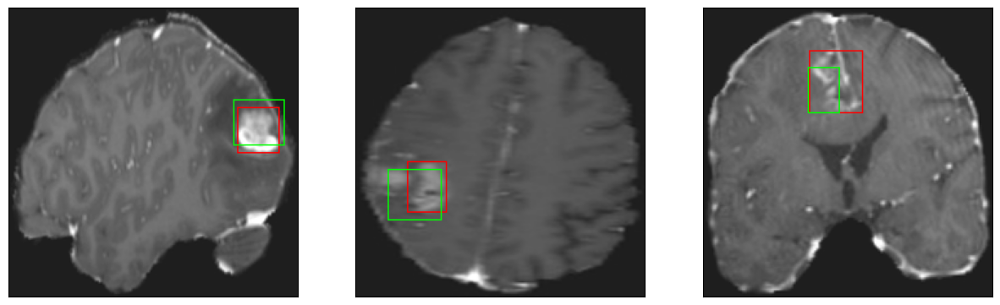

26/26 [==============================] - 14s 551ms/step - loss: 9.0277 - IoU: 0.4435 - val_loss: 9.3165 - val_IoU: 0.4745
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 8.7630 - IoU: 0.4435
Epoch 37: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 38ms/step
4


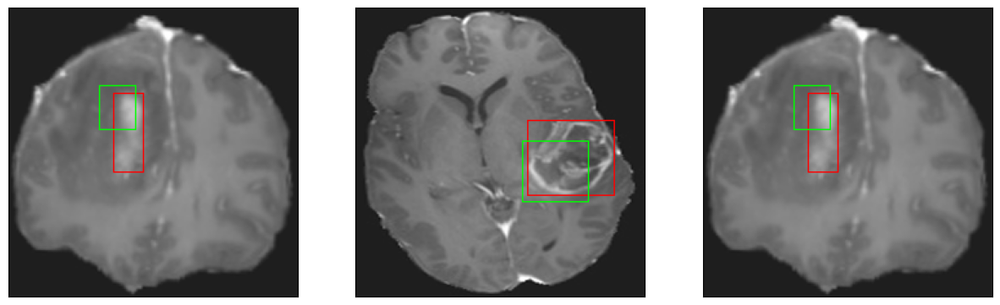

26/26 [==============================] - 8s 304ms/step - loss: 8.7630 - IoU: 0.4435 - val_loss: 11.4408 - val_IoU: 0.3818
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 8.7132 - IoU: 0.4578
Epoch 38: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


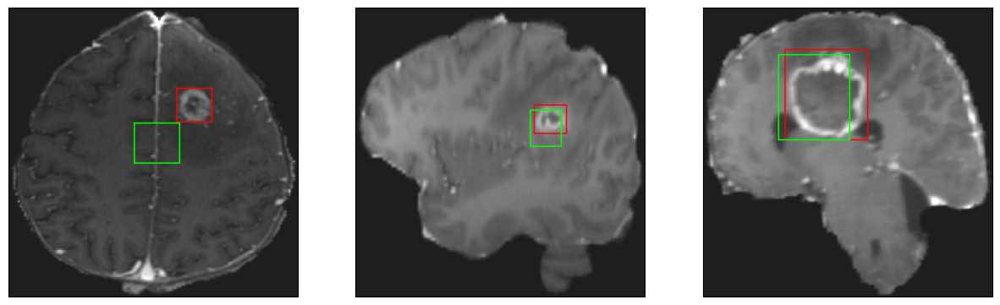

26/26 [==============================] - 8s 308ms/step - loss: 8.7132 - IoU: 0.4578 - val_loss: 10.0801 - val_IoU: 0.4543
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 8.3601 - IoU: 0.4684
Epoch 39: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


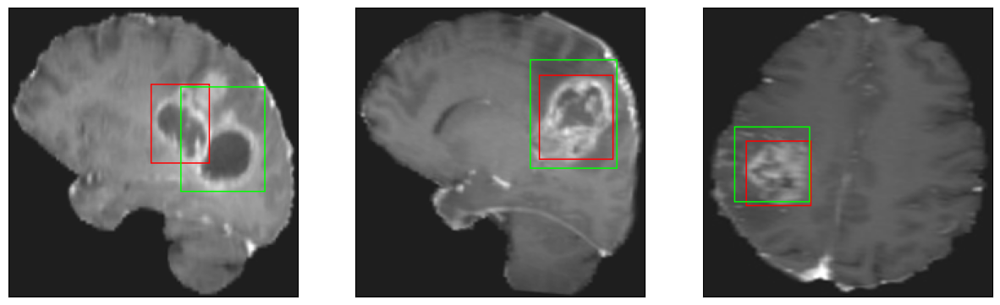

26/26 [==============================] - 7s 276ms/step - loss: 8.3601 - IoU: 0.4684 - val_loss: 11.0393 - val_IoU: 0.4363
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.6935 - IoU: 0.4419
Epoch 40: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


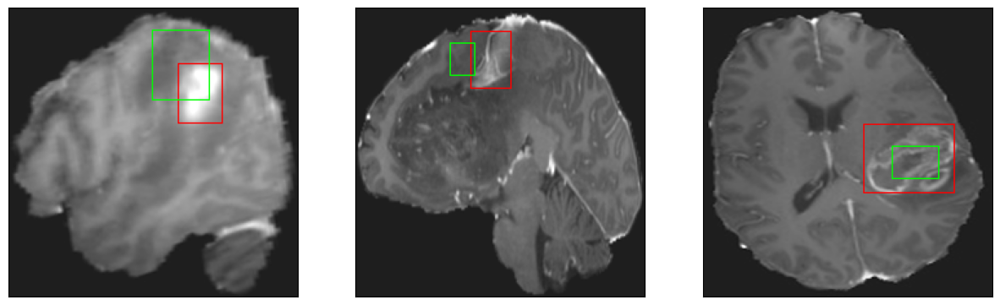

26/26 [==============================] - 7s 285ms/step - loss: 8.6935 - IoU: 0.4419 - val_loss: 10.2765 - val_IoU: 0.4060
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 9.1158 - IoU: 0.4310
Epoch 41: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


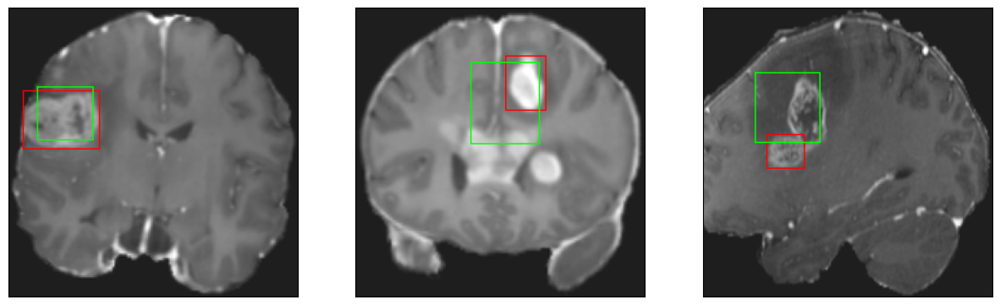

26/26 [==============================] - 8s 294ms/step - loss: 9.1158 - IoU: 0.4310 - val_loss: 10.3759 - val_IoU: 0.4537
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.1613 - IoU: 0.4678
Epoch 42: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


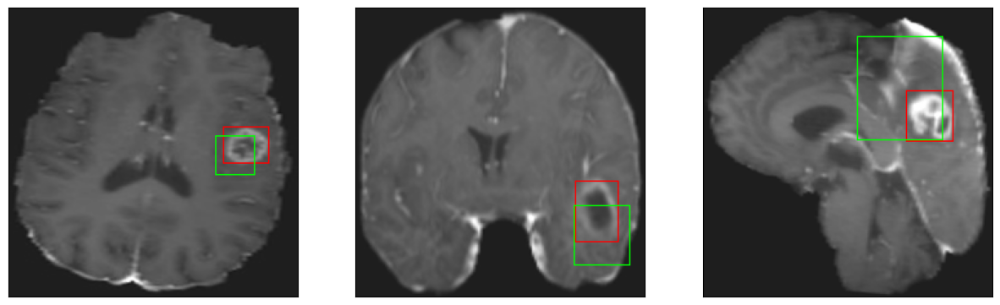

26/26 [==============================] - 7s 266ms/step - loss: 8.1613 - IoU: 0.4678 - val_loss: 9.6757 - val_IoU: 0.4481
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.1993 - IoU: 0.4616
Epoch 43: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


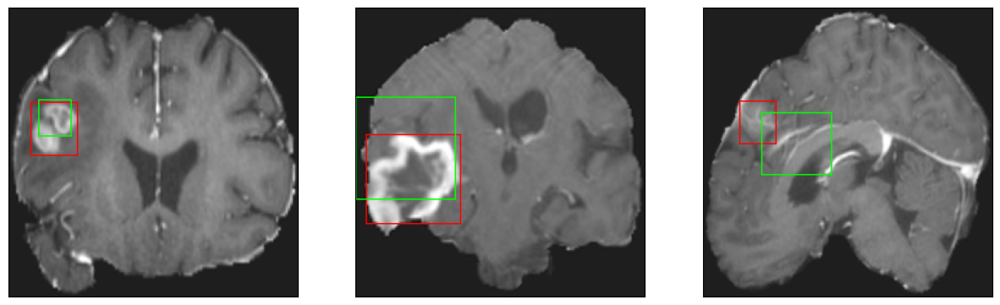

26/26 [==============================] - 8s 294ms/step - loss: 8.1993 - IoU: 0.4616 - val_loss: 10.1186 - val_IoU: 0.4200
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 7.9361 - IoU: 0.4790
Epoch 44: val_loss did not improve from 9.31650
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


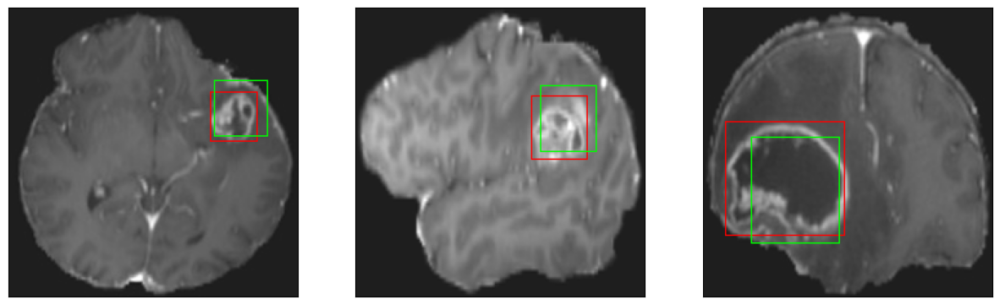

26/26 [==============================] - 8s 312ms/step - loss: 7.9361 - IoU: 0.4790 - val_loss: 9.8231 - val_IoU: 0.4437
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 7.9923 - IoU: 0.4738
Epoch 45: val_loss improved from 9.31650 to 9.00846, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 46ms/step
4


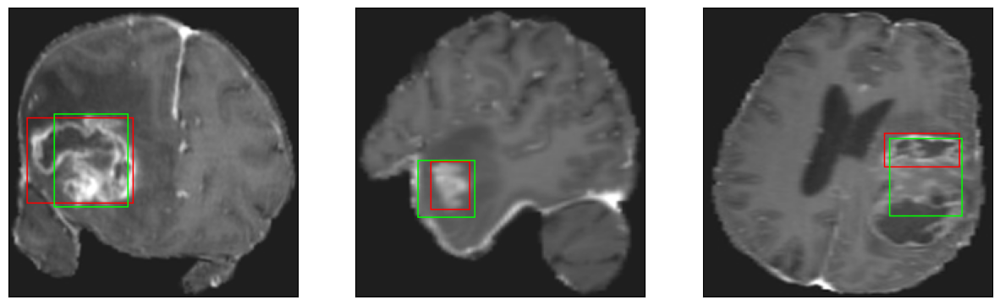

26/26 [==============================] - 13s 526ms/step - loss: 7.9923 - IoU: 0.4738 - val_loss: 9.0085 - val_IoU: 0.4909
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.0318 - IoU: 0.4734
Epoch 46: val_loss did not improve from 9.00846
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


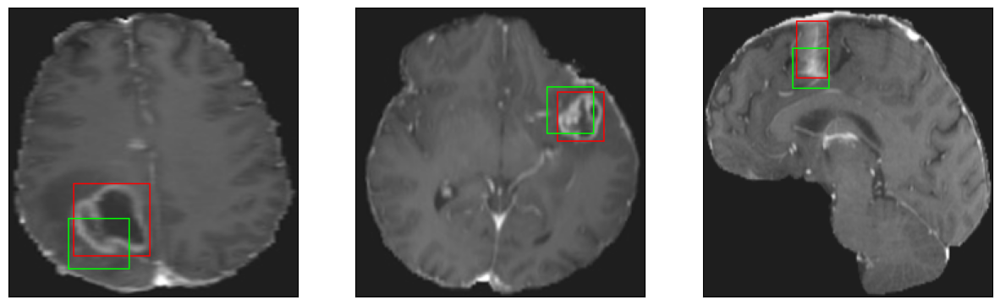

26/26 [==============================] - 8s 304ms/step - loss: 8.0318 - IoU: 0.4734 - val_loss: 9.6963 - val_IoU: 0.4525
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.8426 - IoU: 0.4406
Epoch 47: val_loss did not improve from 9.00846
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


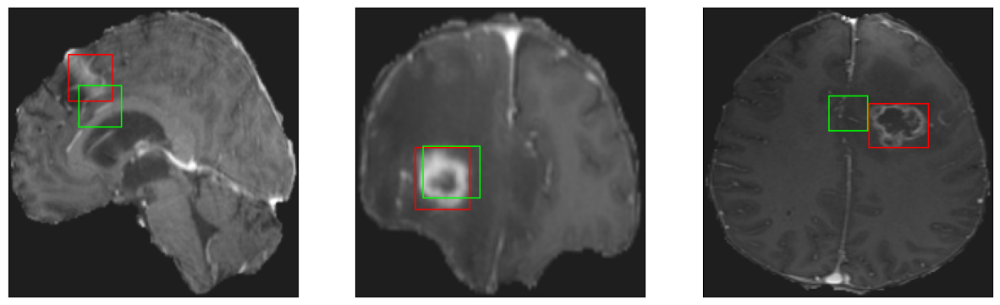

26/26 [==============================] - 7s 288ms/step - loss: 8.8426 - IoU: 0.4406 - val_loss: 10.1037 - val_IoU: 0.4169
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.0411 - IoU: 0.4746
Epoch 48: val_loss improved from 9.00846 to 8.63055, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


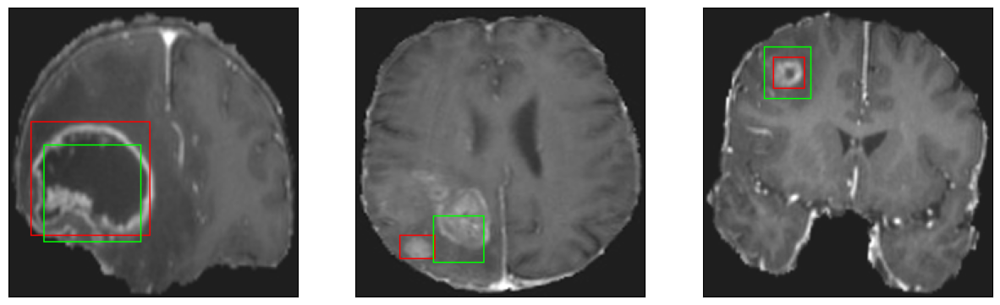

26/26 [==============================] - 14s 540ms/step - loss: 8.0411 - IoU: 0.4746 - val_loss: 8.6305 - val_IoU: 0.5164
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 7.7019 - IoU: 0.4912
Epoch 49: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


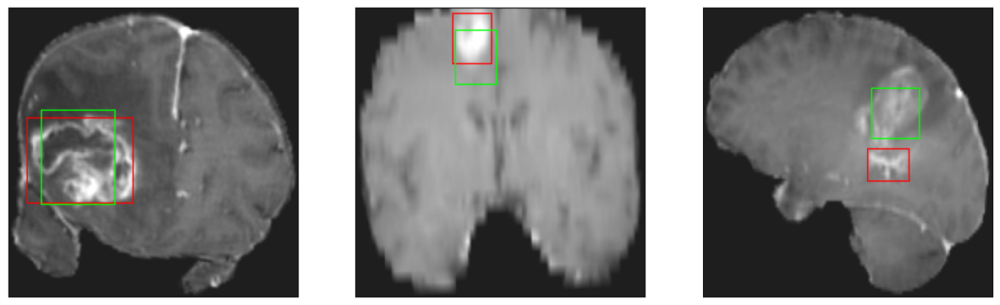

26/26 [==============================] - 8s 300ms/step - loss: 7.7019 - IoU: 0.4912 - val_loss: 9.1887 - val_IoU: 0.4775
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 7.9314 - IoU: 0.4706
Epoch 50: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


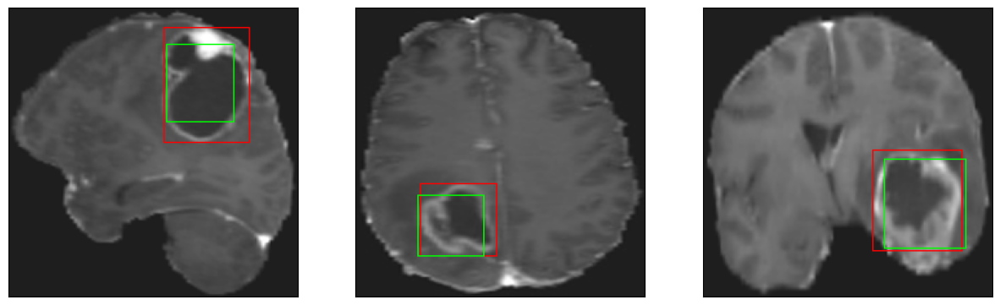

26/26 [==============================] - 8s 291ms/step - loss: 7.9314 - IoU: 0.4706 - val_loss: 9.3100 - val_IoU: 0.4741
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 7.7813 - IoU: 0.4900
Epoch 51: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


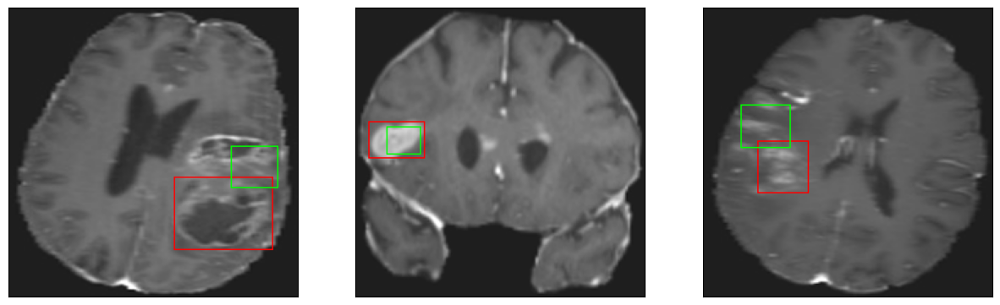

26/26 [==============================] - 8s 295ms/step - loss: 7.7813 - IoU: 0.4900 - val_loss: 11.7152 - val_IoU: 0.3747
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 7.8035 - IoU: 0.4807
Epoch 52: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


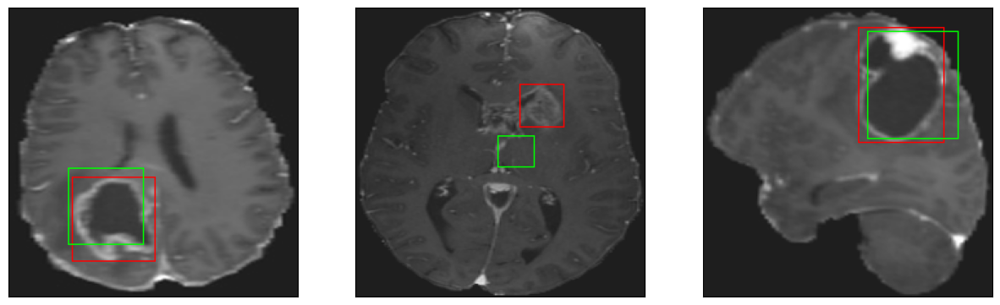

26/26 [==============================] - 7s 279ms/step - loss: 7.8035 - IoU: 0.4807 - val_loss: 9.8685 - val_IoU: 0.4410
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 7.7101 - IoU: 0.4840
Epoch 53: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


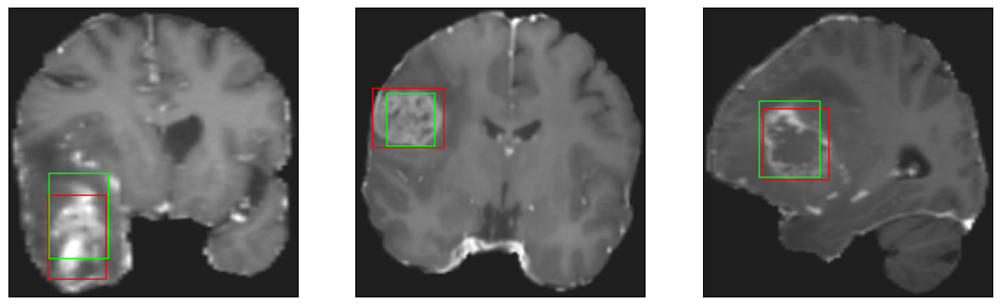

26/26 [==============================] - 7s 281ms/step - loss: 7.7101 - IoU: 0.4840 - val_loss: 9.2851 - val_IoU: 0.4889
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 8.1256 - IoU: 0.4615
Epoch 54: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


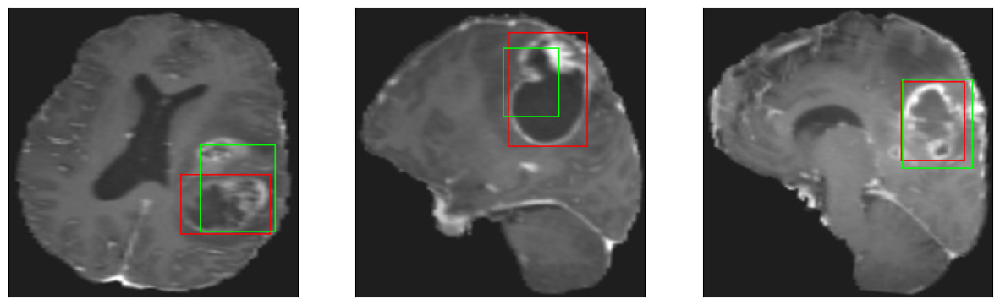

26/26 [==============================] - 8s 296ms/step - loss: 8.1256 - IoU: 0.4615 - val_loss: 10.3519 - val_IoU: 0.4008
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 7.8691 - IoU: 0.4783
Epoch 55: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


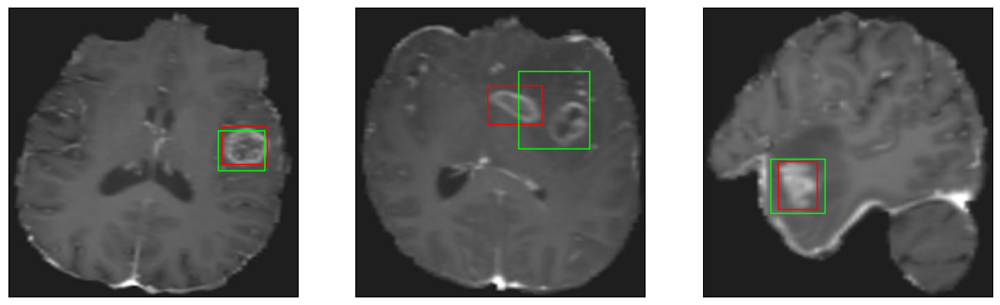

26/26 [==============================] - 8s 301ms/step - loss: 7.8691 - IoU: 0.4783 - val_loss: 10.2605 - val_IoU: 0.4649
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 8.1330 - IoU: 0.4660
Epoch 56: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


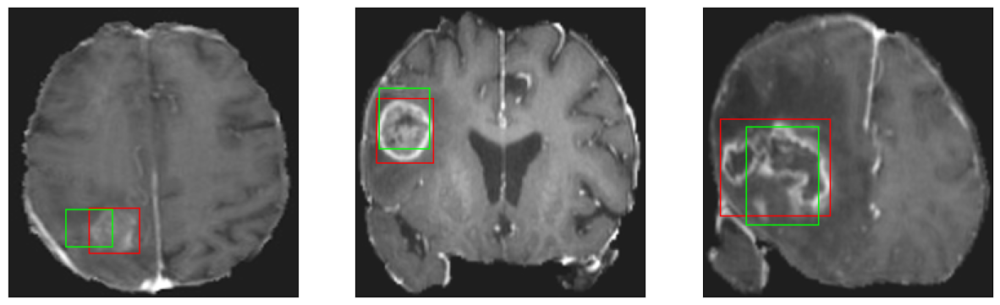

26/26 [==============================] - 7s 287ms/step - loss: 8.1330 - IoU: 0.4660 - val_loss: 10.3955 - val_IoU: 0.4388
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.8993 - IoU: 0.4766
Epoch 57: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


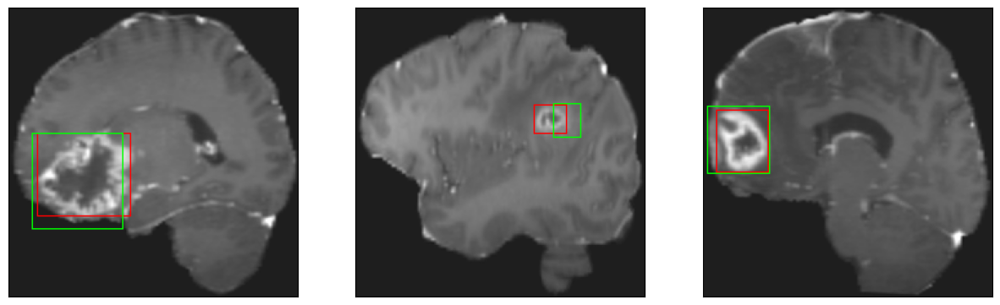

26/26 [==============================] - 7s 289ms/step - loss: 7.8993 - IoU: 0.4766 - val_loss: 8.8366 - val_IoU: 0.5026
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.6641 - IoU: 0.4877
Epoch 58: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


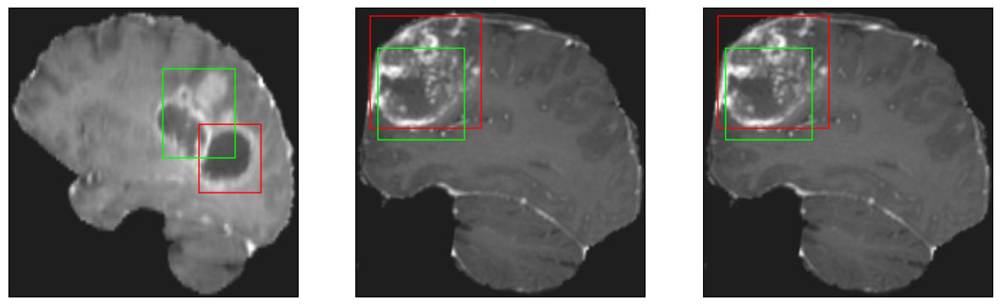

26/26 [==============================] - 8s 291ms/step - loss: 7.6641 - IoU: 0.4877 - val_loss: 10.8381 - val_IoU: 0.4268
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.3499 - IoU: 0.4997
Epoch 59: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


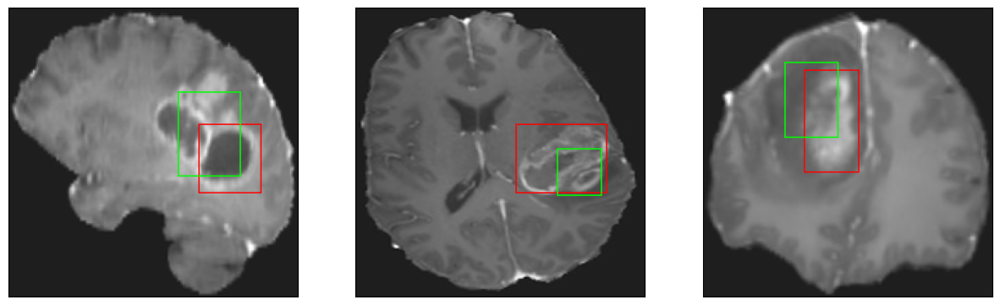

26/26 [==============================] - 7s 288ms/step - loss: 7.3499 - IoU: 0.4997 - val_loss: 8.9852 - val_IoU: 0.4631
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.6189 - IoU: 0.4842
Epoch 60: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


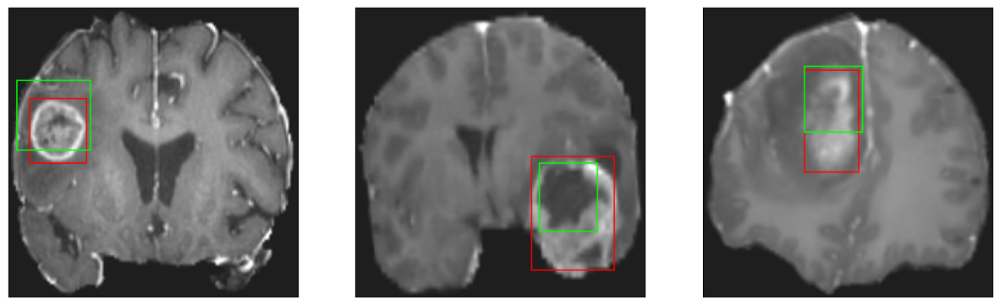

26/26 [==============================] - 7s 287ms/step - loss: 7.6189 - IoU: 0.4842 - val_loss: 10.3796 - val_IoU: 0.4002
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.3502 - IoU: 0.4986
Epoch 61: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


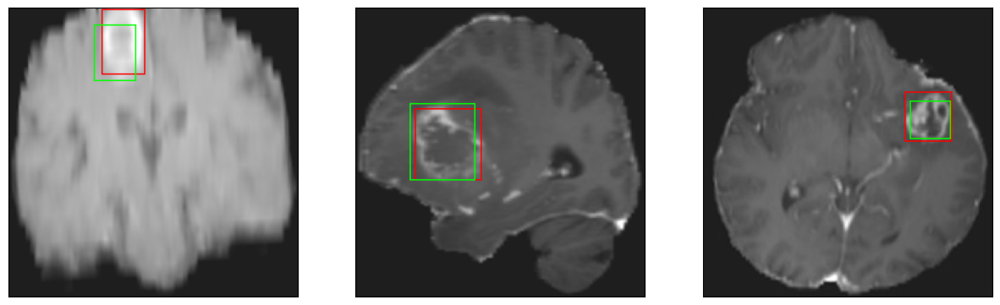

26/26 [==============================] - 8s 294ms/step - loss: 7.3502 - IoU: 0.4986 - val_loss: 9.1286 - val_IoU: 0.4931
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.4633 - IoU: 0.4883
Epoch 62: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


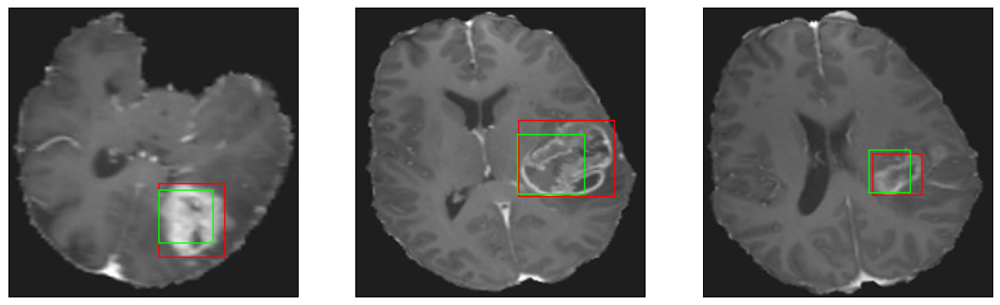

26/26 [==============================] - 7s 289ms/step - loss: 7.4633 - IoU: 0.4883 - val_loss: 11.4734 - val_IoU: 0.3932
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.3456 - IoU: 0.4999
Epoch 63: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


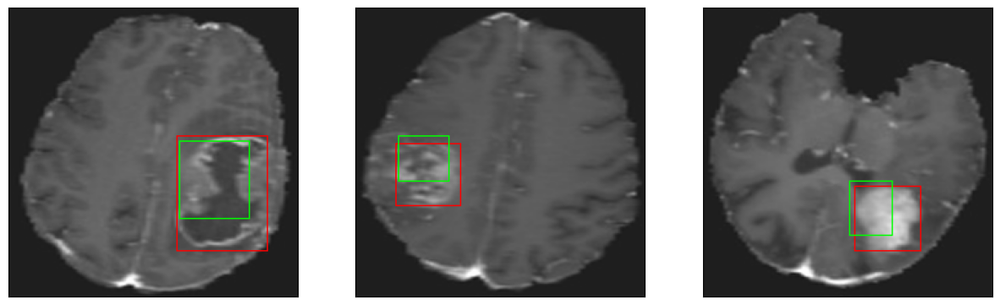

26/26 [==============================] - 7s 288ms/step - loss: 7.3456 - IoU: 0.4999 - val_loss: 9.3989 - val_IoU: 0.4558
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.3774 - IoU: 0.5014
Epoch 64: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


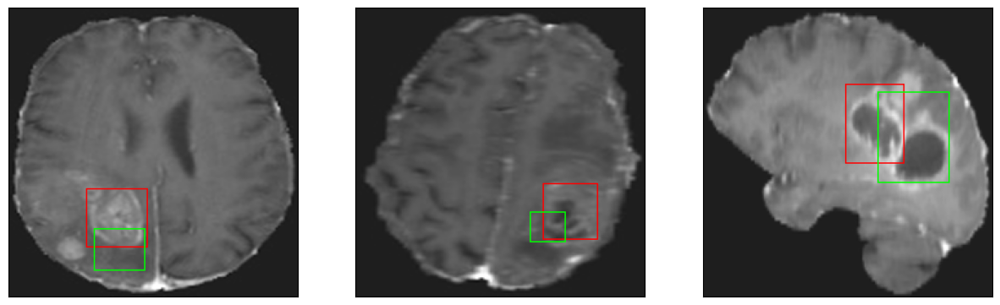

26/26 [==============================] - 7s 278ms/step - loss: 7.3774 - IoU: 0.5014 - val_loss: 8.7703 - val_IoU: 0.5010
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.5664 - IoU: 0.4890
Epoch 65: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


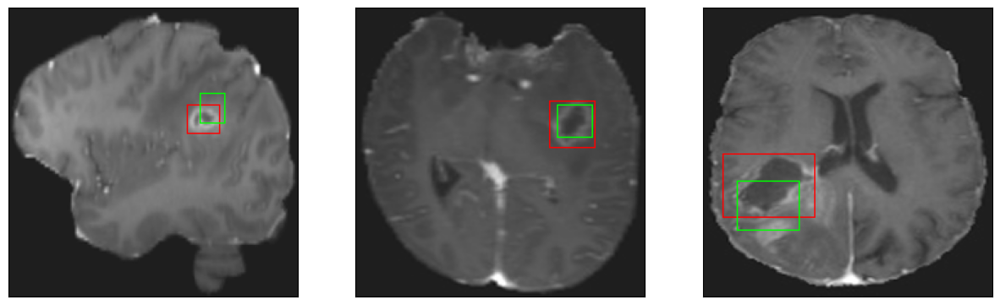

26/26 [==============================] - 7s 289ms/step - loss: 7.5664 - IoU: 0.4890 - val_loss: 9.7045 - val_IoU: 0.4456
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.4544 - IoU: 0.5081
Epoch 66: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


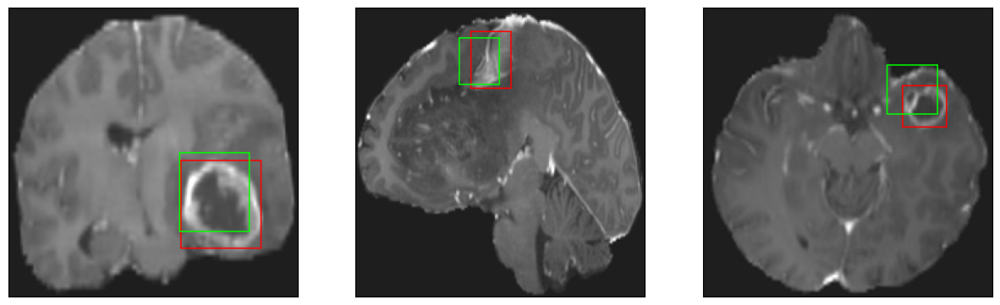

26/26 [==============================] - 7s 288ms/step - loss: 7.4544 - IoU: 0.5081 - val_loss: 9.1014 - val_IoU: 0.4865
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.1136 - IoU: 0.5093
Epoch 67: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


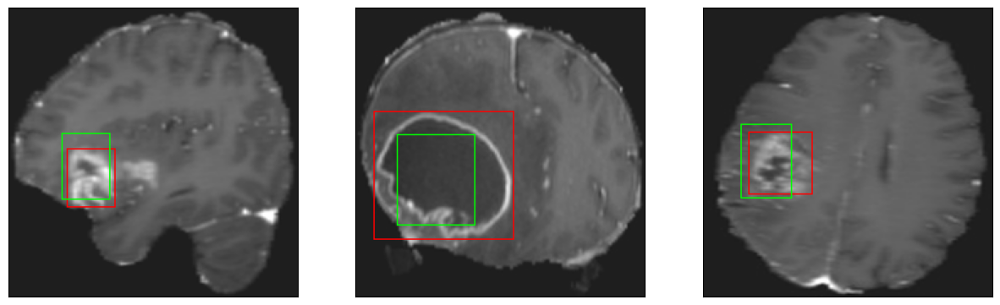

26/26 [==============================] - 8s 299ms/step - loss: 7.1136 - IoU: 0.5093 - val_loss: 10.0455 - val_IoU: 0.4359
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.3662 - IoU: 0.5036
Epoch 68: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


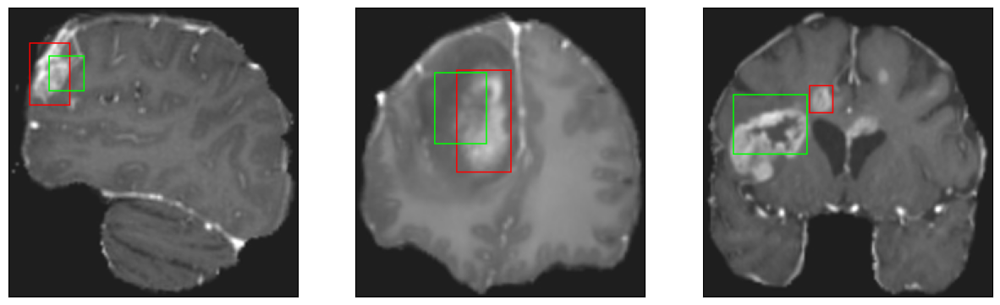

26/26 [==============================] - 7s 286ms/step - loss: 7.3662 - IoU: 0.5036 - val_loss: 10.3667 - val_IoU: 0.4064
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.1647 - IoU: 0.5027
Epoch 69: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


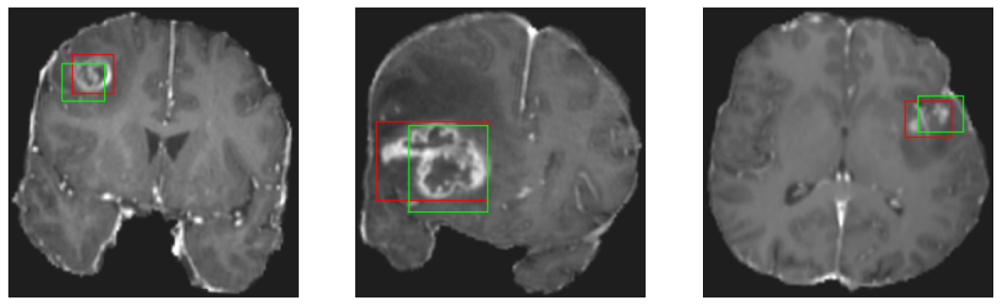

26/26 [==============================] - 8s 291ms/step - loss: 7.1647 - IoU: 0.5027 - val_loss: 9.3220 - val_IoU: 0.4834
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.3493 - IoU: 0.4976
Epoch 70: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


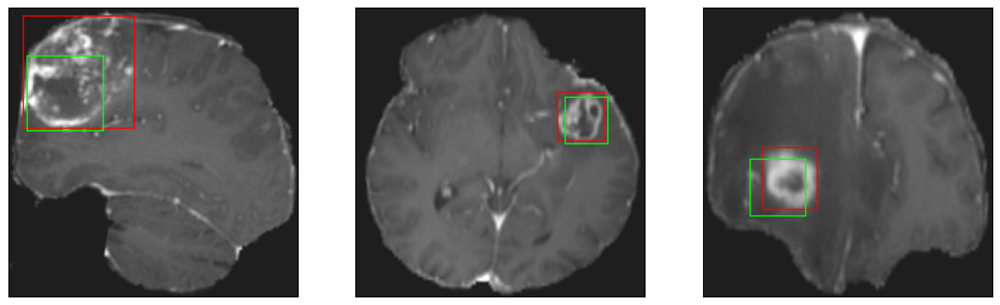

26/26 [==============================] - 8s 302ms/step - loss: 7.3493 - IoU: 0.4976 - val_loss: 9.1280 - val_IoU: 0.4714
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.4391 - IoU: 0.4915
Epoch 71: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4


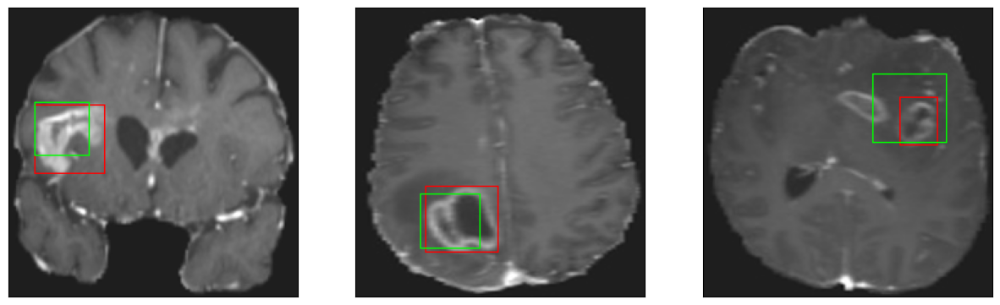

26/26 [==============================] - 8s 297ms/step - loss: 7.4391 - IoU: 0.4915 - val_loss: 8.9242 - val_IoU: 0.4711
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.2836 - IoU: 0.5041
Epoch 72: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


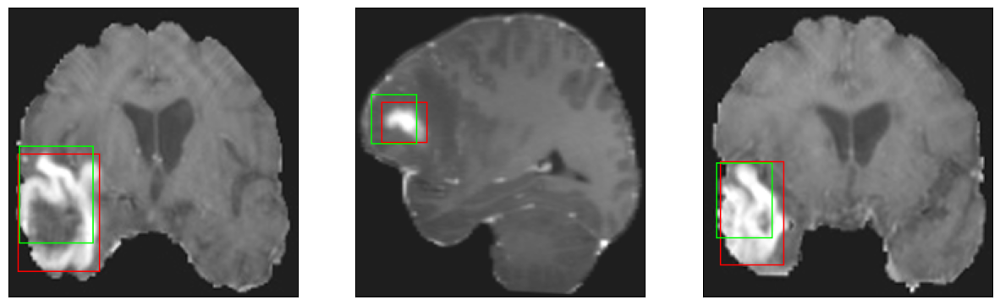

26/26 [==============================] - 8s 291ms/step - loss: 7.2836 - IoU: 0.5041 - val_loss: 9.3675 - val_IoU: 0.4650
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.1342 - IoU: 0.5019
Epoch 73: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


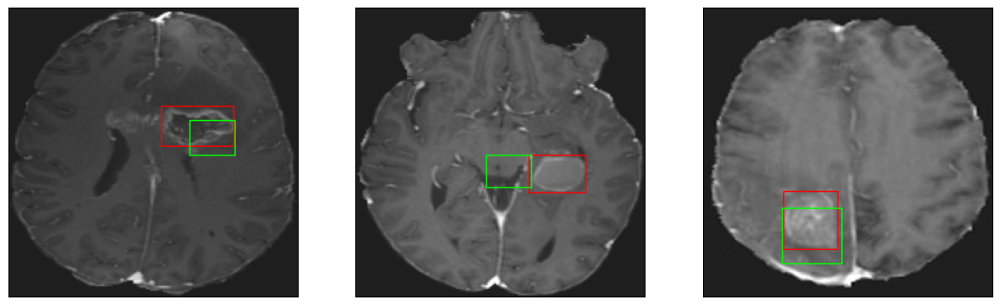

26/26 [==============================] - 8s 298ms/step - loss: 7.1342 - IoU: 0.5019 - val_loss: 9.2075 - val_IoU: 0.5137
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 6.9082 - IoU: 0.5237
Epoch 74: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


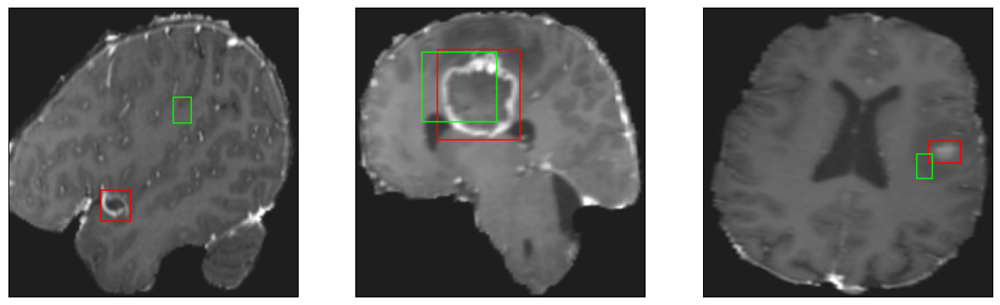

26/26 [==============================] - 8s 313ms/step - loss: 6.9082 - IoU: 0.5237 - val_loss: 9.3786 - val_IoU: 0.4566
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.0035 - IoU: 0.5136
Epoch 75: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


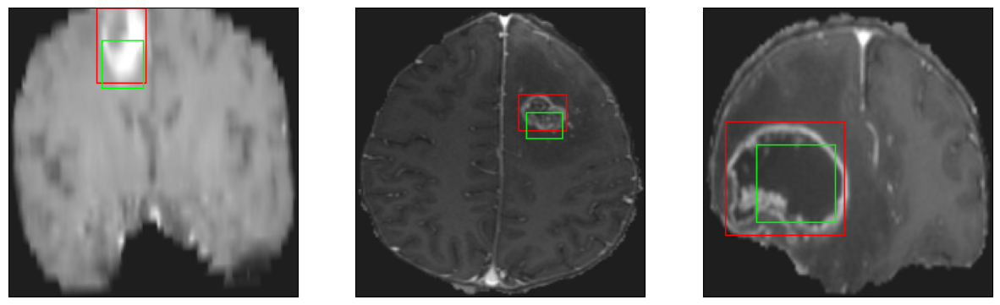

26/26 [==============================] - 7s 280ms/step - loss: 7.0035 - IoU: 0.5136 - val_loss: 10.2568 - val_IoU: 0.4275
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.1343 - IoU: 0.5246
Epoch 76: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


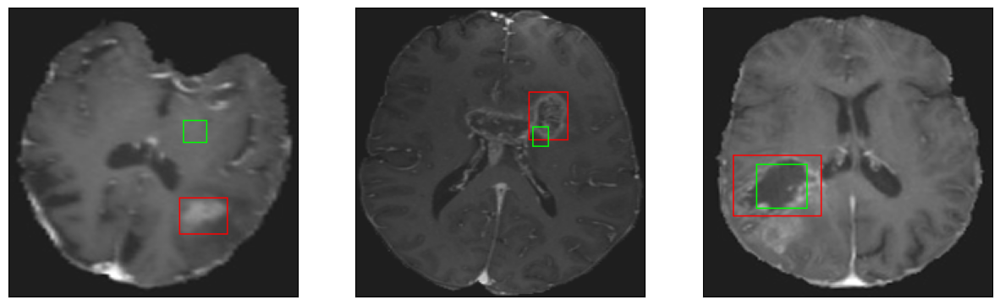

26/26 [==============================] - 7s 284ms/step - loss: 7.1343 - IoU: 0.5246 - val_loss: 9.8014 - val_IoU: 0.4255
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 6.7635 - IoU: 0.5301
Epoch 77: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


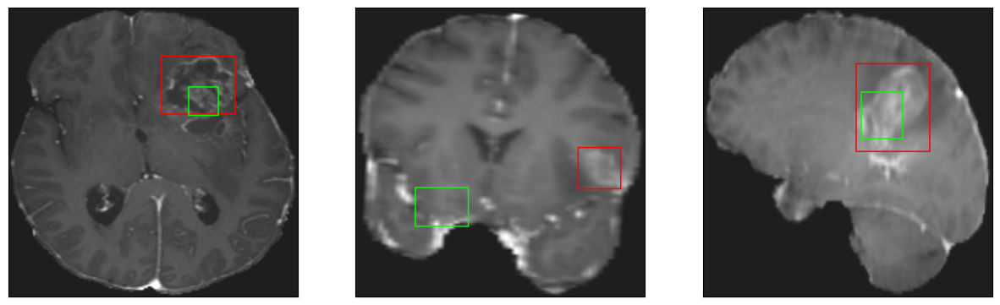

26/26 [==============================] - 7s 285ms/step - loss: 6.7635 - IoU: 0.5301 - val_loss: 8.7375 - val_IoU: 0.4804
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.0932 - IoU: 0.5135
Epoch 78: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


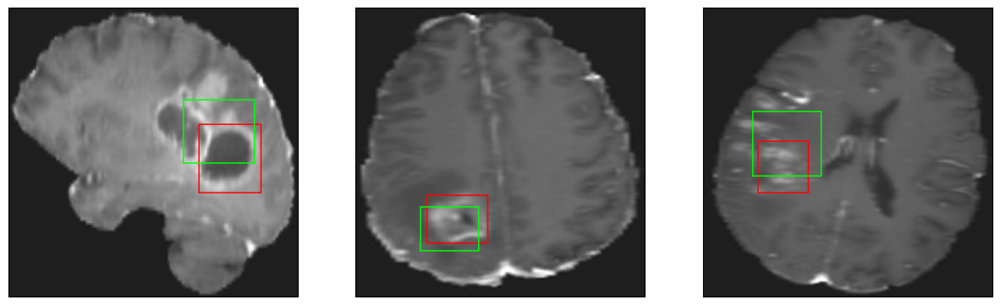

26/26 [==============================] - 8s 310ms/step - loss: 7.0932 - IoU: 0.5135 - val_loss: 11.9334 - val_IoU: 0.3726
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 6.6817 - IoU: 0.5309
Epoch 79: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


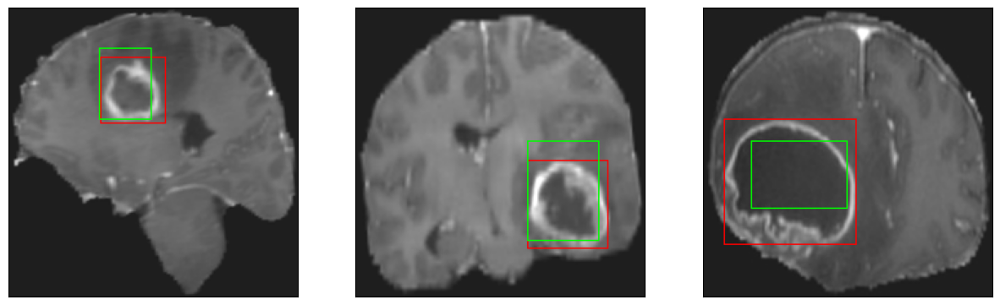

26/26 [==============================] - 7s 285ms/step - loss: 6.6817 - IoU: 0.5309 - val_loss: 9.2669 - val_IoU: 0.4554
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 6.9555 - IoU: 0.5185
Epoch 80: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


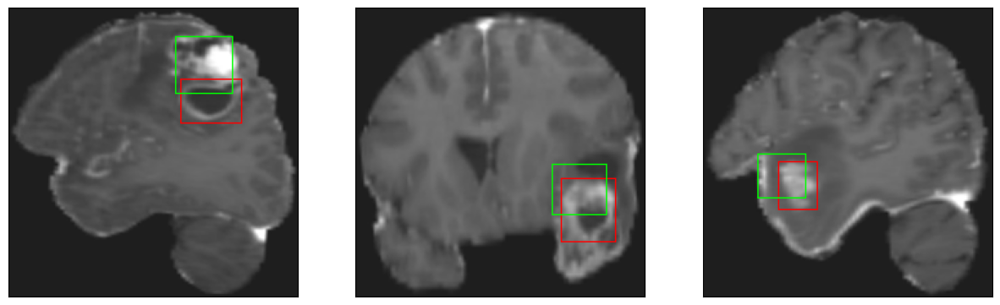

26/26 [==============================] - 8s 325ms/step - loss: 6.9555 - IoU: 0.5185 - val_loss: 8.9926 - val_IoU: 0.4746
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.6078 - IoU: 0.5377
Epoch 81: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


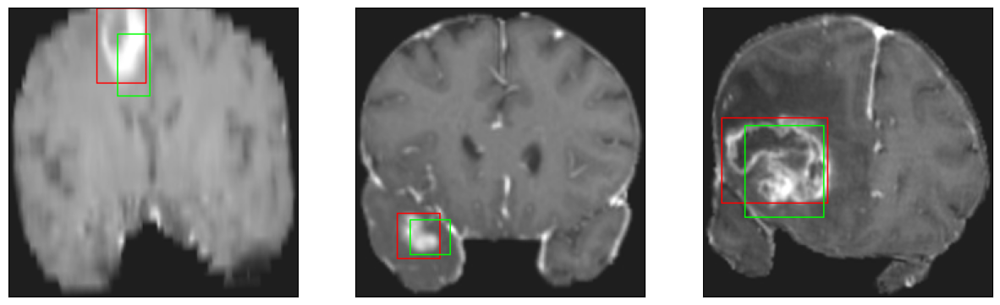

26/26 [==============================] - 8s 320ms/step - loss: 6.6078 - IoU: 0.5377 - val_loss: 10.5134 - val_IoU: 0.4125
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 7.0997 - IoU: 0.5098
Epoch 82: val_loss did not improve from 8.63055
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


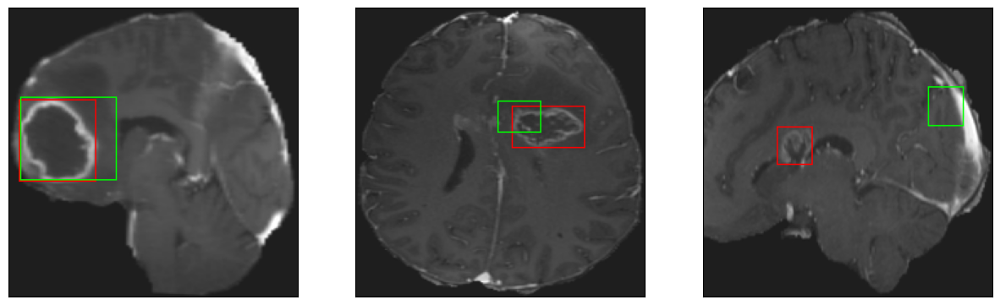

26/26 [==============================] - 8s 297ms/step - loss: 7.0997 - IoU: 0.5098 - val_loss: 9.7885 - val_IoU: 0.4591
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.8357 - IoU: 0.5263
Epoch 83: val_loss improved from 8.63055 to 8.21914, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


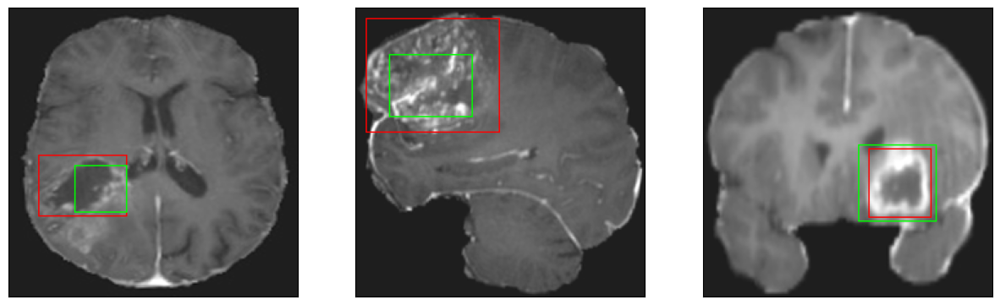

26/26 [==============================] - 15s 586ms/step - loss: 6.8357 - IoU: 0.5263 - val_loss: 8.2191 - val_IoU: 0.5117
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.6628 - IoU: 0.5254
Epoch 84: val_loss improved from 8.21914 to 8.04455, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 44ms/step
4


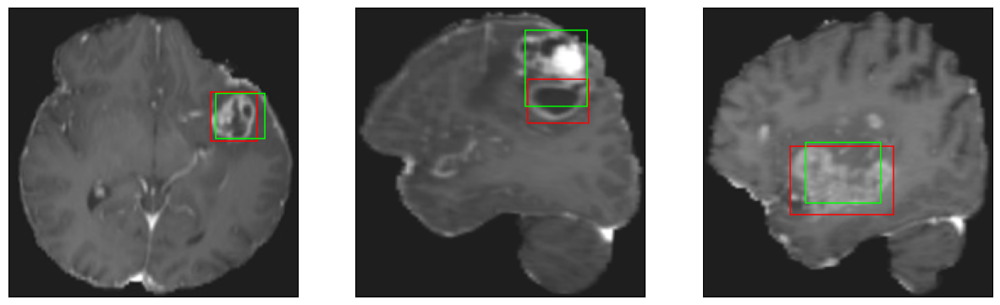

26/26 [==============================] - 14s 567ms/step - loss: 6.6628 - IoU: 0.5254 - val_loss: 8.0445 - val_IoU: 0.5215
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.5811 - IoU: 0.5311
Epoch 85: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


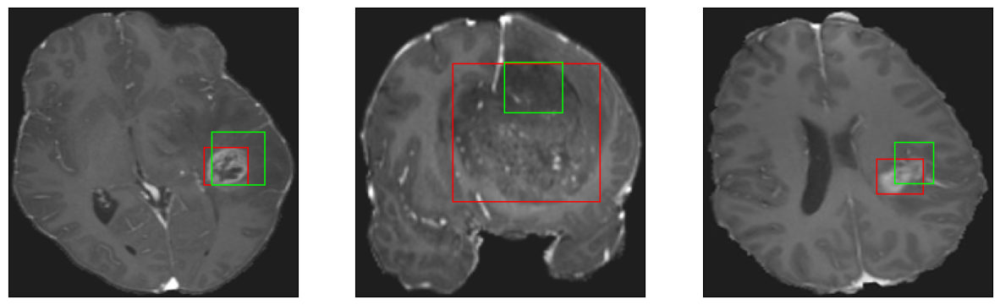

26/26 [==============================] - 8s 324ms/step - loss: 6.5811 - IoU: 0.5311 - val_loss: 8.6635 - val_IoU: 0.5005
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.8891 - IoU: 0.5076
Epoch 86: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


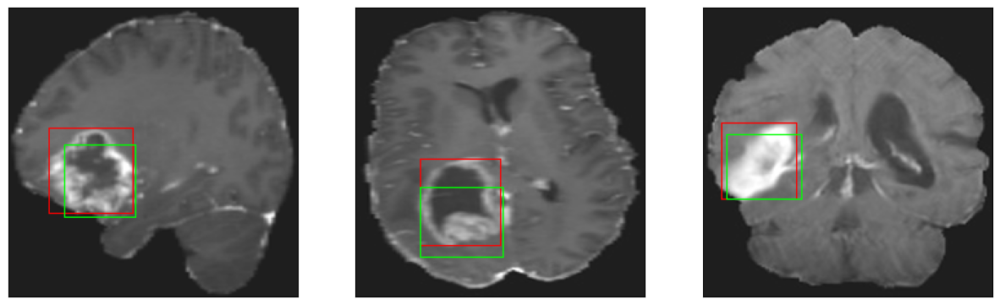

26/26 [==============================] - 8s 315ms/step - loss: 6.8891 - IoU: 0.5076 - val_loss: 12.0728 - val_IoU: 0.3768
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.7827 - IoU: 0.5238
Epoch 87: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


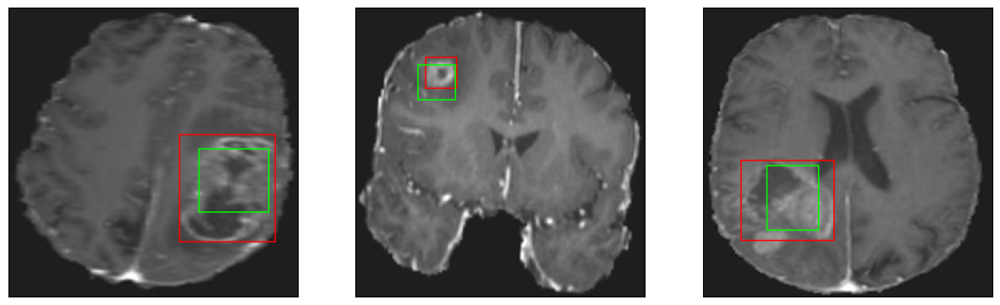

26/26 [==============================] - 8s 300ms/step - loss: 6.7827 - IoU: 0.5238 - val_loss: 8.5414 - val_IoU: 0.4979
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.4514 - IoU: 0.5367
Epoch 88: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


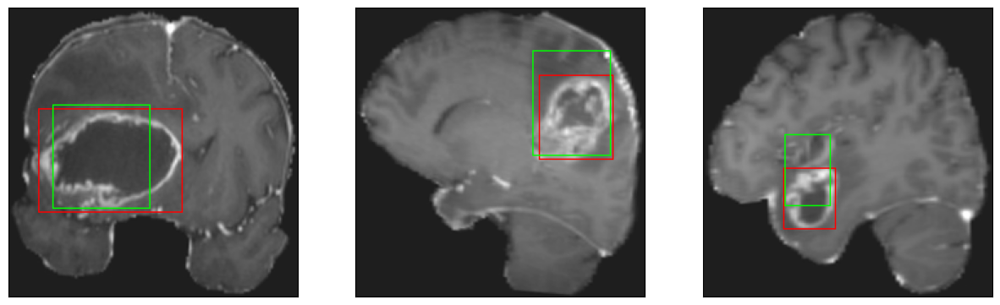

26/26 [==============================] - 8s 308ms/step - loss: 6.4514 - IoU: 0.5367 - val_loss: 9.3413 - val_IoU: 0.4613
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.7807 - IoU: 0.5236
Epoch 89: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


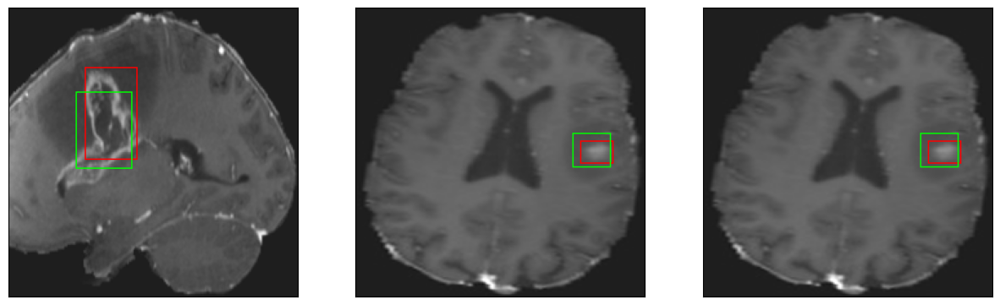

26/26 [==============================] - 8s 301ms/step - loss: 6.7807 - IoU: 0.5236 - val_loss: 8.7806 - val_IoU: 0.4739
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.7676 - IoU: 0.5325
Epoch 90: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


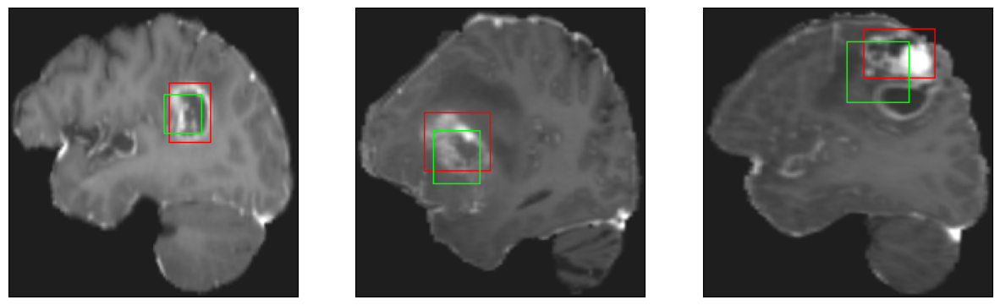

26/26 [==============================] - 7s 288ms/step - loss: 6.7676 - IoU: 0.5325 - val_loss: 10.8267 - val_IoU: 0.3812
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.4570 - IoU: 0.5399
Epoch 91: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


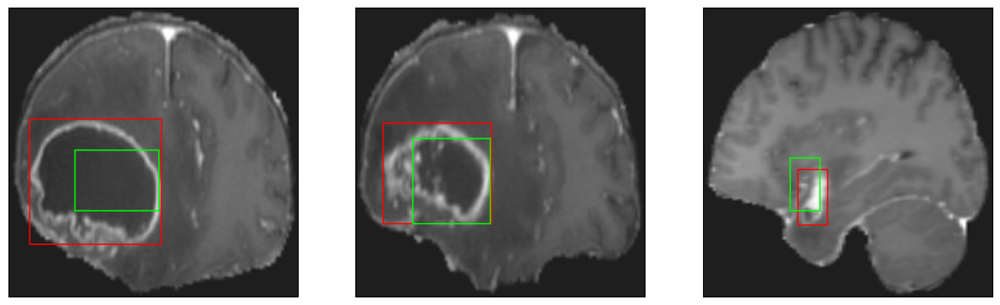

26/26 [==============================] - 7s 279ms/step - loss: 6.4570 - IoU: 0.5399 - val_loss: 9.7267 - val_IoU: 0.4644
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.2166 - IoU: 0.5476
Epoch 92: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


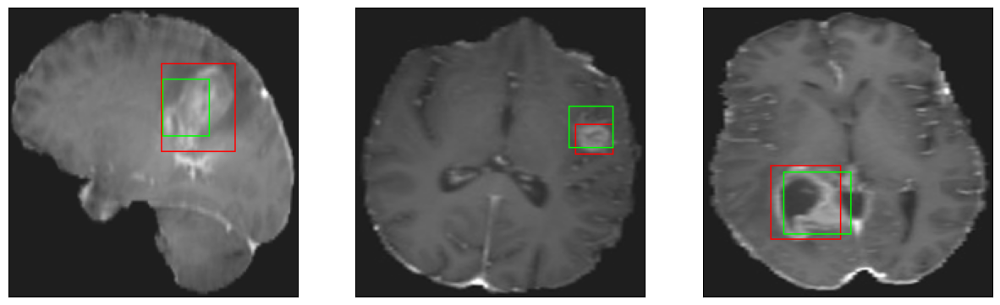

26/26 [==============================] - 8s 312ms/step - loss: 6.2166 - IoU: 0.5476 - val_loss: 8.6826 - val_IoU: 0.4911
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.3356 - IoU: 0.5460
Epoch 93: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


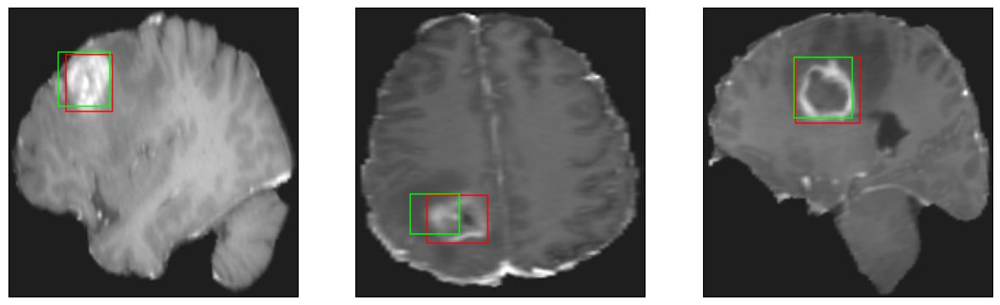

26/26 [==============================] - 7s 286ms/step - loss: 6.3356 - IoU: 0.5460 - val_loss: 9.2433 - val_IoU: 0.4751
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.5973 - IoU: 0.5323
Epoch 94: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


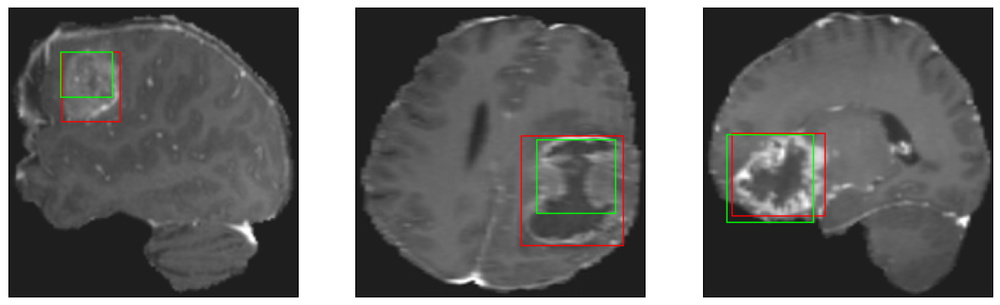

26/26 [==============================] - 8s 297ms/step - loss: 6.5973 - IoU: 0.5323 - val_loss: 8.7373 - val_IoU: 0.4919
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.3889 - IoU: 0.5490
Epoch 95: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


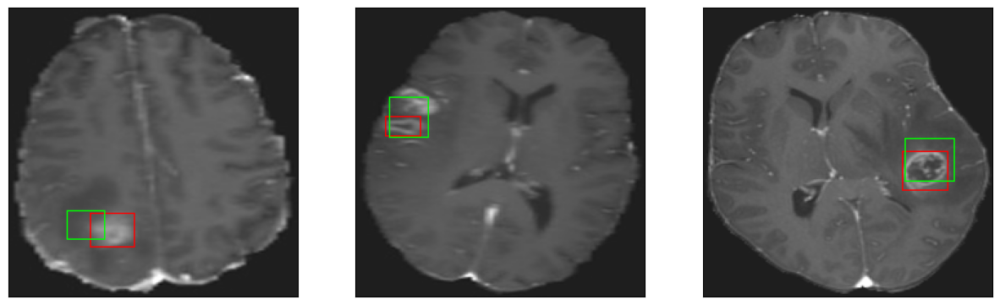

26/26 [==============================] - 8s 303ms/step - loss: 6.3889 - IoU: 0.5490 - val_loss: 8.9787 - val_IoU: 0.4799
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.2603 - IoU: 0.5409
Epoch 96: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


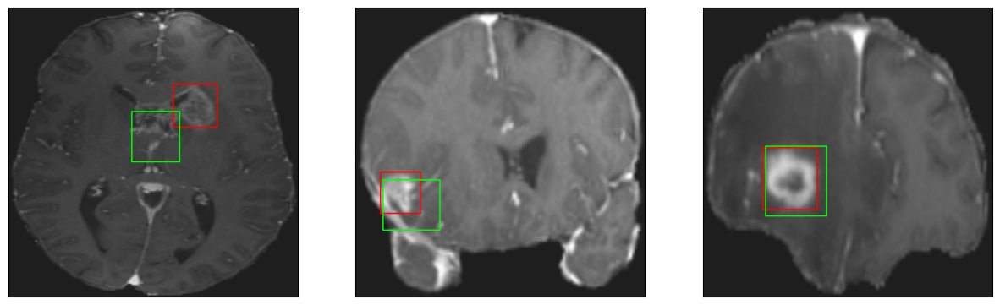

26/26 [==============================] - 8s 309ms/step - loss: 6.2603 - IoU: 0.5409 - val_loss: 9.2184 - val_IoU: 0.4840
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.6145 - IoU: 0.5311
Epoch 97: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


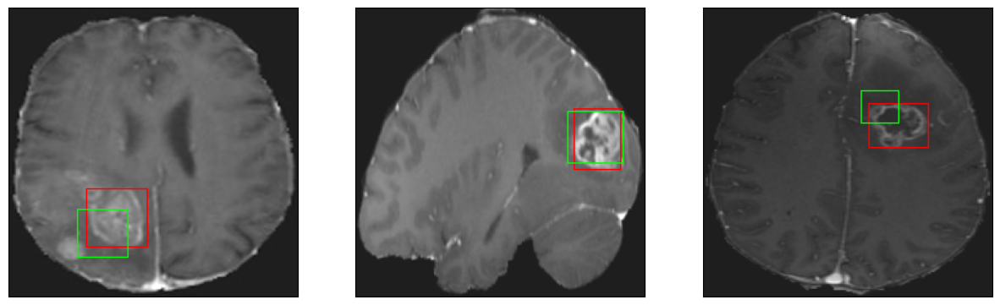

26/26 [==============================] - 8s 301ms/step - loss: 6.6145 - IoU: 0.5311 - val_loss: 8.0844 - val_IoU: 0.5148
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.8344 - IoU: 0.5177
Epoch 98: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


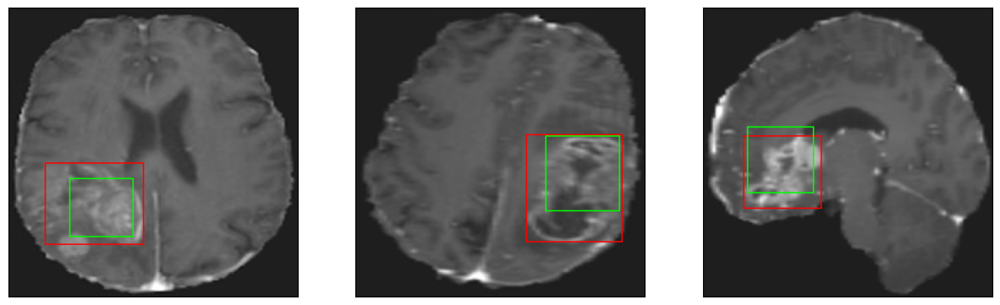

26/26 [==============================] - 8s 300ms/step - loss: 6.8344 - IoU: 0.5177 - val_loss: 8.6306 - val_IoU: 0.5023
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.4610 - IoU: 0.5414
Epoch 99: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


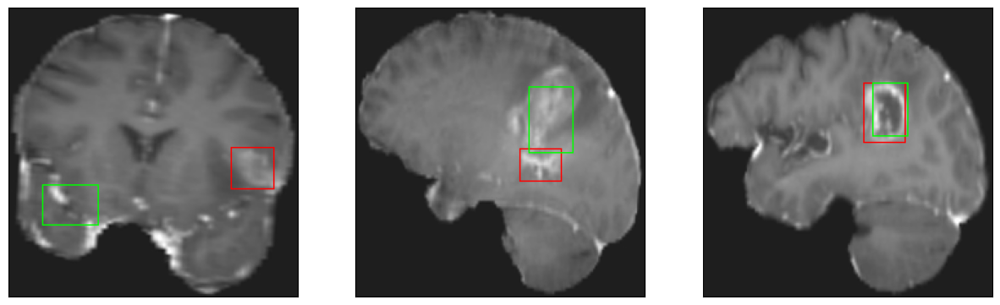

26/26 [==============================] - 8s 307ms/step - loss: 6.4610 - IoU: 0.5414 - val_loss: 8.2339 - val_IoU: 0.5459
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.2540 - IoU: 0.5459
Epoch 100: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


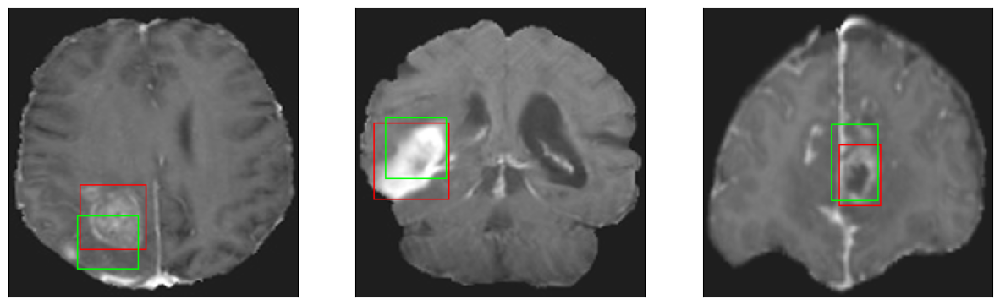

26/26 [==============================] - 8s 314ms/step - loss: 6.2540 - IoU: 0.5459 - val_loss: 8.2510 - val_IoU: 0.5204
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.5328 - IoU: 0.5334
Epoch 101: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


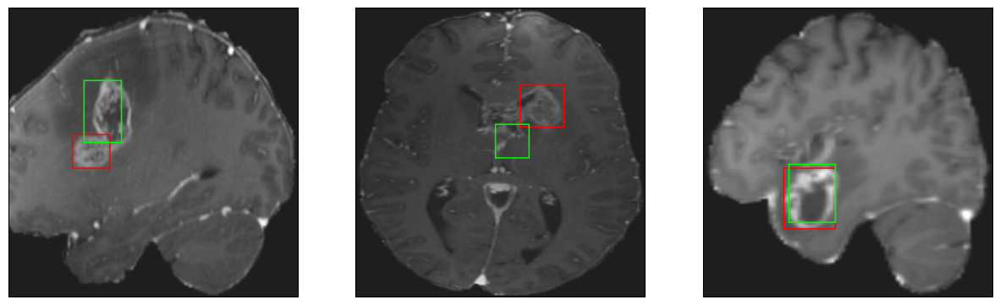

26/26 [==============================] - 8s 295ms/step - loss: 6.5328 - IoU: 0.5334 - val_loss: 8.8957 - val_IoU: 0.4801
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.6238 - IoU: 0.5370
Epoch 102: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


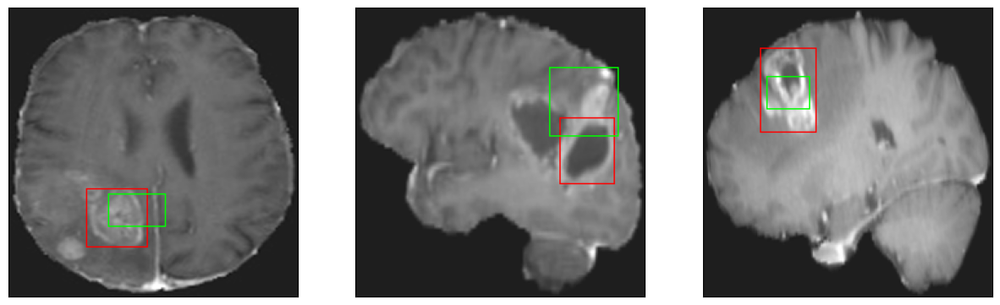

26/26 [==============================] - 7s 290ms/step - loss: 6.6238 - IoU: 0.5370 - val_loss: 13.2672 - val_IoU: 0.3574
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.0999 - IoU: 0.5560
Epoch 103: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


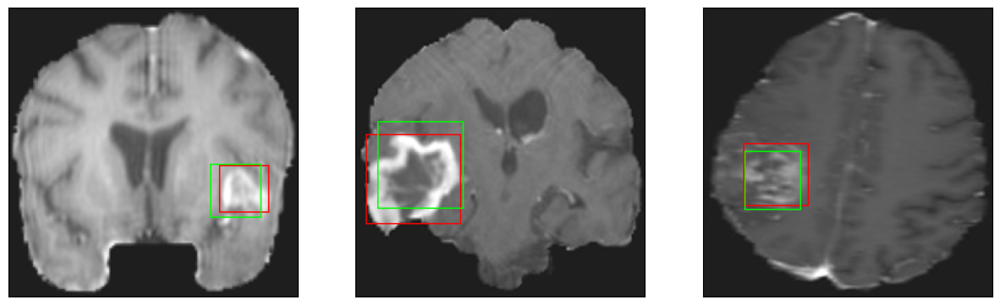

26/26 [==============================] - 8s 306ms/step - loss: 6.0999 - IoU: 0.5560 - val_loss: 8.4806 - val_IoU: 0.5101
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.1204 - IoU: 0.5620
Epoch 104: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


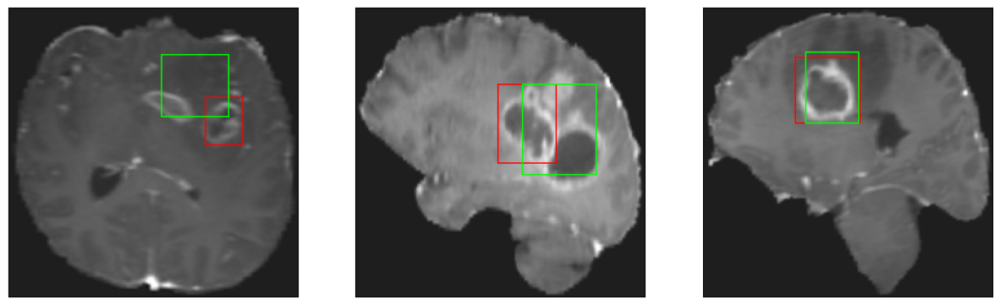

26/26 [==============================] - 8s 289ms/step - loss: 6.1204 - IoU: 0.5620 - val_loss: 8.1062 - val_IoU: 0.5381
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.3879 - IoU: 0.5374
Epoch 105: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 49ms/step
4


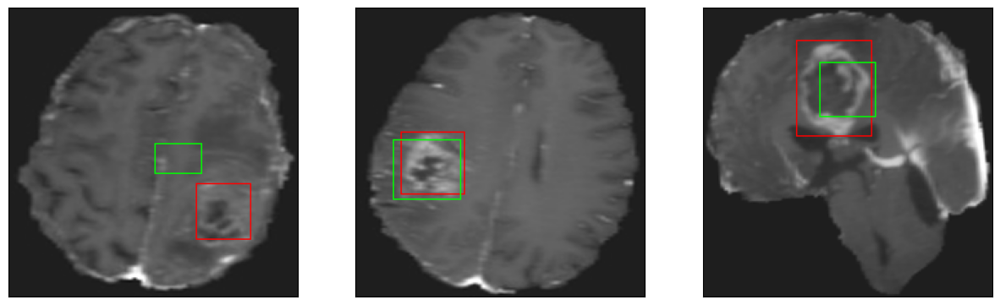

26/26 [==============================] - 8s 311ms/step - loss: 6.3879 - IoU: 0.5374 - val_loss: 9.4475 - val_IoU: 0.4816
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.4135 - IoU: 0.5376
Epoch 106: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


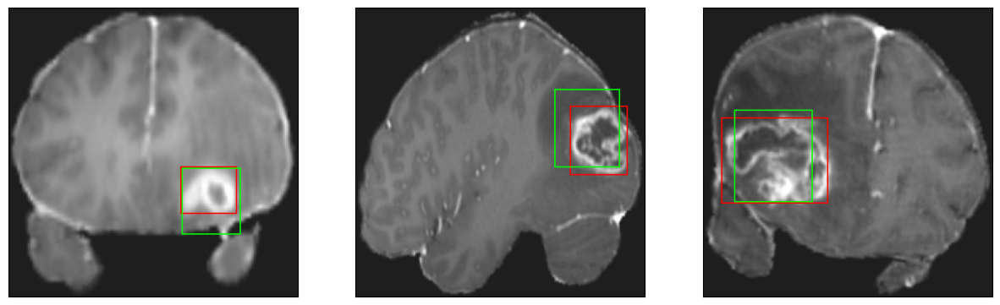

26/26 [==============================] - 8s 303ms/step - loss: 6.4135 - IoU: 0.5376 - val_loss: 9.0890 - val_IoU: 0.4683
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.3295 - IoU: 0.5413
Epoch 107: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


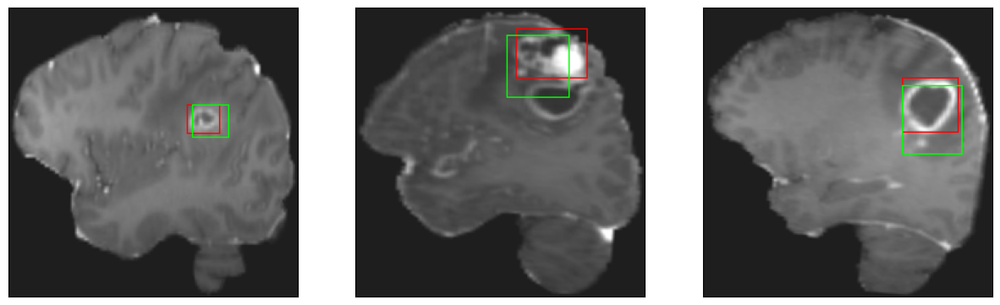

26/26 [==============================] - 8s 305ms/step - loss: 6.3295 - IoU: 0.5413 - val_loss: 9.2611 - val_IoU: 0.4804
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.3101 - IoU: 0.5481
Epoch 108: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


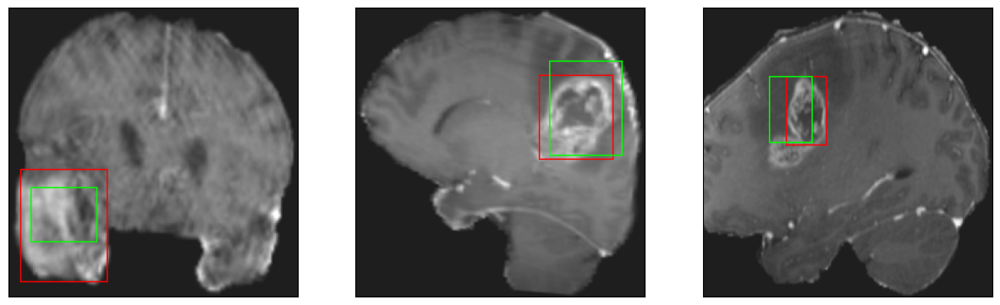

26/26 [==============================] - 8s 295ms/step - loss: 6.3101 - IoU: 0.5481 - val_loss: 8.5219 - val_IoU: 0.4971
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.1682 - IoU: 0.5591
Epoch 109: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


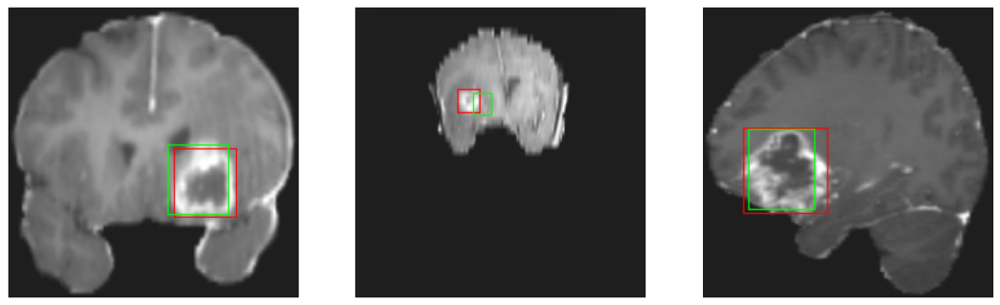

26/26 [==============================] - 8s 311ms/step - loss: 6.1682 - IoU: 0.5591 - val_loss: 9.3530 - val_IoU: 0.4841
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.1981 - IoU: 0.5539
Epoch 110: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


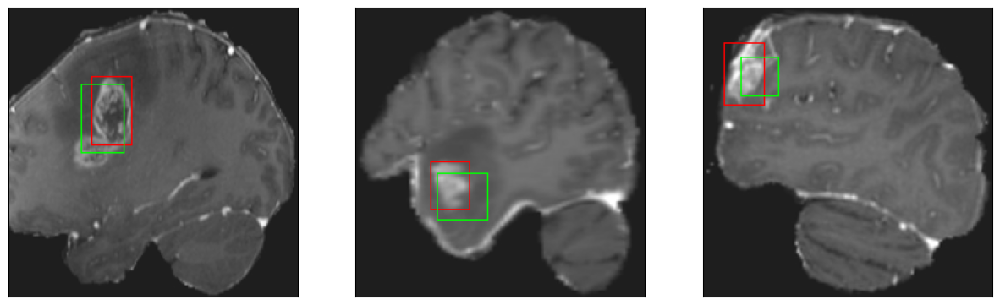

26/26 [==============================] - 8s 298ms/step - loss: 6.1981 - IoU: 0.5539 - val_loss: 10.0298 - val_IoU: 0.4515
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.3432 - IoU: 0.5513
Epoch 111: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


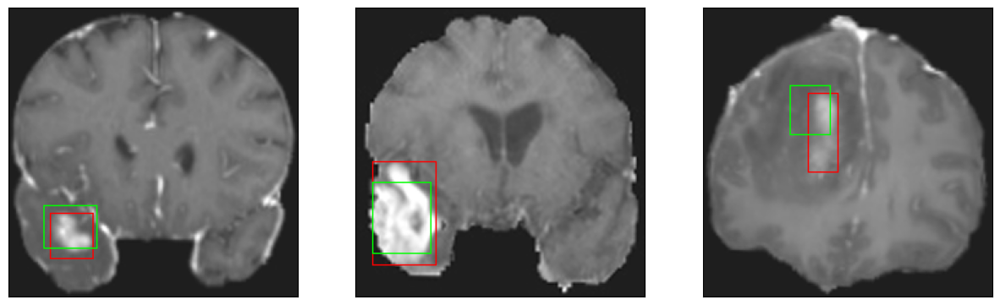

26/26 [==============================] - 8s 306ms/step - loss: 6.3432 - IoU: 0.5513 - val_loss: 9.2657 - val_IoU: 0.4598
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.1411 - IoU: 0.5618
Epoch 112: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


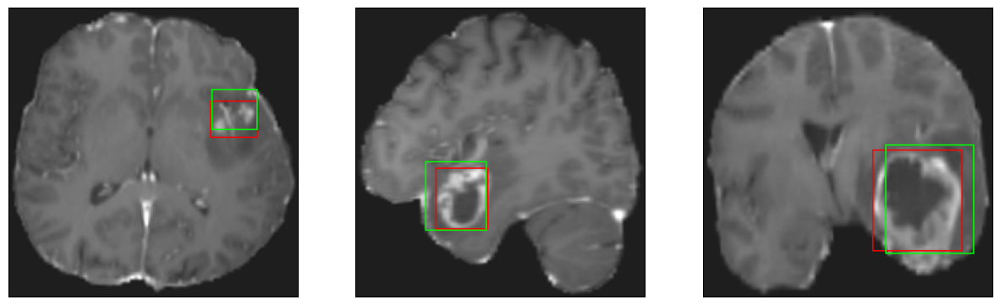

26/26 [==============================] - 8s 298ms/step - loss: 6.1411 - IoU: 0.5618 - val_loss: 9.1157 - val_IoU: 0.5152
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.5155 - IoU: 0.5325
Epoch 113: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


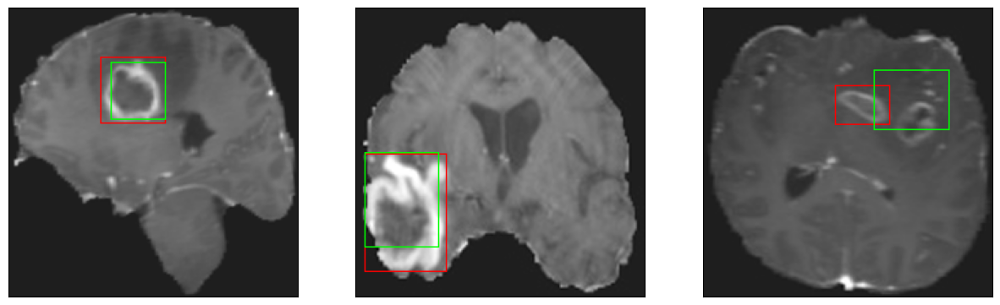

26/26 [==============================] - 7s 271ms/step - loss: 6.5155 - IoU: 0.5325 - val_loss: 8.7266 - val_IoU: 0.4968
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.2635 - IoU: 0.5563
Epoch 114: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


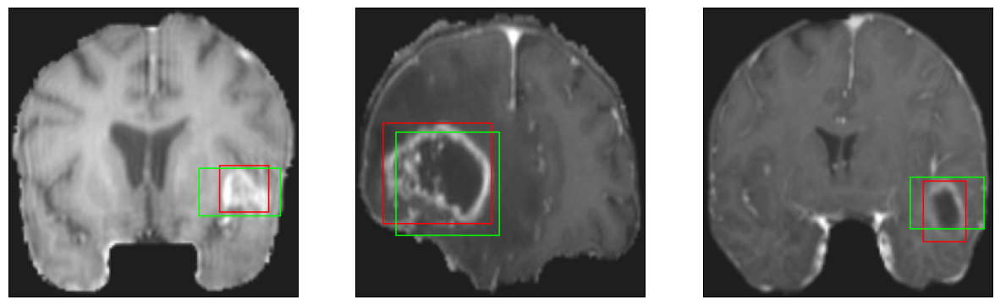

26/26 [==============================] - 8s 311ms/step - loss: 6.2635 - IoU: 0.5563 - val_loss: 8.2180 - val_IoU: 0.5193
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 5.8096 - IoU: 0.5814
Epoch 115: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


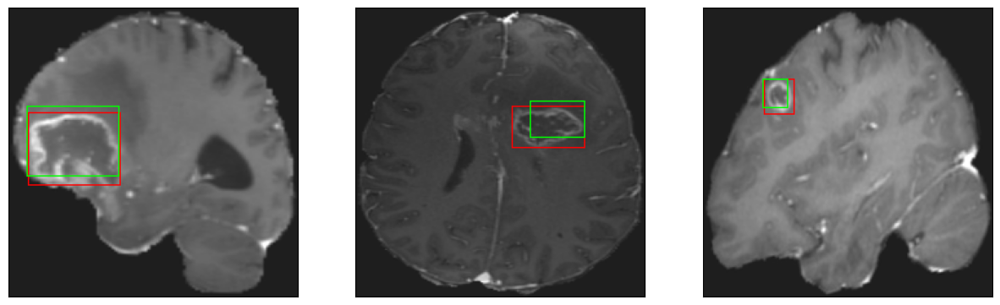

26/26 [==============================] - 8s 302ms/step - loss: 5.8096 - IoU: 0.5814 - val_loss: 8.5714 - val_IoU: 0.4838
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 5.7451 - IoU: 0.5765
Epoch 116: val_loss did not improve from 8.04455
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


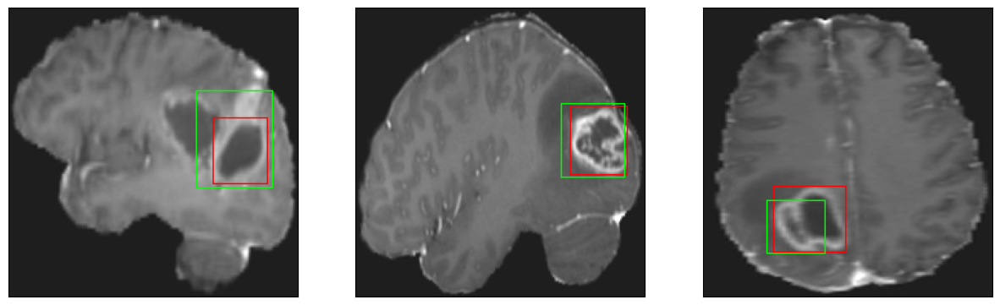

26/26 [==============================] - 7s 287ms/step - loss: 5.7451 - IoU: 0.5765 - val_loss: 8.8960 - val_IoU: 0.4938
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.2075 - IoU: 0.5604
Epoch 117: val_loss improved from 8.04455 to 8.00193, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


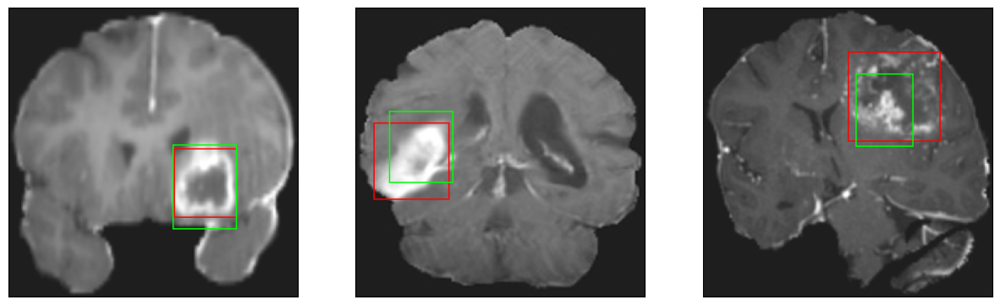

26/26 [==============================] - 15s 605ms/step - loss: 6.2075 - IoU: 0.5604 - val_loss: 8.0019 - val_IoU: 0.5382
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.3475 - IoU: 0.5455
Epoch 118: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


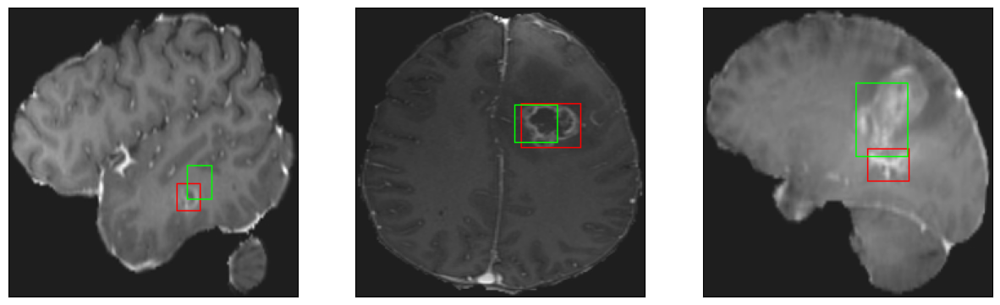

26/26 [==============================] - 7s 285ms/step - loss: 6.3475 - IoU: 0.5455 - val_loss: 8.2192 - val_IoU: 0.5190
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.3641 - IoU: 0.5335
Epoch 119: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


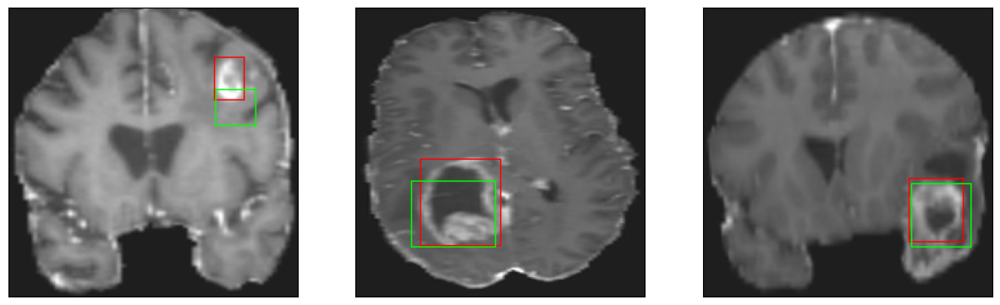

26/26 [==============================] - 8s 302ms/step - loss: 6.3641 - IoU: 0.5335 - val_loss: 8.0779 - val_IoU: 0.5060
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.2403 - IoU: 0.5514
Epoch 120: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


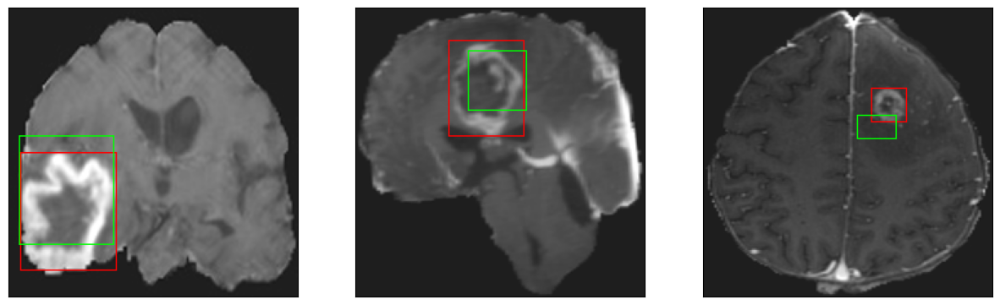

26/26 [==============================] - 7s 284ms/step - loss: 6.2403 - IoU: 0.5514 - val_loss: 10.0578 - val_IoU: 0.4560
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.5371 - IoU: 0.5369
Epoch 121: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


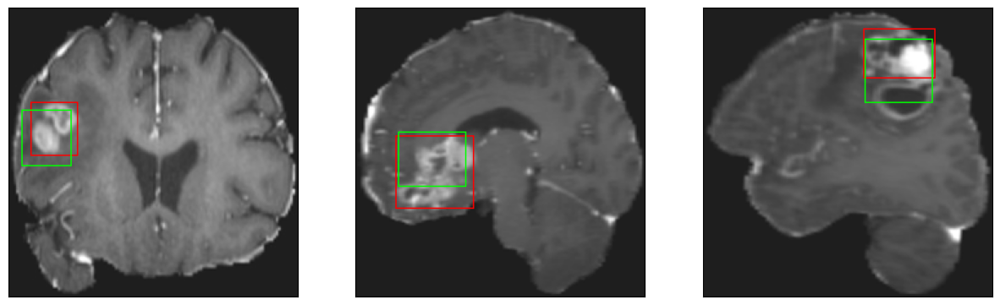

26/26 [==============================] - 8s 313ms/step - loss: 6.5371 - IoU: 0.5369 - val_loss: 8.1260 - val_IoU: 0.5268
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.0335 - IoU: 0.5600
Epoch 122: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


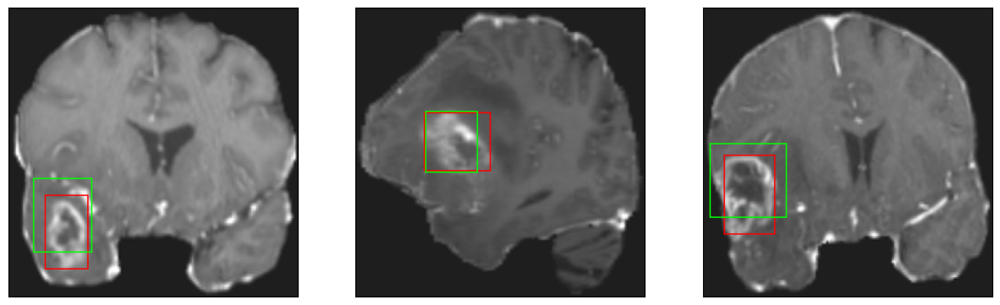

26/26 [==============================] - 8s 292ms/step - loss: 6.0335 - IoU: 0.5600 - val_loss: 8.4831 - val_IoU: 0.4835
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.2170 - IoU: 0.5413
Epoch 123: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


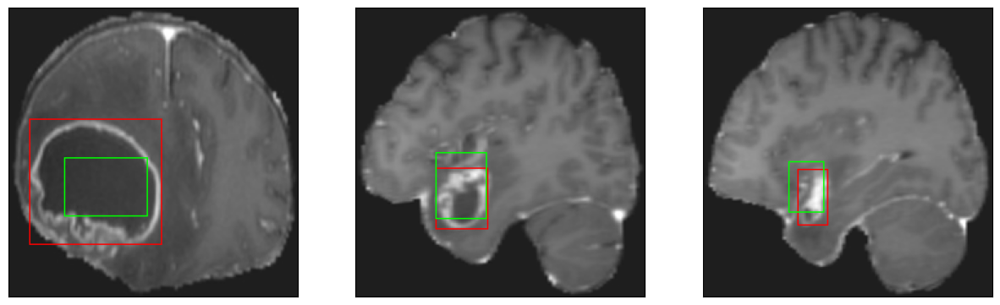

26/26 [==============================] - 8s 313ms/step - loss: 6.2170 - IoU: 0.5413 - val_loss: 9.6169 - val_IoU: 0.4063
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 6.1449 - IoU: 0.5473
Epoch 124: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


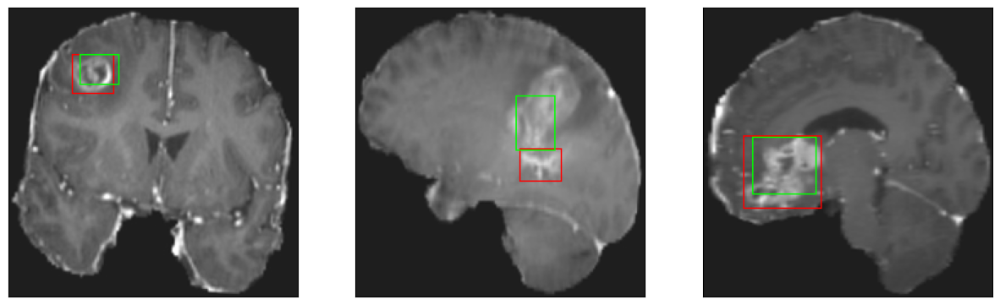

26/26 [==============================] - 8s 309ms/step - loss: 6.1449 - IoU: 0.5473 - val_loss: 8.1657 - val_IoU: 0.5188
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 6.0507 - IoU: 0.5547
Epoch 125: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


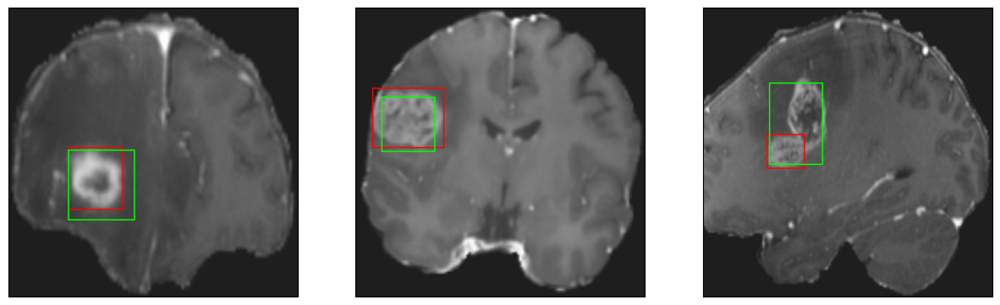

26/26 [==============================] - 8s 299ms/step - loss: 6.0507 - IoU: 0.5547 - val_loss: 8.9185 - val_IoU: 0.5226
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.1329 - IoU: 0.5492
Epoch 126: val_loss did not improve from 8.00193
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


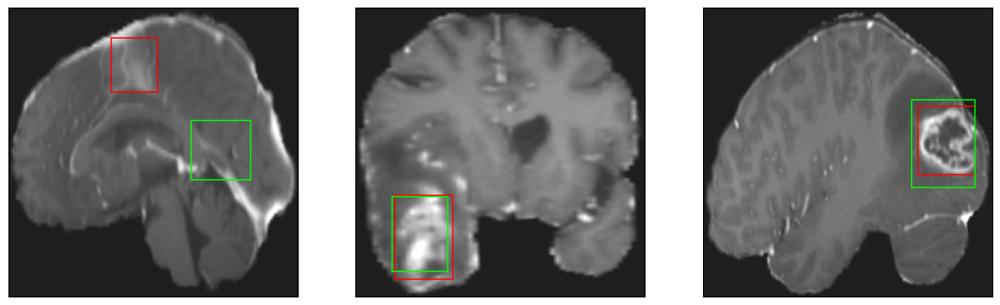

26/26 [==============================] - 8s 298ms/step - loss: 6.1329 - IoU: 0.5492 - val_loss: 8.0906 - val_IoU: 0.5544
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 5.9676 - IoU: 0.5640
Epoch 127: val_loss improved from 8.00193 to 7.59695, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


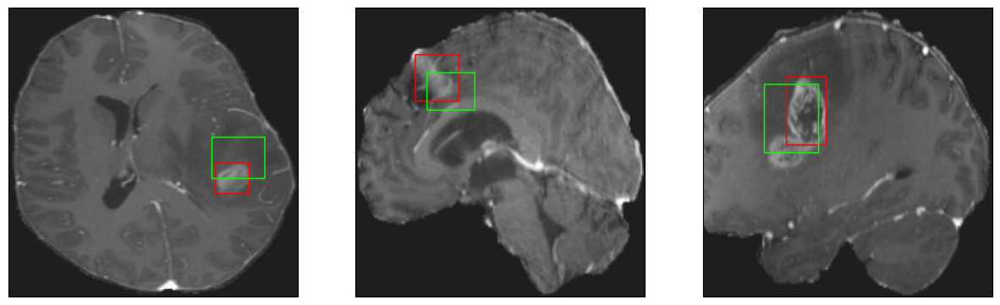

26/26 [==============================] - 14s 571ms/step - loss: 5.9676 - IoU: 0.5640 - val_loss: 7.5970 - val_IoU: 0.5543
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 5.8886 - IoU: 0.5625
Epoch 128: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


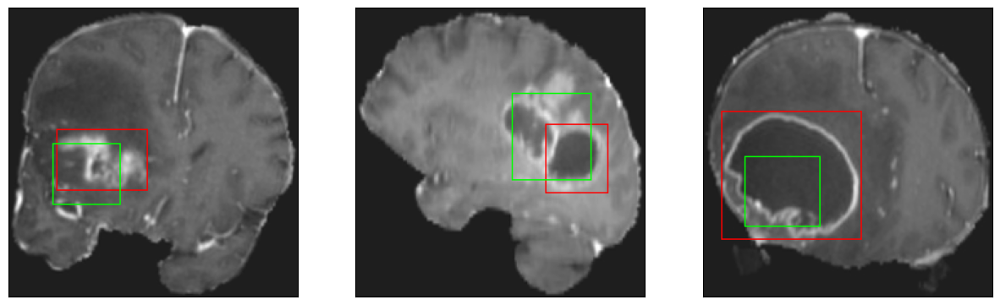

26/26 [==============================] - 7s 270ms/step - loss: 5.8886 - IoU: 0.5625 - val_loss: 8.4709 - val_IoU: 0.5087
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 6.0457 - IoU: 0.5605
Epoch 129: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


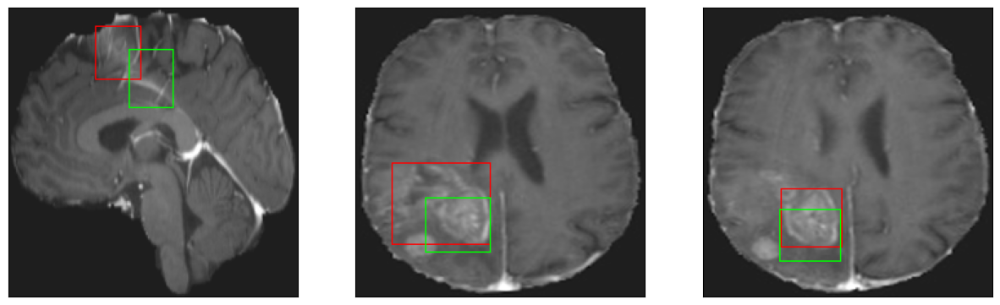

26/26 [==============================] - 8s 298ms/step - loss: 6.0457 - IoU: 0.5605 - val_loss: 8.1570 - val_IoU: 0.5247
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.9511 - IoU: 0.5609
Epoch 130: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


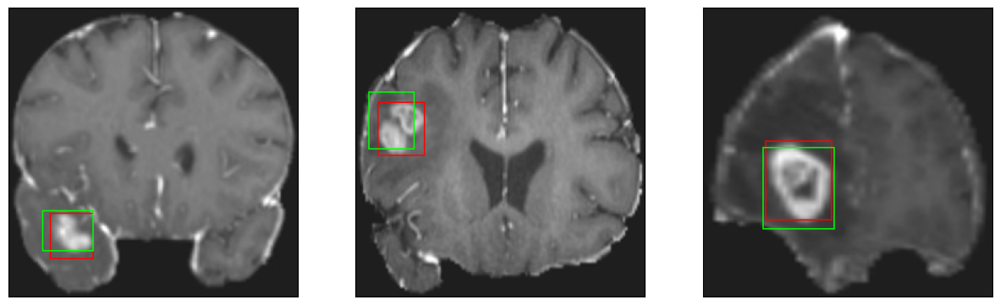

26/26 [==============================] - 7s 287ms/step - loss: 5.9511 - IoU: 0.5609 - val_loss: 8.3006 - val_IoU: 0.5092
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 5.9514 - IoU: 0.5610
Epoch 131: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


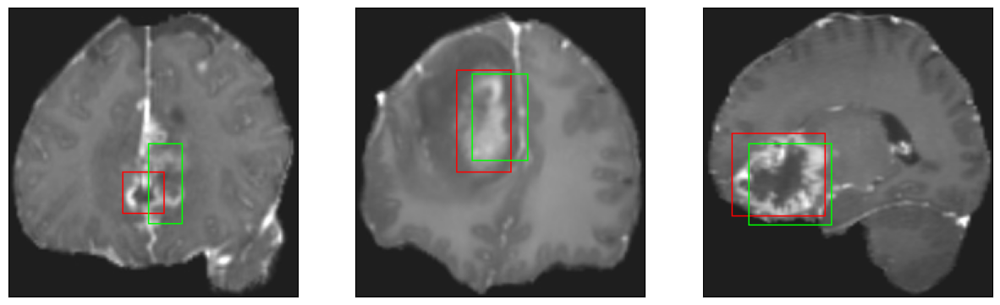

26/26 [==============================] - 7s 275ms/step - loss: 5.9514 - IoU: 0.5610 - val_loss: 8.8559 - val_IoU: 0.4870
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.7453 - IoU: 0.5744
Epoch 132: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


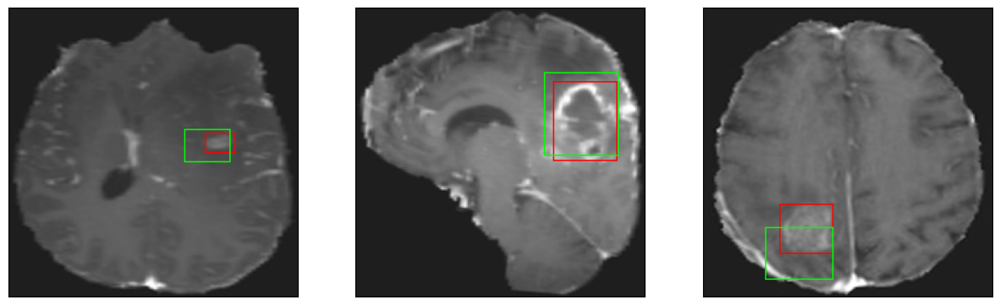

26/26 [==============================] - 8s 300ms/step - loss: 5.7453 - IoU: 0.5744 - val_loss: 8.0948 - val_IoU: 0.5289
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 6.0803 - IoU: 0.5630
Epoch 133: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


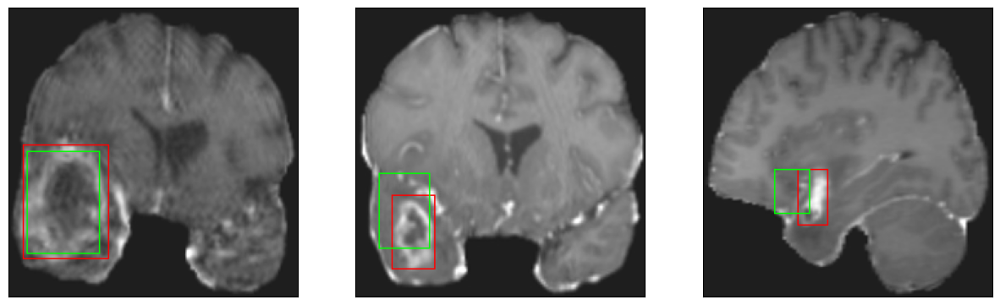

26/26 [==============================] - 8s 304ms/step - loss: 6.0803 - IoU: 0.5630 - val_loss: 9.0129 - val_IoU: 0.4696
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.8699 - IoU: 0.5657
Epoch 134: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


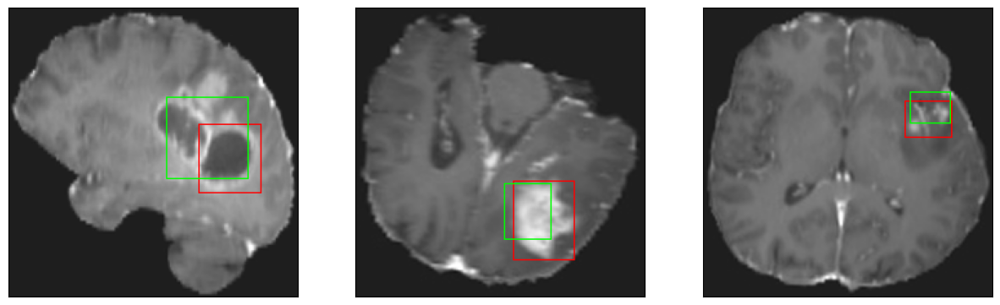

26/26 [==============================] - 8s 310ms/step - loss: 5.8699 - IoU: 0.5657 - val_loss: 7.6632 - val_IoU: 0.5577
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.7216 - IoU: 0.5715
Epoch 135: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


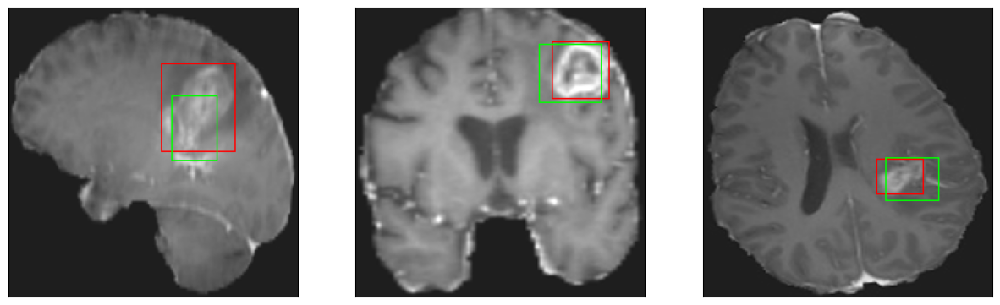

26/26 [==============================] - 8s 302ms/step - loss: 5.7216 - IoU: 0.5715 - val_loss: 7.8804 - val_IoU: 0.5629
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 6.0116 - IoU: 0.5541
Epoch 136: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


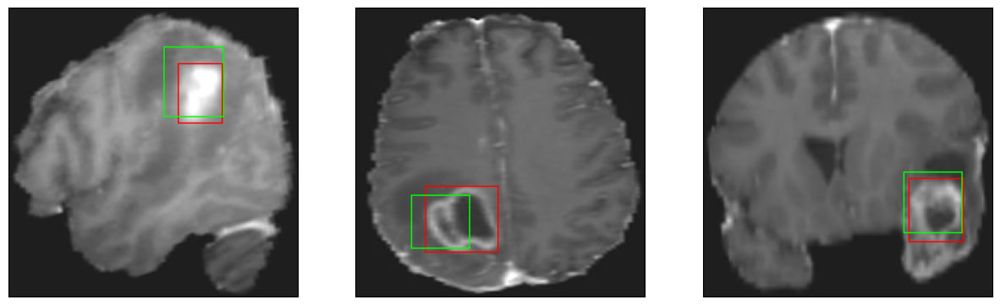

26/26 [==============================] - 8s 319ms/step - loss: 6.0116 - IoU: 0.5541 - val_loss: 8.8626 - val_IoU: 0.4959
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.9458 - IoU: 0.5623
Epoch 137: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


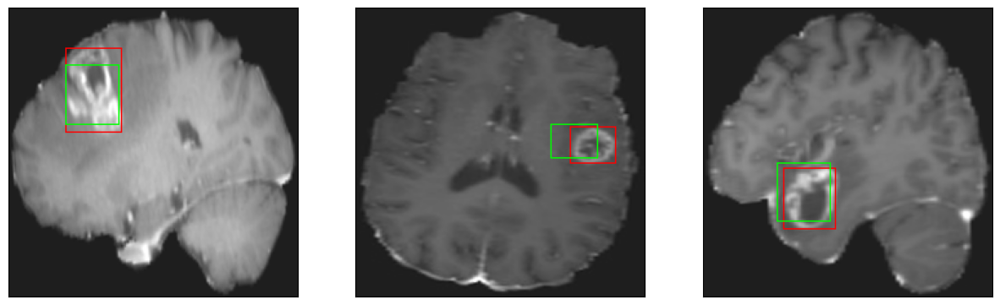

26/26 [==============================] - 8s 325ms/step - loss: 5.9458 - IoU: 0.5623 - val_loss: 9.2897 - val_IoU: 0.4596
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.8155 - IoU: 0.5640
Epoch 138: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


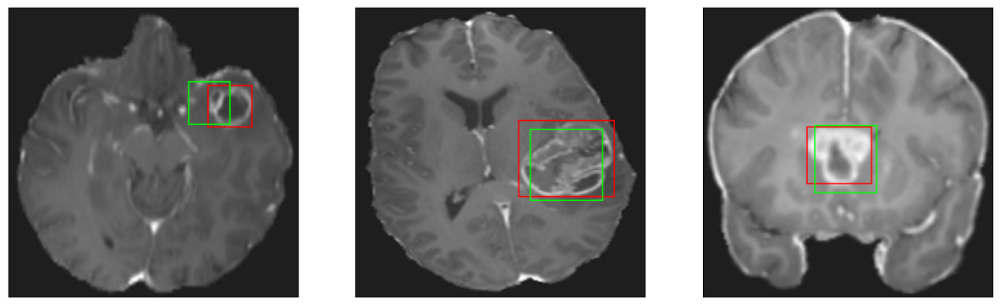

26/26 [==============================] - 7s 278ms/step - loss: 5.8155 - IoU: 0.5640 - val_loss: 7.9545 - val_IoU: 0.5427
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.3422 - IoU: 0.6025
Epoch 139: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


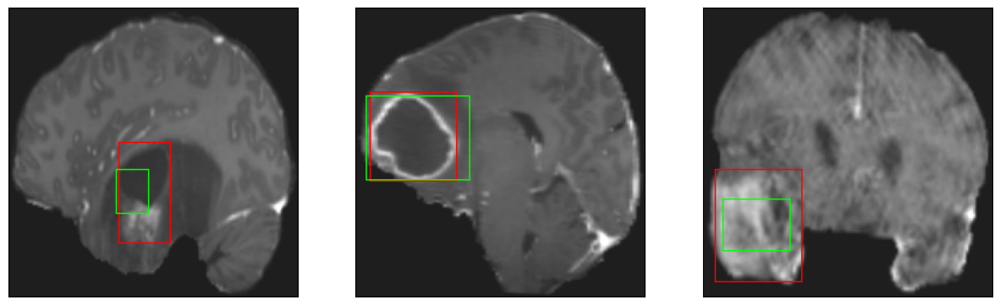

26/26 [==============================] - 8s 291ms/step - loss: 5.3422 - IoU: 0.6025 - val_loss: 7.8803 - val_IoU: 0.5437
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.6051 - IoU: 0.5747
Epoch 140: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


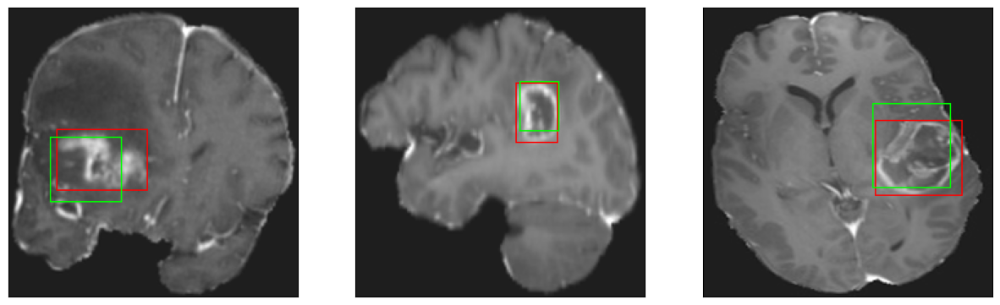

26/26 [==============================] - 8s 314ms/step - loss: 5.6051 - IoU: 0.5747 - val_loss: 7.8086 - val_IoU: 0.5384
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.8916 - IoU: 0.5645
Epoch 141: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


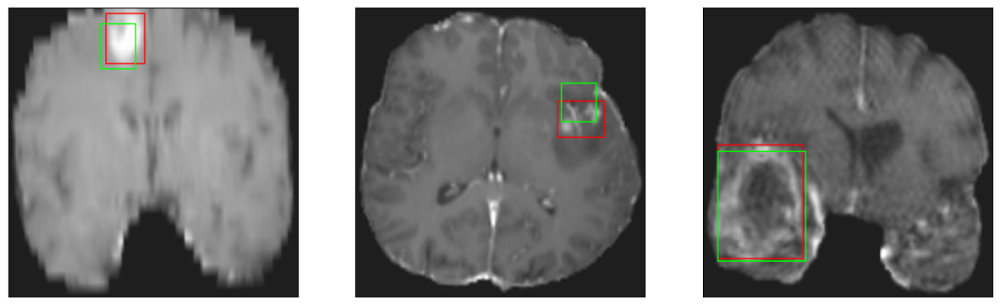

26/26 [==============================] - 8s 309ms/step - loss: 5.8916 - IoU: 0.5645 - val_loss: 7.7425 - val_IoU: 0.5379
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.9927 - IoU: 0.5645
Epoch 142: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 44ms/step
4


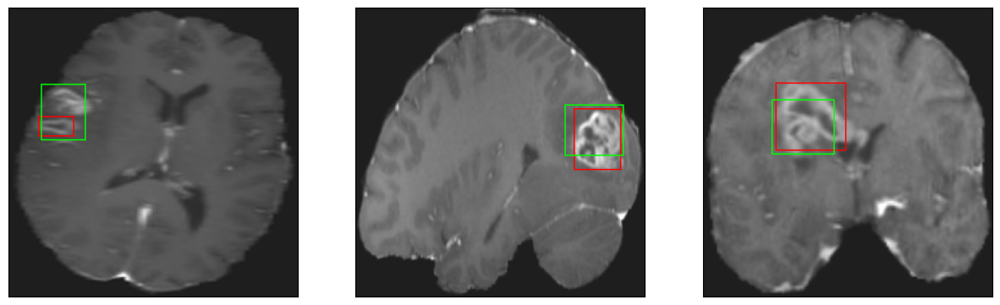

26/26 [==============================] - 8s 292ms/step - loss: 5.9927 - IoU: 0.5645 - val_loss: 8.3526 - val_IoU: 0.5256
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 6.0067 - IoU: 0.5530
Epoch 143: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


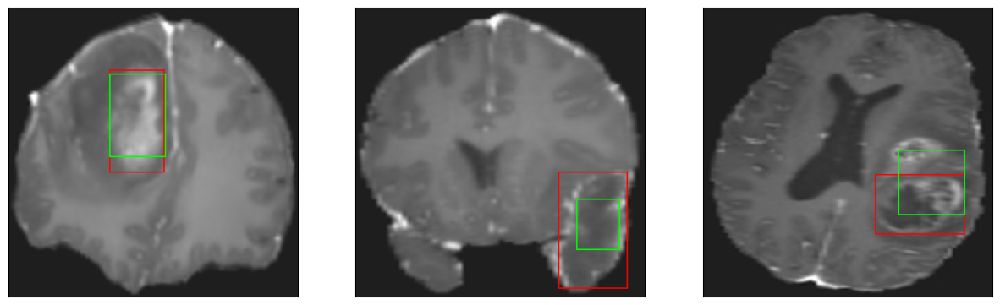

26/26 [==============================] - 8s 296ms/step - loss: 6.0067 - IoU: 0.5530 - val_loss: 7.7982 - val_IoU: 0.5547
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.7684 - IoU: 0.5760
Epoch 144: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


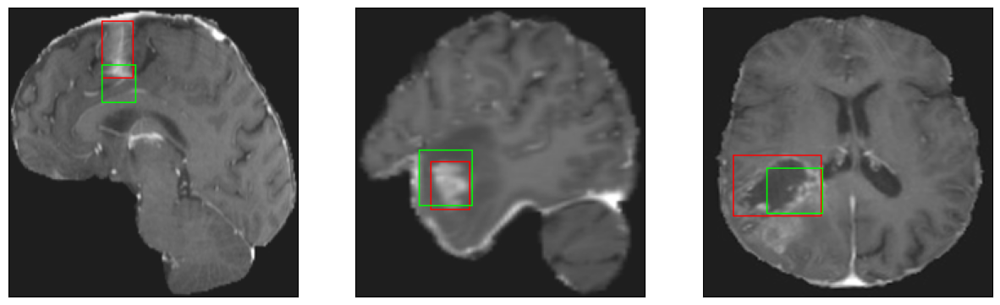

26/26 [==============================] - 7s 286ms/step - loss: 5.7684 - IoU: 0.5760 - val_loss: 8.0096 - val_IoU: 0.5259
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.9951 - IoU: 0.5567
Epoch 145: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


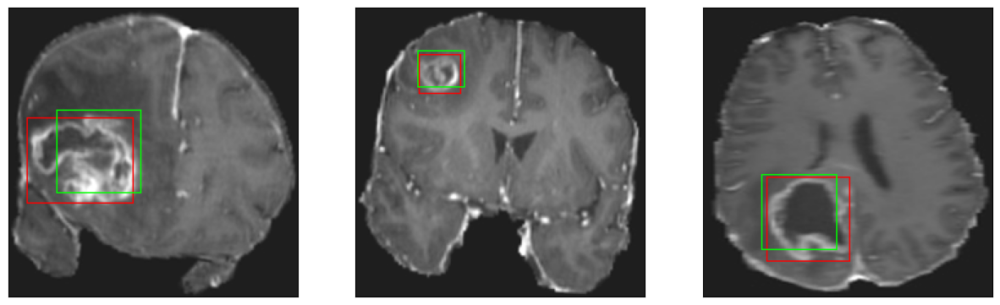

26/26 [==============================] - 8s 304ms/step - loss: 5.9951 - IoU: 0.5567 - val_loss: 7.9089 - val_IoU: 0.4971
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.8375 - IoU: 0.5628
Epoch 146: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


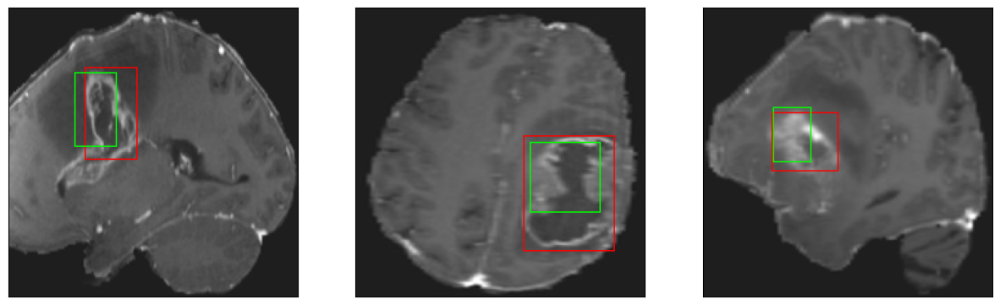

26/26 [==============================] - 7s 291ms/step - loss: 5.8375 - IoU: 0.5628 - val_loss: 8.1476 - val_IoU: 0.5118
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 6.3449 - IoU: 0.5546
Epoch 147: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


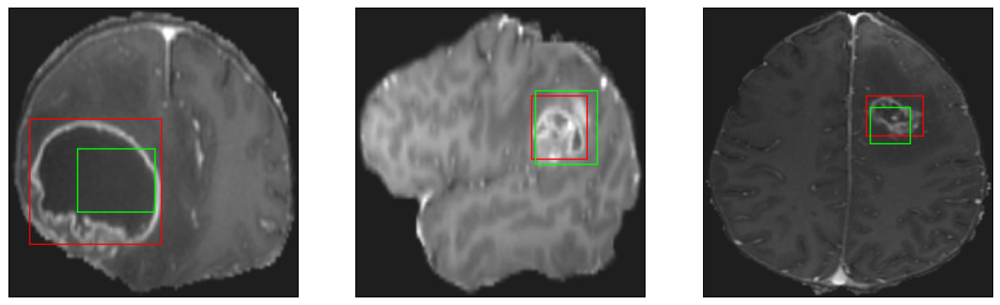

26/26 [==============================] - 8s 308ms/step - loss: 6.3449 - IoU: 0.5546 - val_loss: 8.3419 - val_IoU: 0.5055
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.7616 - IoU: 0.5772
Epoch 148: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


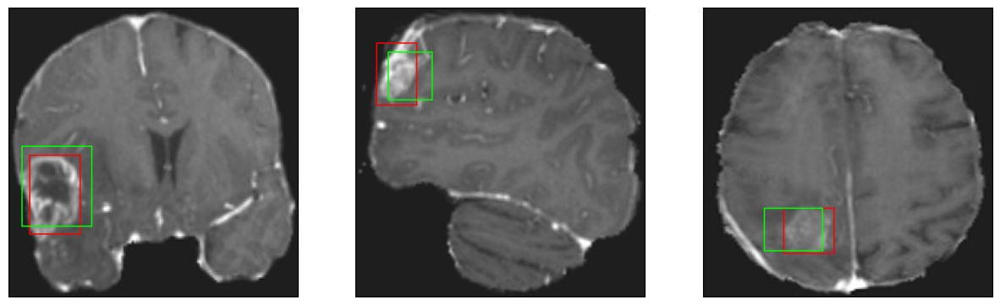

26/26 [==============================] - 8s 302ms/step - loss: 5.7616 - IoU: 0.5772 - val_loss: 8.0738 - val_IoU: 0.5306
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.7628 - IoU: 0.5785
Epoch 149: val_loss did not improve from 7.59695
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


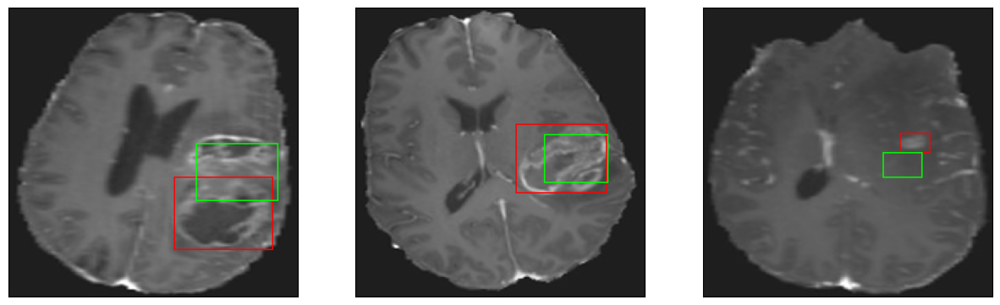

26/26 [==============================] - 7s 277ms/step - loss: 5.7628 - IoU: 0.5785 - val_loss: 7.8987 - val_IoU: 0.5398
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.4784 - IoU: 0.5840
Epoch 150: val_loss improved from 7.59695 to 7.43654, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


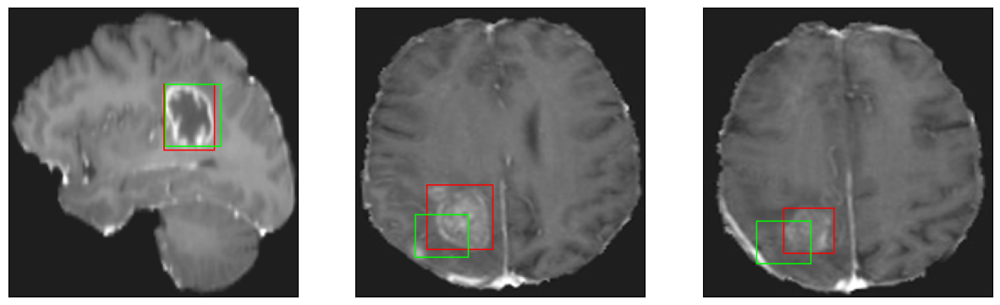

26/26 [==============================] - 14s 567ms/step - loss: 5.4784 - IoU: 0.5840 - val_loss: 7.4365 - val_IoU: 0.5774
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.6341 - IoU: 0.5791
Epoch 151: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


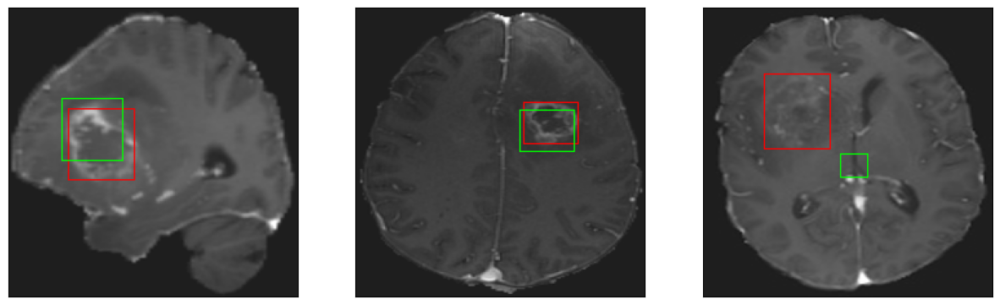

26/26 [==============================] - 8s 308ms/step - loss: 5.6341 - IoU: 0.5791 - val_loss: 8.0761 - val_IoU: 0.5407
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 6.0150 - IoU: 0.5642
Epoch 152: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


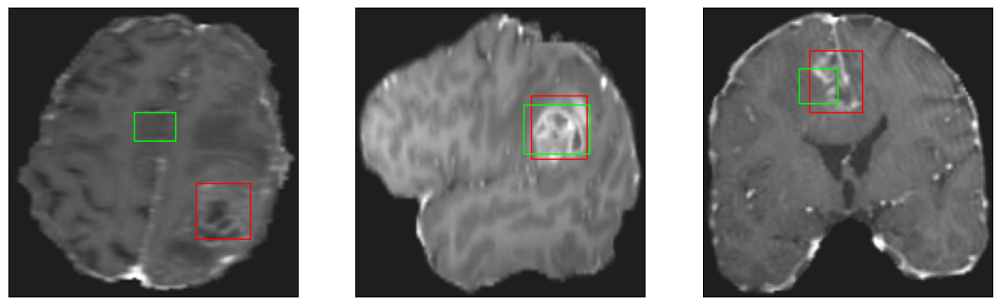

26/26 [==============================] - 8s 309ms/step - loss: 6.0150 - IoU: 0.5642 - val_loss: 8.3382 - val_IoU: 0.5285
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 6.1786 - IoU: 0.5592
Epoch 153: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


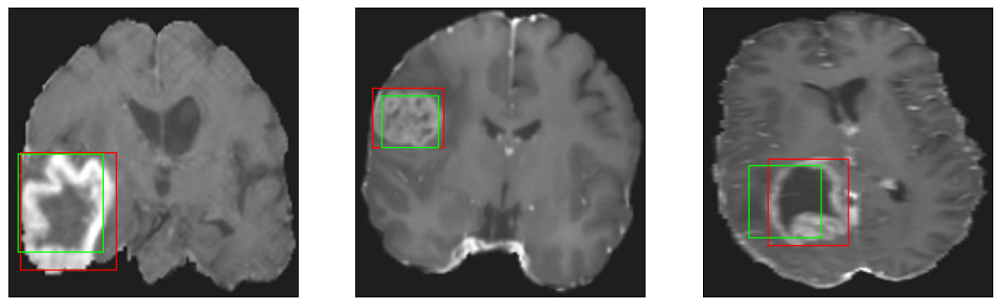

26/26 [==============================] - 8s 298ms/step - loss: 6.1786 - IoU: 0.5592 - val_loss: 8.0903 - val_IoU: 0.5347
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.6033 - IoU: 0.5804
Epoch 154: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


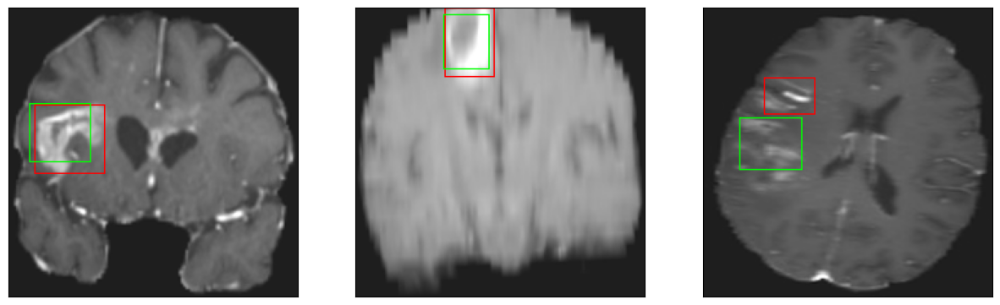

26/26 [==============================] - 8s 300ms/step - loss: 5.6033 - IoU: 0.5804 - val_loss: 8.8222 - val_IoU: 0.4869
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.6293 - IoU: 0.5770
Epoch 155: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


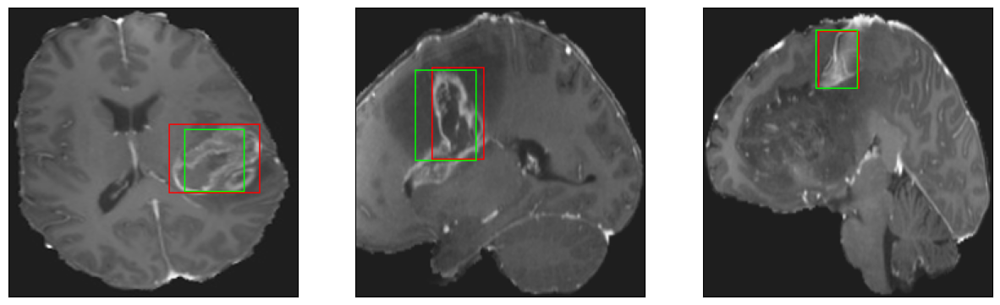

26/26 [==============================] - 8s 305ms/step - loss: 5.6293 - IoU: 0.5770 - val_loss: 7.8958 - val_IoU: 0.5354
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.6465 - IoU: 0.5788
Epoch 156: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


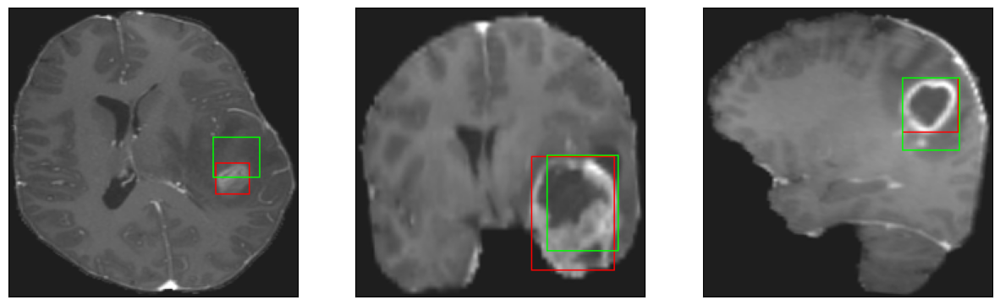

26/26 [==============================] - 8s 312ms/step - loss: 5.6465 - IoU: 0.5788 - val_loss: 7.8370 - val_IoU: 0.5330
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.5360 - IoU: 0.5840
Epoch 157: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


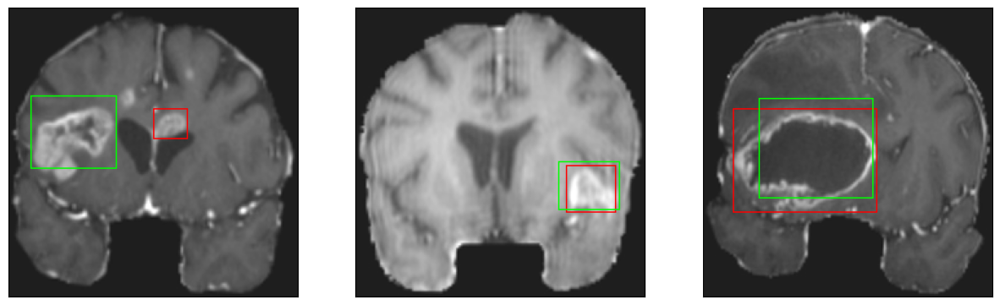

26/26 [==============================] - 8s 297ms/step - loss: 5.5360 - IoU: 0.5840 - val_loss: 7.7369 - val_IoU: 0.5447
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.2503 - IoU: 0.6024
Epoch 158: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


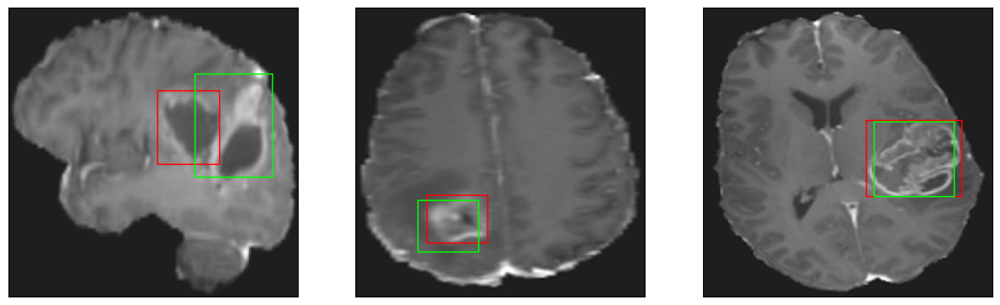

26/26 [==============================] - 7s 281ms/step - loss: 5.2503 - IoU: 0.6024 - val_loss: 8.1143 - val_IoU: 0.5230
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.6494 - IoU: 0.5876
Epoch 159: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


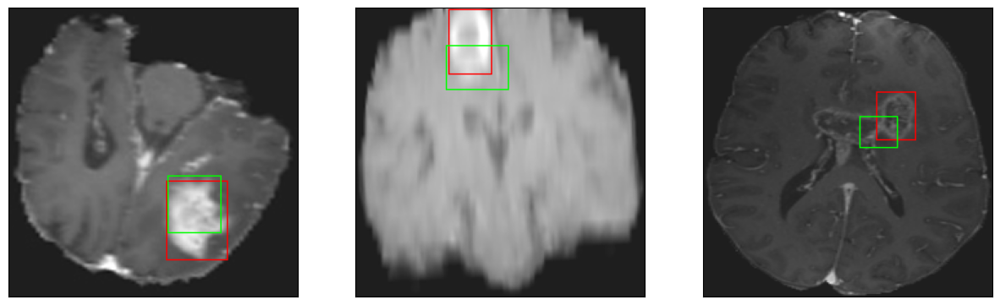

26/26 [==============================] - 8s 314ms/step - loss: 5.6494 - IoU: 0.5876 - val_loss: 8.8380 - val_IoU: 0.4953
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.8804 - IoU: 0.5655
Epoch 160: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


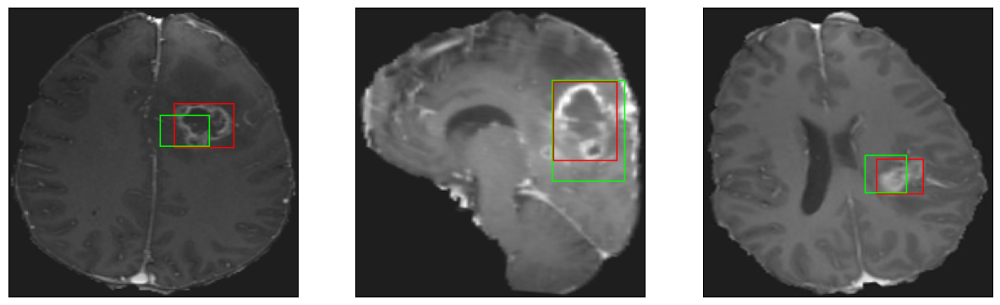

26/26 [==============================] - 8s 296ms/step - loss: 5.8804 - IoU: 0.5655 - val_loss: 8.5657 - val_IoU: 0.4971
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.6143 - IoU: 0.5733
Epoch 161: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


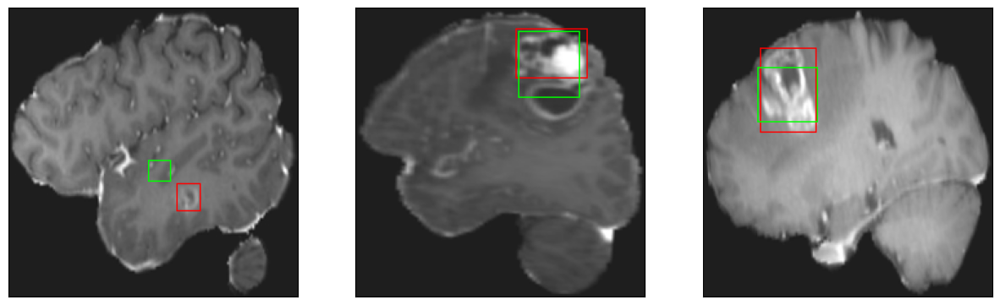

26/26 [==============================] - 7s 271ms/step - loss: 5.6143 - IoU: 0.5733 - val_loss: 8.0100 - val_IoU: 0.5216
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.8150 - IoU: 0.5716
Epoch 162: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


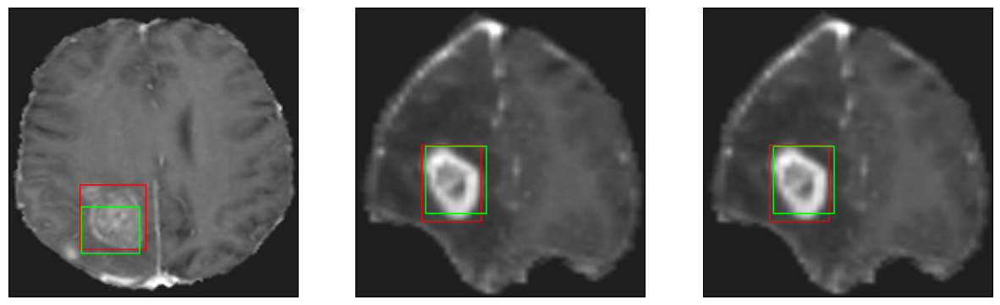

26/26 [==============================] - 8s 325ms/step - loss: 5.8150 - IoU: 0.5716 - val_loss: 8.3305 - val_IoU: 0.5192
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.5395 - IoU: 0.5785
Epoch 163: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


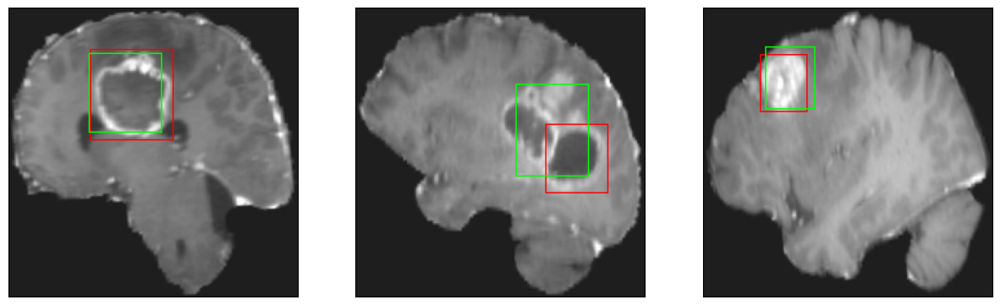

26/26 [==============================] - 8s 297ms/step - loss: 5.5395 - IoU: 0.5785 - val_loss: 7.8840 - val_IoU: 0.5390
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.4004 - IoU: 0.5911
Epoch 164: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


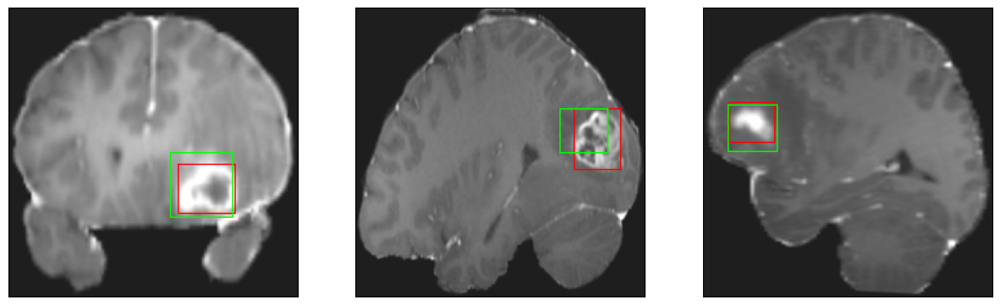

26/26 [==============================] - 8s 294ms/step - loss: 5.4004 - IoU: 0.5911 - val_loss: 8.3800 - val_IoU: 0.5195
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.5469 - IoU: 0.5804
Epoch 165: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


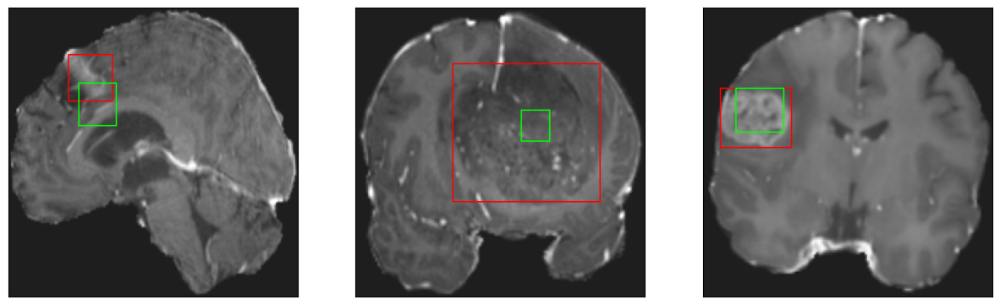

26/26 [==============================] - 8s 310ms/step - loss: 5.5469 - IoU: 0.5804 - val_loss: 8.7580 - val_IoU: 0.4735
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.2993 - IoU: 0.6017
Epoch 166: val_loss did not improve from 7.43654
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


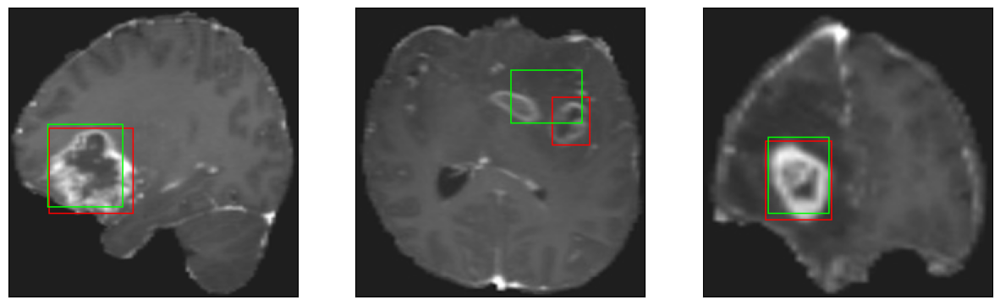

26/26 [==============================] - 8s 310ms/step - loss: 5.2993 - IoU: 0.6017 - val_loss: 8.1361 - val_IoU: 0.5269
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.7234 - IoU: 0.5803
Epoch 167: val_loss improved from 7.43654 to 7.31201, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


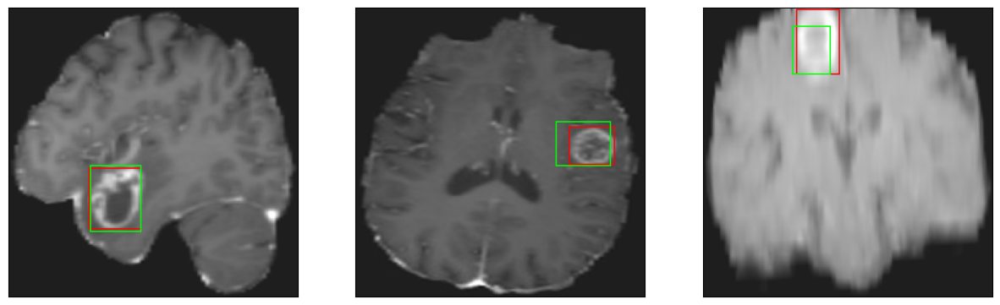

26/26 [==============================] - 15s 574ms/step - loss: 5.7234 - IoU: 0.5803 - val_loss: 7.3120 - val_IoU: 0.5767
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.0744 - IoU: 0.6049
Epoch 168: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


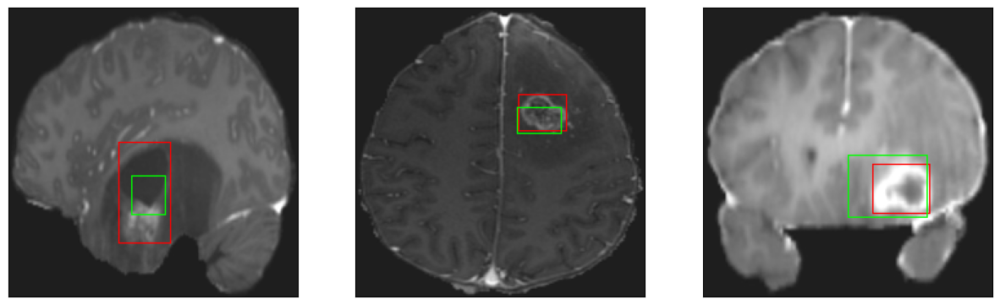

26/26 [==============================] - 8s 318ms/step - loss: 5.0744 - IoU: 0.6049 - val_loss: 8.1757 - val_IoU: 0.5196
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.5028 - IoU: 0.5912
Epoch 169: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


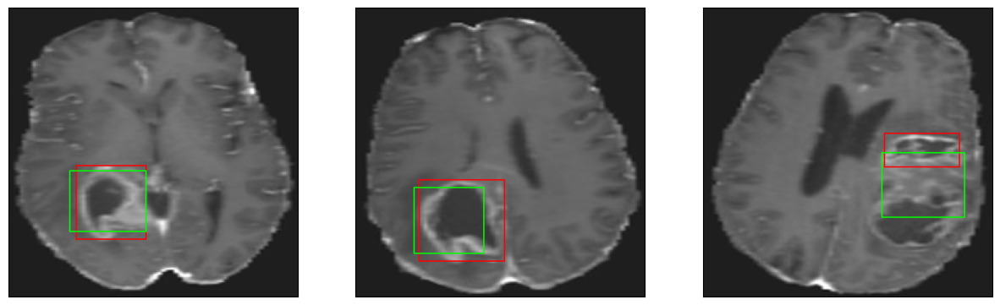

26/26 [==============================] - 8s 310ms/step - loss: 5.5028 - IoU: 0.5912 - val_loss: 7.3436 - val_IoU: 0.5729
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.2563 - IoU: 0.5955
Epoch 170: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


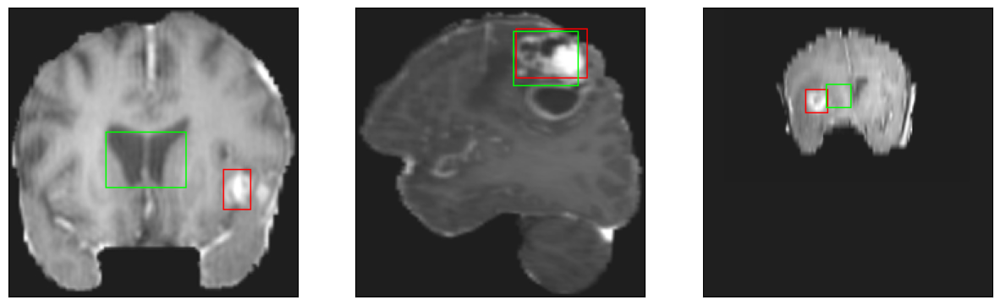

26/26 [==============================] - 8s 317ms/step - loss: 5.2563 - IoU: 0.5955 - val_loss: 9.3543 - val_IoU: 0.4399
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.4849 - IoU: 0.5862
Epoch 171: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


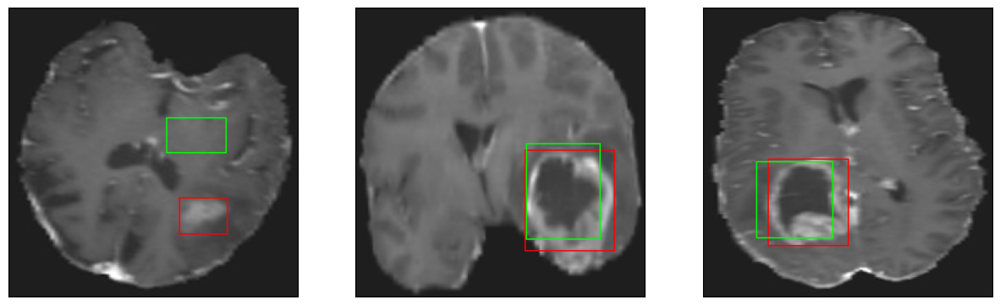

26/26 [==============================] - 8s 300ms/step - loss: 5.4849 - IoU: 0.5862 - val_loss: 8.0364 - val_IoU: 0.5351
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.5844 - IoU: 0.5899
Epoch 172: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


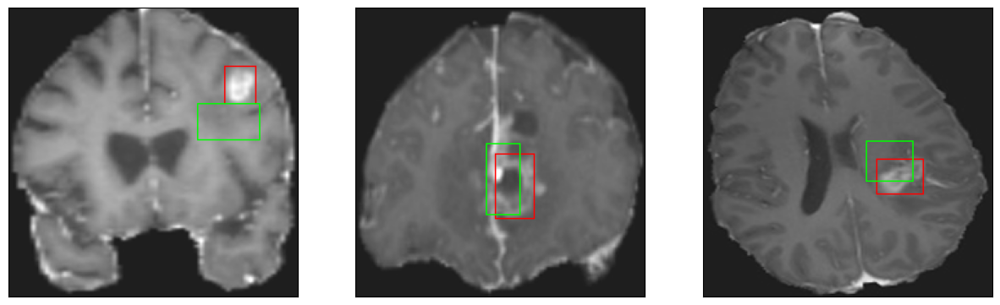

26/26 [==============================] - 8s 303ms/step - loss: 5.5844 - IoU: 0.5899 - val_loss: 8.3954 - val_IoU: 0.5175
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.6575 - IoU: 0.5757
Epoch 173: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


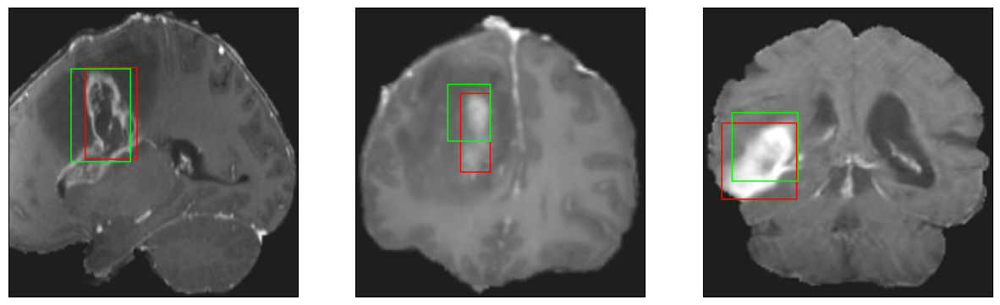

26/26 [==============================] - 8s 309ms/step - loss: 5.6575 - IoU: 0.5757 - val_loss: 7.6959 - val_IoU: 0.5609
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.5216 - IoU: 0.5841
Epoch 174: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


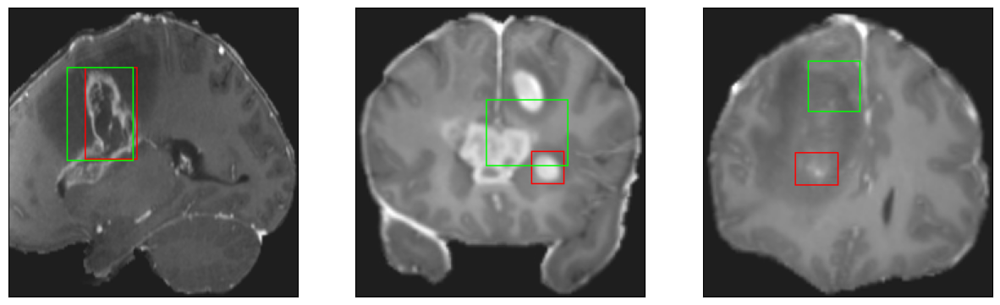

26/26 [==============================] - 8s 297ms/step - loss: 5.5216 - IoU: 0.5841 - val_loss: 8.1790 - val_IoU: 0.5263
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.5386 - IoU: 0.5863
Epoch 175: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


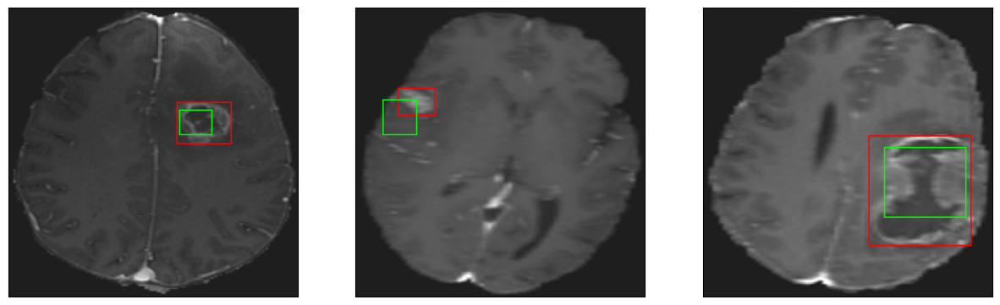

26/26 [==============================] - 8s 299ms/step - loss: 5.5386 - IoU: 0.5863 - val_loss: 8.5278 - val_IoU: 0.5179
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.3904 - IoU: 0.5943
Epoch 176: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


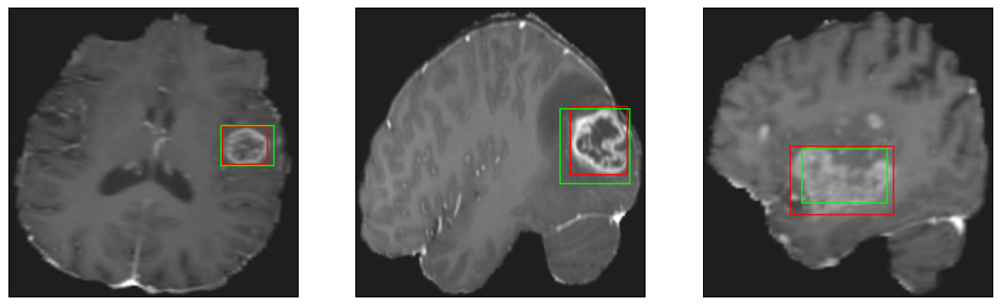

26/26 [==============================] - 8s 293ms/step - loss: 5.3904 - IoU: 0.5943 - val_loss: 7.6041 - val_IoU: 0.5687
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.5589 - IoU: 0.5900
Epoch 177: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


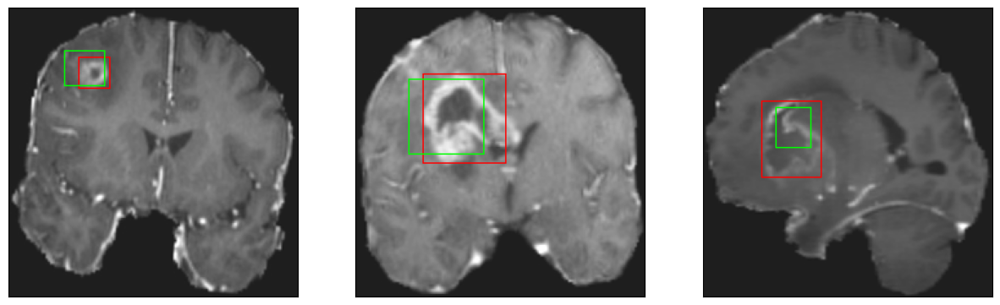

26/26 [==============================] - 8s 306ms/step - loss: 5.5589 - IoU: 0.5900 - val_loss: 8.1749 - val_IoU: 0.5159
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.3662 - IoU: 0.5992
Epoch 178: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


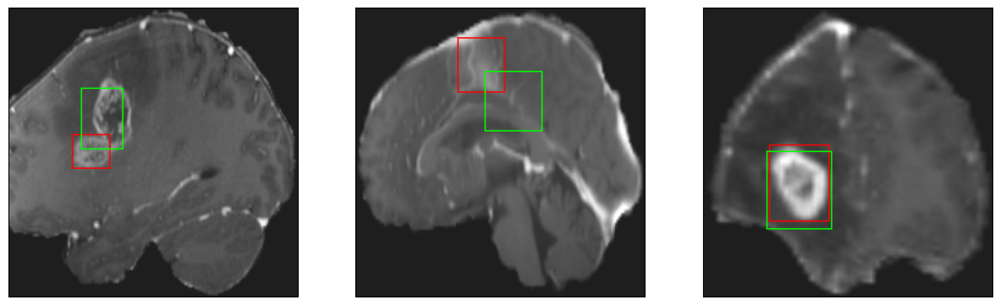

26/26 [==============================] - 8s 296ms/step - loss: 5.3662 - IoU: 0.5992 - val_loss: 7.8177 - val_IoU: 0.5536
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.6438 - IoU: 0.5741
Epoch 179: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


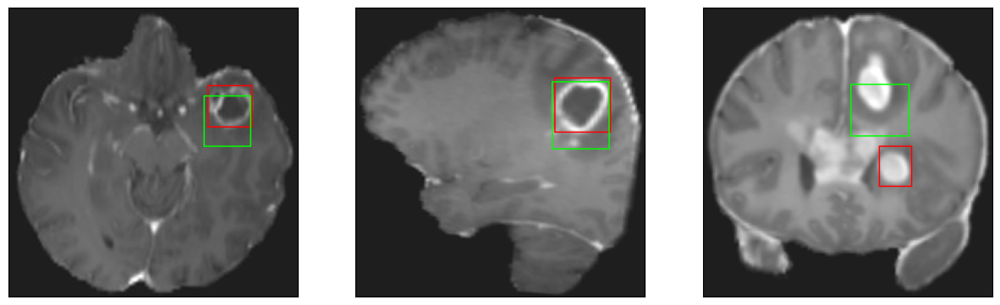

26/26 [==============================] - 8s 317ms/step - loss: 5.6438 - IoU: 0.5741 - val_loss: 8.1074 - val_IoU: 0.5224
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.5180 - IoU: 0.5857
Epoch 180: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


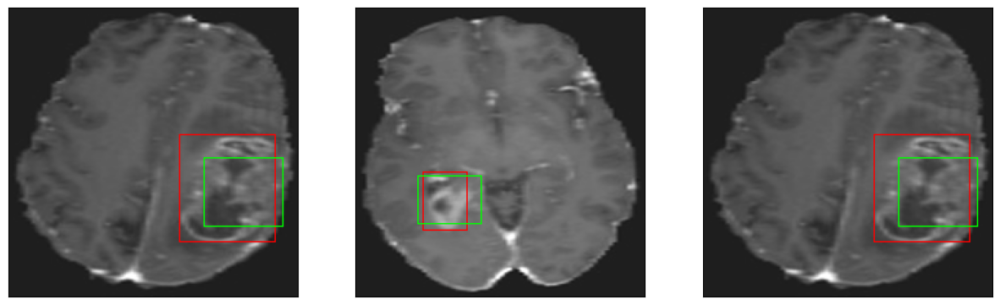

26/26 [==============================] - 7s 274ms/step - loss: 5.5180 - IoU: 0.5857 - val_loss: 7.8841 - val_IoU: 0.5665
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.3165 - IoU: 0.5982
Epoch 181: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


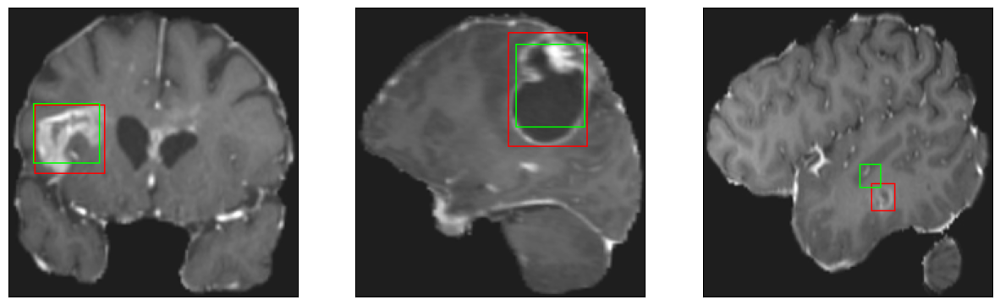

26/26 [==============================] - 8s 312ms/step - loss: 5.3165 - IoU: 0.5982 - val_loss: 7.9642 - val_IoU: 0.5443
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.7595 - IoU: 0.5763
Epoch 182: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


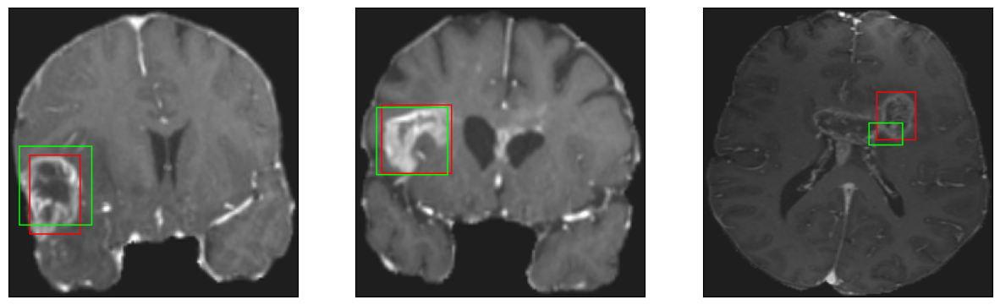

26/26 [==============================] - 8s 311ms/step - loss: 5.7595 - IoU: 0.5763 - val_loss: 7.7427 - val_IoU: 0.5601
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.1916 - IoU: 0.6113
Epoch 183: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


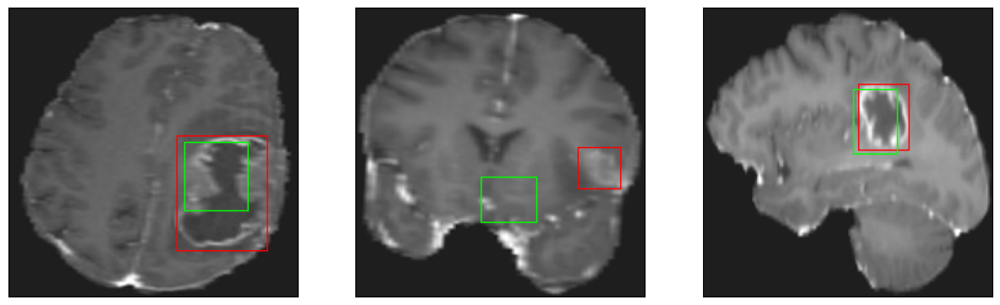

26/26 [==============================] - 8s 302ms/step - loss: 5.1916 - IoU: 0.6113 - val_loss: 7.4595 - val_IoU: 0.5548
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.4869 - IoU: 0.5907
Epoch 184: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


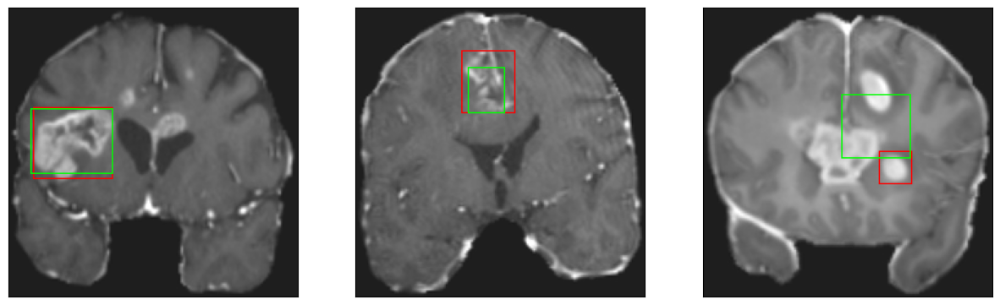

26/26 [==============================] - 7s 285ms/step - loss: 5.4869 - IoU: 0.5907 - val_loss: 8.0189 - val_IoU: 0.5322
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.4735 - IoU: 0.5868
Epoch 185: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


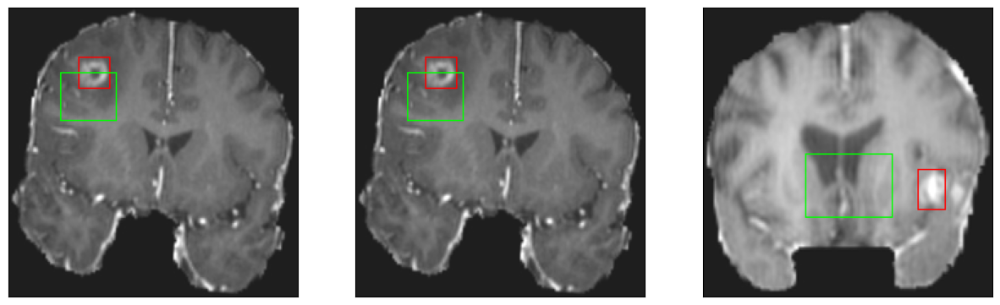

26/26 [==============================] - 8s 308ms/step - loss: 5.4735 - IoU: 0.5868 - val_loss: 9.4230 - val_IoU: 0.4837
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.2226 - IoU: 0.6007
Epoch 186: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


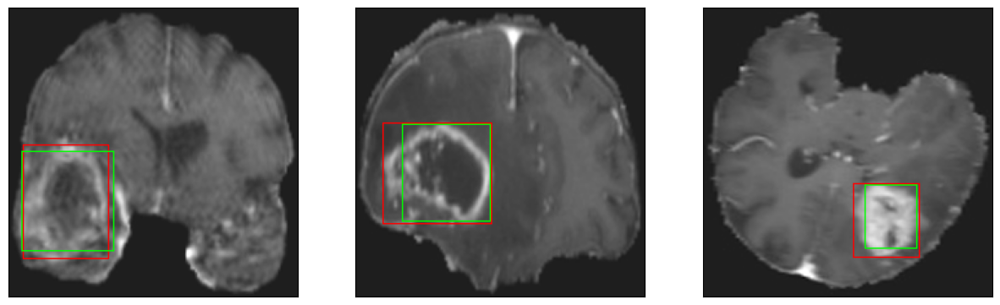

26/26 [==============================] - 8s 308ms/step - loss: 5.2226 - IoU: 0.6007 - val_loss: 7.5890 - val_IoU: 0.5702
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.2976 - IoU: 0.5973
Epoch 187: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


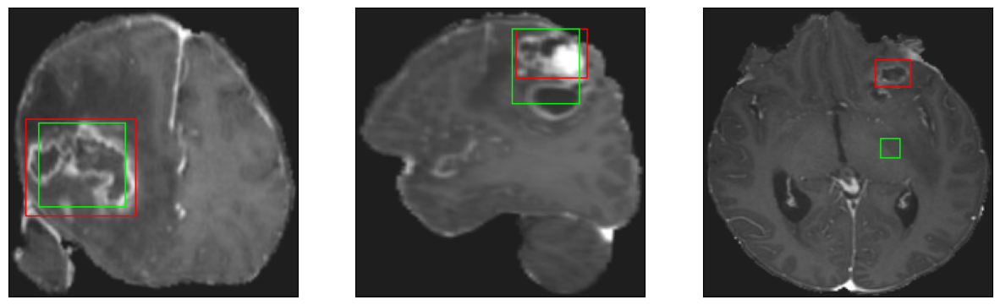

26/26 [==============================] - 8s 298ms/step - loss: 5.2976 - IoU: 0.5973 - val_loss: 7.7550 - val_IoU: 0.5549
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.4245 - IoU: 0.5843
Epoch 188: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


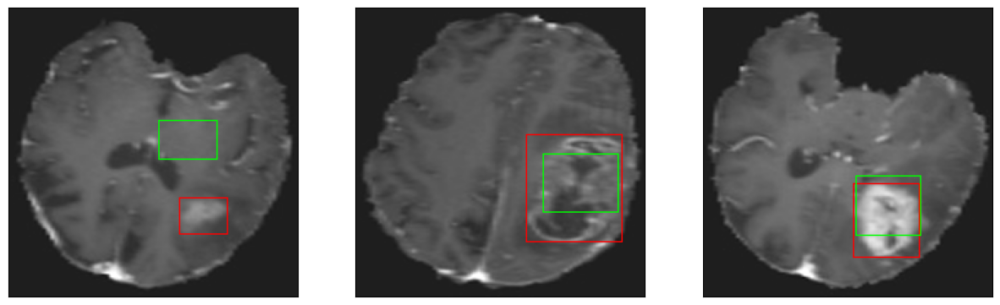

26/26 [==============================] - 8s 312ms/step - loss: 5.4245 - IoU: 0.5843 - val_loss: 8.9227 - val_IoU: 0.5050
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.2801 - IoU: 0.6031
Epoch 189: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


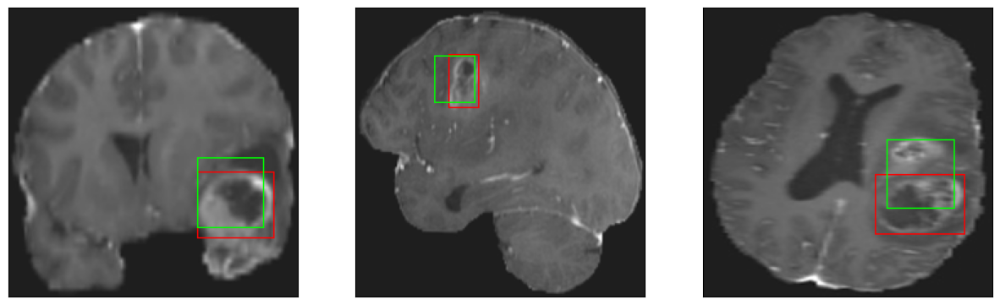

26/26 [==============================] - 8s 291ms/step - loss: 5.2801 - IoU: 0.6031 - val_loss: 7.7728 - val_IoU: 0.5728
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.3427 - IoU: 0.5952
Epoch 190: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


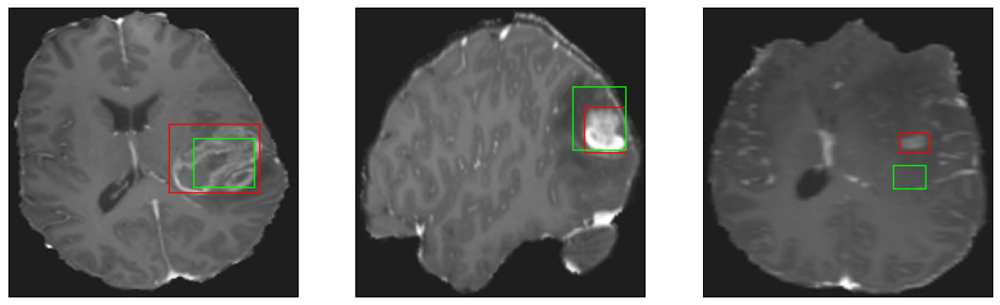

26/26 [==============================] - 8s 305ms/step - loss: 5.3427 - IoU: 0.5952 - val_loss: 8.2549 - val_IoU: 0.5210
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.3480 - IoU: 0.6038
Epoch 191: val_loss did not improve from 7.31201
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


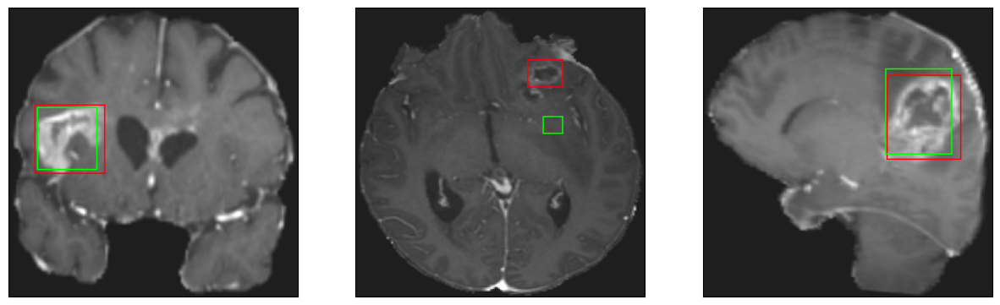

26/26 [==============================] - 8s 316ms/step - loss: 5.3480 - IoU: 0.6038 - val_loss: 8.3281 - val_IoU: 0.5016
Epoch 192/200
10/26 [==========>...................] - ETA: 3s - loss: 5.1342 - IoU: 0.6005

In [24]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [1]:
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5')

NameError: ignored

In [ ]:
model.evaluate(test_dataset)